In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import LinearSegmentedColormap
from PIL import Image
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from tqdm import tqdm
import glob
import os
import seaborn as sns
import scipy
import glob
import sklearn 
from tqdm import tqdm
from sklearn.metrics import pairwise_distances
from sklearn.cluster import AffinityPropagation
from sklearn.decomposition import PCA
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import fcluster, linkage

In [2]:
# Data for the first round of clustering
folder_name_1 = 'AE_LSPs'
file_name_1 = '18_Latent_Space'

# Location to save and load data for round 2 of clustering
folder_name_2 = 'AE_LSPs'
file_name_2 = '15_Latent_Space'

# Location of differently trained AE's for round 2 of clustering
# folder_name_3 = ''
# folder_name_4 = ''
# folder_name_5 = ''

## Clustering

In [3]:
# read in and plot the original data set
latent = pd.read_pickle(f'{folder_name_1}/{file_name_1}')
latent = latent.replace({'trajectory-0.0': '0', 'trajectory-1.0': '1'}).infer_objects()

In [4]:
# Set the 'index' column as the new index
latent.set_index('index', inplace=True)

# Remove the name of the new index
latent.index.name = None

In [5]:
print(latent)

              x         y  z
11480 -6.006512 -1.403181  0
69241 -6.504194 -1.356988  1
23321 -4.791996 -1.597018  0
79963 -1.187429  0.133460  1
53139 -6.308680 -1.709647  1
...         ...       ... ..
54086 -5.719546 -1.554869  1
58314 -4.158640 -1.155109  1
16642 -2.642551 -2.970685  0
10766 -5.320095 -1.811621  0
11205 -5.882836 -1.390398  0

[16000 rows x 3 columns]


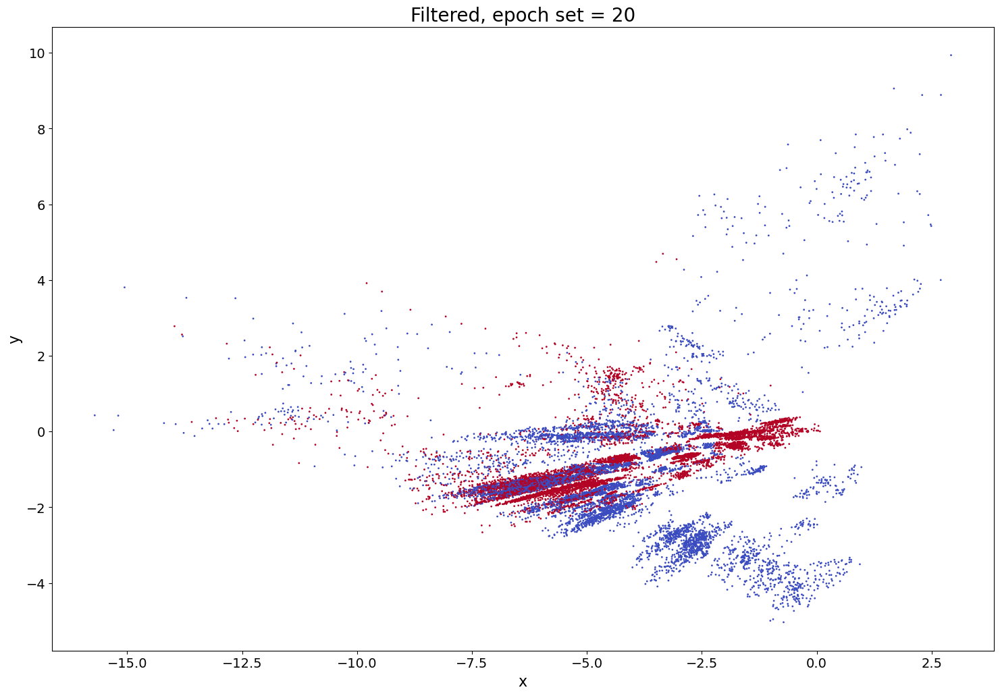

In [6]:
latent['z'] = pd.to_numeric(latent['z'], errors='coerce')

plt.figure(figsize=(18,12))
plt.scatter (latent.x,latent.y, c=latent.z, cmap="coolwarm", s = 1, alpha=1)
plt.title('Filtered, epoch set = 20', fontsize = 20)
plt.xlabel('x', fontsize = 16)
plt.ylabel('y', fontsize=16)
plt.xticks(fontsize = 14)
plt.yticks(fontsize=14)
# plt.savefig("56_data.png", dpi = 300)

plt.show()

In [7]:
# remove the trajectory identity column for further processing
latent_n = latent.drop(['z'], axis = 1)

# Custering Round 2

In [8]:
# read in and plot the original data set
latent_2 = pd.read_pickle(f'{folder_name_2}/{file_name_2}')
latent_2 = latent_2.replace({'trajectory-0.0': '0', 'trajectory-1.0': '1'}).infer_objects()

In [9]:
# Set the 'index' column as the new index
latent_2.set_index('index', inplace=True)

# Remove the name of the new index
latent_2.index.name = None

In [10]:
print(latent_2)

              x         y  z
11480  1.446992 -6.491708  0
69241  1.707820 -7.031367  1
23321  0.801597 -2.717845  0
79963  0.024564 -0.628033  1
53139  2.192821 -6.720490  1
...         ...       ... ..
54086  1.960116 -6.019783  1
58314  1.249028 -4.111668  1
16642 -0.050419 -5.292699  0
10766  1.671446 -5.840354  0
11205  1.509760 -6.149549  0

[16000 rows x 3 columns]


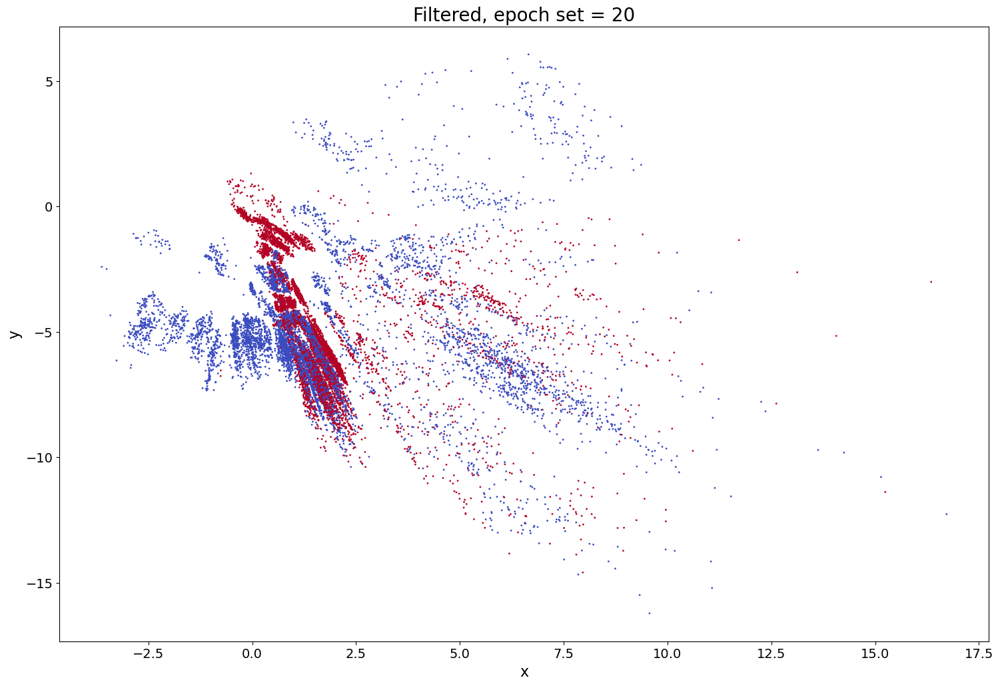

In [11]:
latent_2['z'] = pd.to_numeric(latent_2['z'], errors='coerce')

plt.figure(figsize=(18,12))
plt.scatter (latent_2.x,latent_2.y, c=latent_2.z, cmap="coolwarm", s = 1, alpha=1)
plt.title('Filtered, epoch set = 20', fontsize = 20)
plt.xlabel('x', fontsize = 16)
plt.ylabel('y', fontsize=16)
plt.xticks(fontsize = 14)
plt.yticks(fontsize=14)
# plt.savefig("56_data.png", dpi = 300)

plt.show()

In [12]:
# remove the trajectory identity column for further processing
latent_2n = latent_2.drop(['z'], axis = 1)

# Consistent Index Extraction:

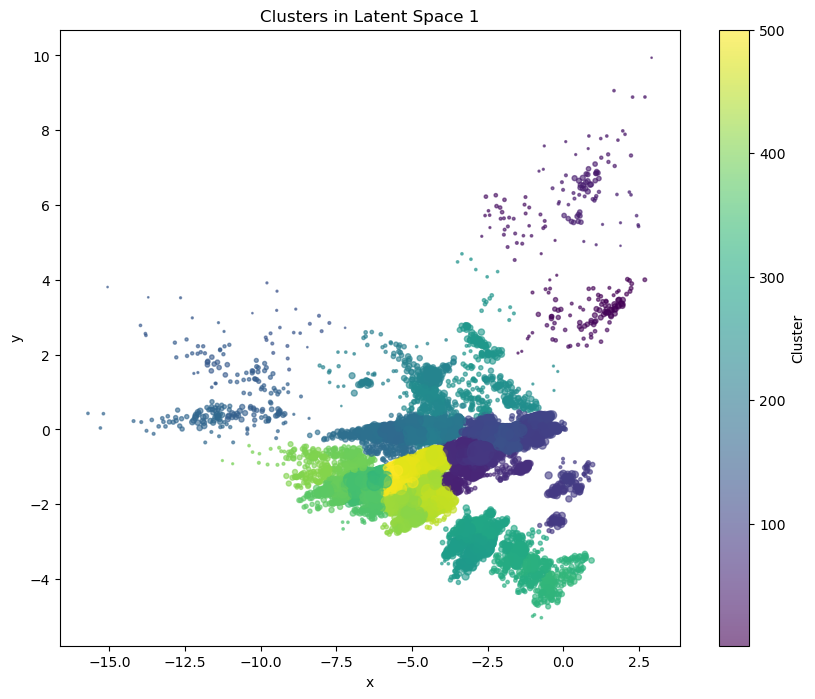

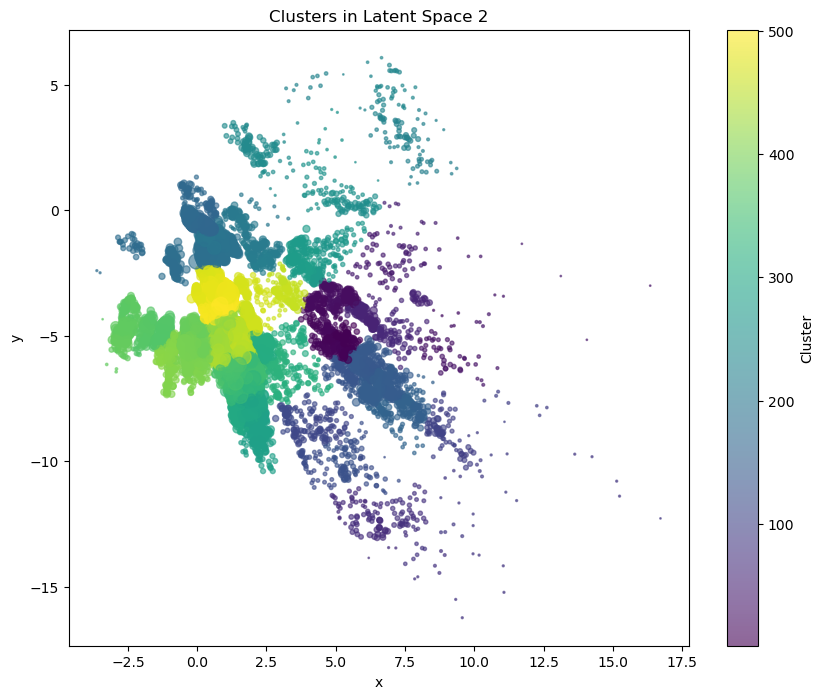

In [13]:
# Extract the x and y coordinates for clustering
latent_coords = latent[['x', 'y']].values
latent_2_coords = latent_2[['x', 'y']].values

# Normalize the data
scaler = StandardScaler()
latent_coords_scaled = scaler.fit_transform(latent_coords)
latent_2_coords_scaled = scaler.fit_transform(latent_2_coords)

# Perform agglomerative clustering on both latent spaces
linkage_matrix1 = linkage(latent_coords_scaled, method='ward')
linkage_matrix2 = linkage(latent_2_coords_scaled, method='ward')

# Choose a threshold distance for forming flat clusters
threshold = 0.5  # Adjust based on your data distribution

# Form flat clusters based on the threshold
clusters1 = fcluster(linkage_matrix1, t=threshold, criterion='distance')
clusters2 = fcluster(linkage_matrix2, t=threshold, criterion='distance')

# Combine the cluster assignments from both latent spaces
combined_clusters = np.vstack((clusters1, clusters2)).T

# Find consensus clusters
consensus_clusters = {}
for i, (c1, c2) in enumerate(combined_clusters):
    if (c1, c2) not in consensus_clusters:
        consensus_clusters[(c1, c2)] = []
    consensus_clusters[(c1, c2)].append(int(latent.iloc[i, 0]))  # Capture indices correctly

# Filter out singleton clusters (clusters with only one member)
consensus_clusters = {k: v for k, v in consensus_clusters.items() if len(v) > 10}

# Calculate cluster sizes for plotting
cluster_sizes = {k: len(v) for k, v in consensus_clusters.items()}

# Visualization function
def plot_clusters(latent, clusters, cluster_sizes, title):
    cluster_count = pd.Series(clusters).value_counts()
    sizes = cluster_count.loc[clusters].values
    
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(latent['x'], latent['y'], c=clusters, s=sizes, cmap='viridis', marker='o', alpha=0.6)
    plt.title(title)
    plt.xlabel('x')
    plt.ylabel('y')
    plt.colorbar(scatter, label='Cluster')
    plt.show()

# Add cluster labels to the DataFrames for plotting
latent['cluster'] = clusters1
latent_2['cluster'] = clusters2

# Plot clusters in each latent space
plot_clusters(latent, latent['cluster'], cluster_sizes, 'Clusters in Latent Space 1')
plot_clusters(latent_2, latent_2['cluster'], cluster_sizes, 'Clusters in Latent Space 2')

In [14]:
# Group the DataFrame by 'cluster' and print the indices sorted by the cluster
clustered_indices = latent.groupby('cluster').apply(lambda df: df.index.tolist())

# Print the indices sorted by the cluster
for cluster_id, indices in clustered_indices.items():
    print(f"Cluster {cluster_id}: {indices}")


Cluster 1: [34172, 34195, 34222, 34241]
Cluster 2: [34044, 34067, 34046, 34074, 34176, 34187, 34076]
Cluster 3: [34188, 34313, 34322, 34303, 34226, 34284]
Cluster 4: [34060, 34218, 34064, 34007, 34005, 34232, 34018, 34016, 33996, 34159, 34162, 34021, 34086, 34158]
Cluster 5: [34238, 34164, 34180, 34236, 34182, 34177, 34033]
Cluster 6: [34199, 34206, 33991, 34013, 34029, 34149, 34156, 34248, 34147, 34160, 34144, 34154]
Cluster 7: [32999, 32977]
Cluster 8: [32940, 32972, 32937, 32988]
Cluster 9: [34305, 34333, 34211, 34291]
Cluster 10: [32935, 33014, 34337, 34347, 34343, 34354, 34348, 34335, 34351]
Cluster 11: [34151, 34250, 33982, 34145, 34273, 34038, 34279, 34270, 34265, 34122]
Cluster 12: [34130, 34025, 34011, 34121, 34102, 34012]
Cluster 13: [33096, 33093]
Cluster 14: [34368, 34364, 32948]
Cluster 15: [34133, 34010, 34132, 34254, 34136]
Cluster 16: [33015, 33956, 33985, 33960, 34366, 33972]
Cluster 17: [33718, 33717, 33721, 33711]
Cluster 18: [33378, 33379, 33362]
Cluster 19: [33373,

/tmp/ipykernel_54638/1242897006.py:2: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  clustered_indices = latent.groupby('cluster').apply(lambda df: df.index.tolist())


In [15]:
# Group the DataFrame by 'cluster' and count the number of indices in each cluster
cluster_counts = latent['cluster'].value_counts().sort_values()

# Print the clusters and their counts sorted by the number of indices in ascending order
for cluster_id, count in cluster_counts.items():
    print(f"Cluster {cluster_id}: {count}")


Cluster 137: 1
Cluster 135: 1
Cluster 136: 1
Cluster 220: 1
Cluster 28: 1
Cluster 46: 1
Cluster 131: 1
Cluster 129: 1
Cluster 20: 2
Cluster 7: 2
Cluster 145: 2
Cluster 13: 2
Cluster 31: 2
Cluster 24: 2
Cluster 33: 2
Cluster 141: 2
Cluster 139: 2
Cluster 128: 2
Cluster 243: 2
Cluster 127: 2
Cluster 396: 2
Cluster 45: 2
Cluster 157: 2
Cluster 242: 2
Cluster 34: 2
Cluster 41: 2
Cluster 142: 3
Cluster 258: 3
Cluster 32: 3
Cluster 134: 3
Cluster 221: 3
Cluster 18: 3
Cluster 160: 3
Cluster 38: 3
Cluster 43: 3
Cluster 27: 3
Cluster 44: 3
Cluster 271: 3
Cluster 138: 3
Cluster 30: 3
Cluster 323: 3
Cluster 14: 3
Cluster 219: 3
Cluster 21: 3
Cluster 224: 3
Cluster 259: 3
Cluster 358: 3
Cluster 397: 3
Cluster 9: 4
Cluster 218: 4
Cluster 25: 4
Cluster 398: 4
Cluster 88: 4
Cluster 26: 4
Cluster 130: 4
Cluster 132: 4
Cluster 1: 4
Cluster 162: 4
Cluster 37: 4
Cluster 159: 4
Cluster 152: 4
Cluster 359: 4
Cluster 22: 4
Cluster 133: 4
Cluster 35: 4
Cluster 399: 4
Cluster 217: 4
Cluster 260: 4
Cluster 17:

In [16]:
print(latent)

              x         y  z  cluster
11480 -6.006512 -1.403181  0      343
69241 -6.504194 -1.356988  1      357
23321 -4.791996 -1.597018  0      436
79963 -1.187429  0.133460  1      103
53139 -6.308680 -1.709647  1      364
...         ...       ... ..      ...
54086 -5.719546 -1.554869  1      491
58314 -4.158640 -1.155109  1      431
16642 -2.642551 -2.970685  0      282
10766 -5.320095 -1.811621  0      425
11205 -5.882836 -1.390398  0      342

[16000 rows x 4 columns]


# Overlaying Cluster Conformations

In [17]:
import MDAnalysis as mda
from MDAnalysis.analysis import align
import numpy as np
from itertools import combinations
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from tqdm import tqdm

# Load the topology and trajectory files for both MD simulations
u1 = mda.Universe("myc_091-160_stripped.prmtop", "aMD_091-160_no1-4_stripped.nc")
u2 = mda.Universe("myc_091-160_D132-H_stripped.prmtop", "aMD_091-160_D132-H_no1-4_stripped.nc")

/tmp/ipykernel_54638/3896440621.py:72: DeprecationWarning: DataFrameGroupBy.apply operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  cluster_indices = latent.groupby('cluster').apply(lambda df: df.index.tolist()).to_dict()
Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 109.06it/s]


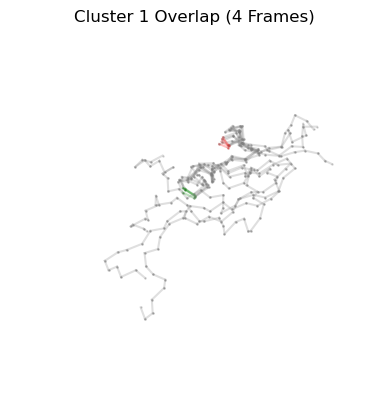

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 178.02it/s]


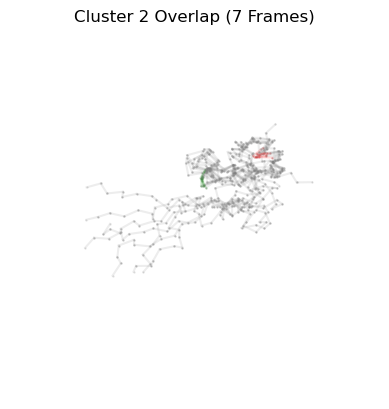

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 132.37it/s]


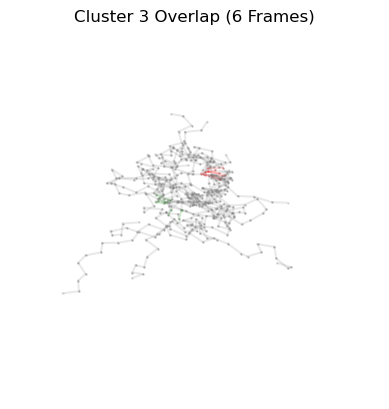

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 175.36it/s]


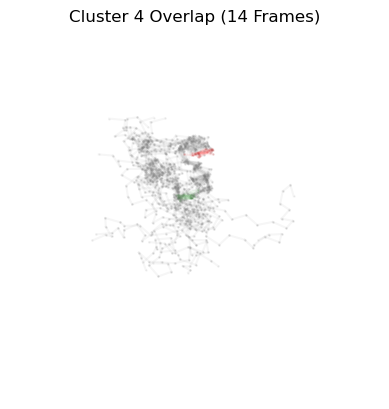

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 146.09it/s]


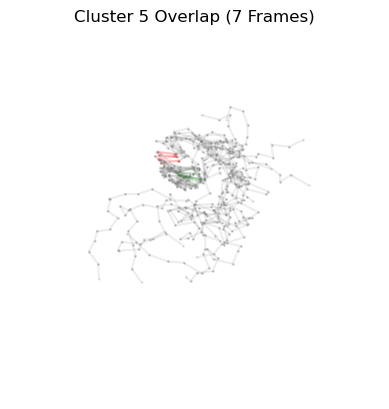

Aligning frames: 100%|██████████████████████████| 12/12 [00:00<00:00, 28.42it/s]


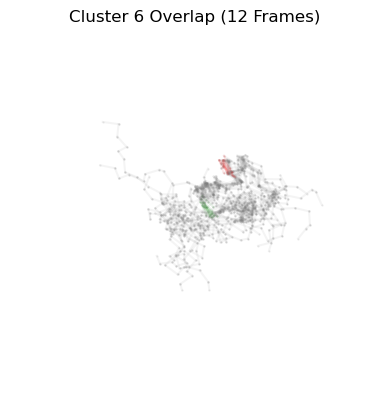

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 150.61it/s]


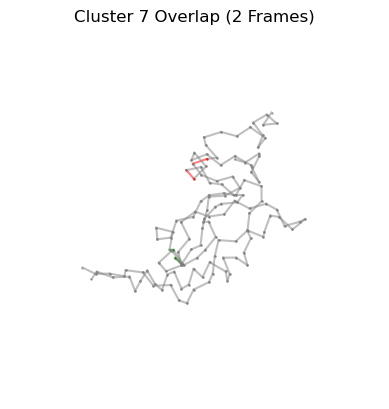

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 129.00it/s]


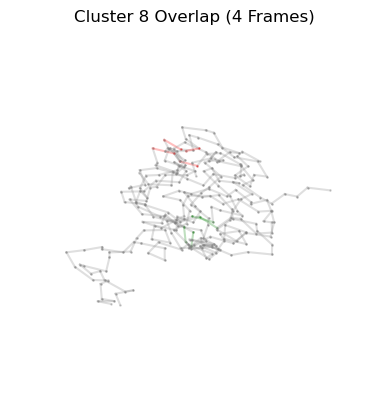

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 153.32it/s]


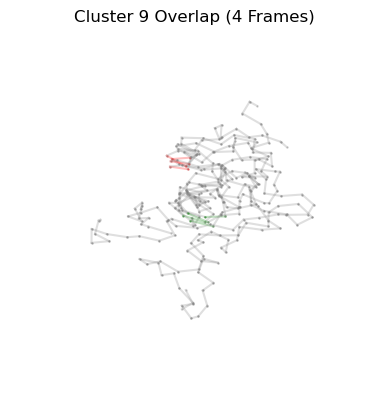

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 123.89it/s]


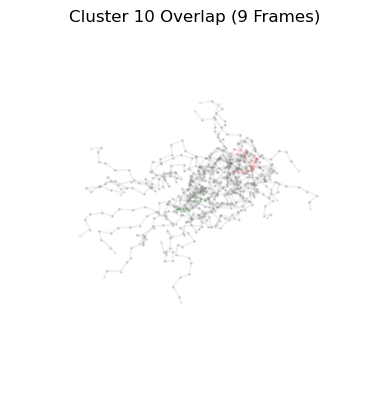

Aligning frames: 100%|██████████████████████████| 10/10 [00:00<00:00, 97.12it/s]


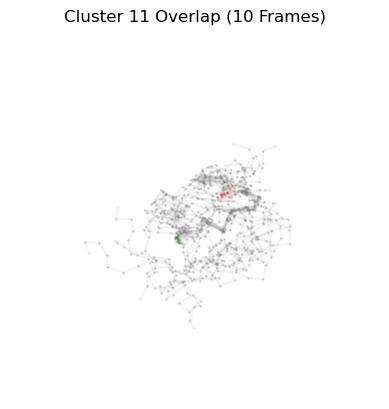

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 143.88it/s]


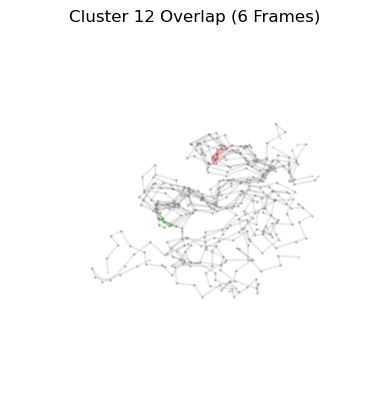

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 135.66it/s]


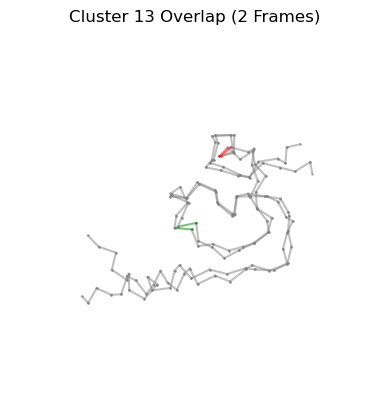

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 129.23it/s]


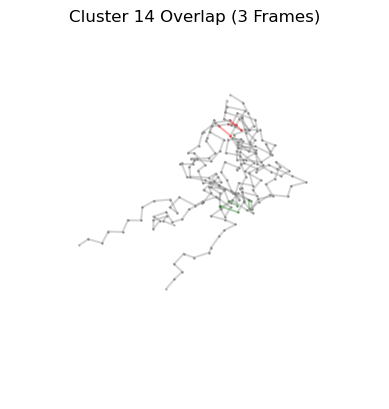

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 171.98it/s]


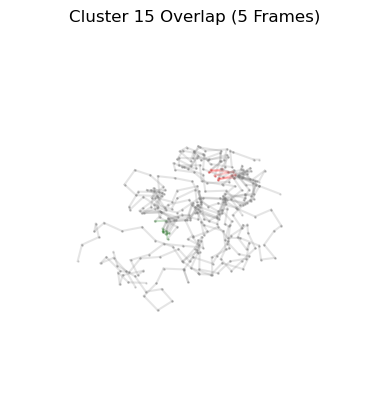

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 129.97it/s]


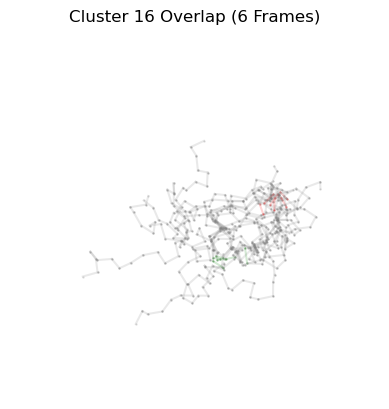

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 154.72it/s]


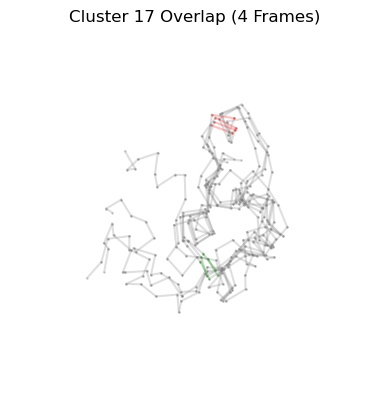

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 149.80it/s]


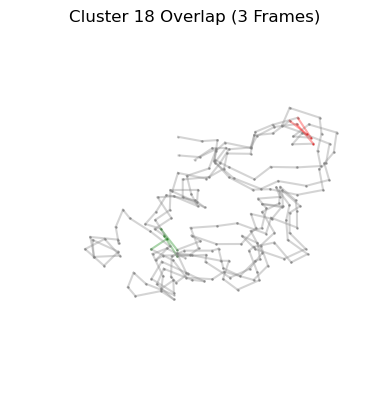

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 139.74it/s]


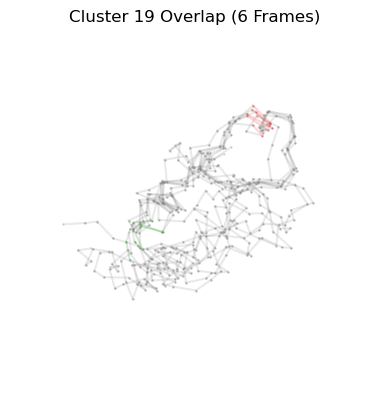

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 122.07it/s]


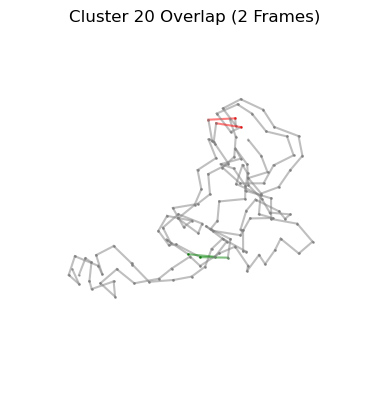

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 100.32it/s]


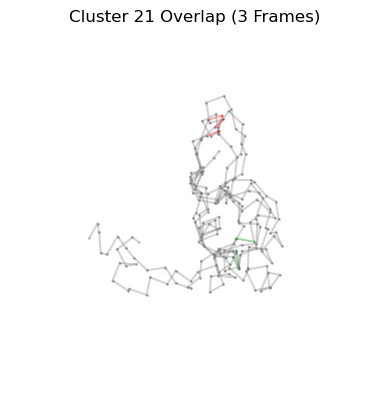

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 134.43it/s]


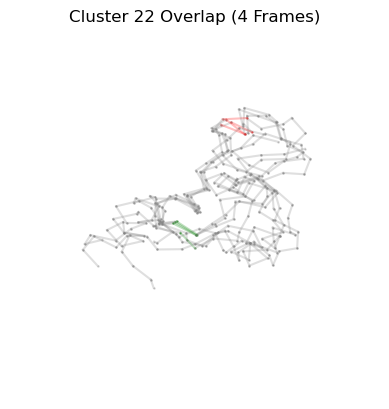

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 140.16it/s]


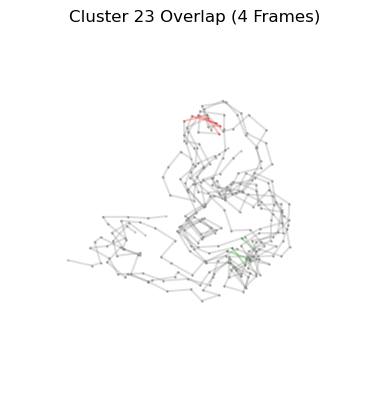

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 152.31it/s]


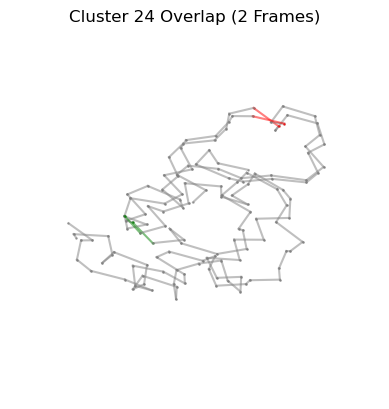

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 138.34it/s]


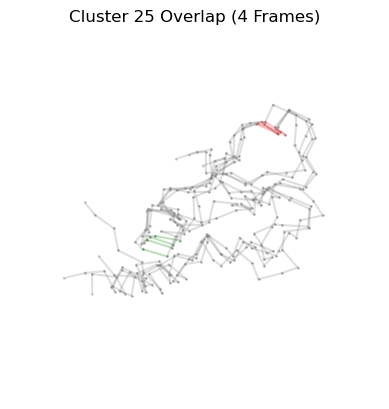

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 140.29it/s]


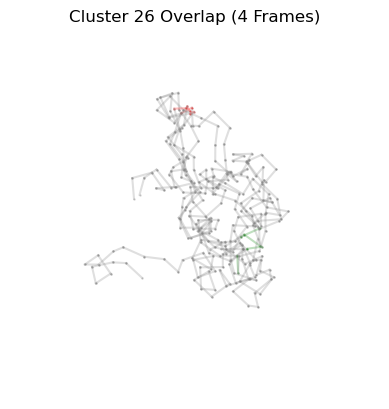

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 159.70it/s]


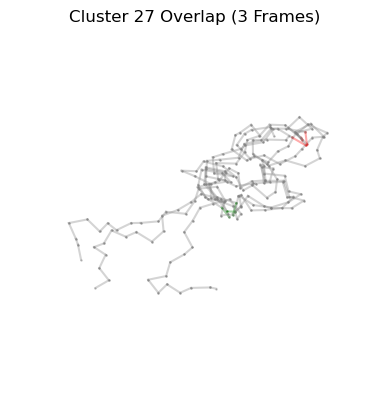

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 171.37it/s]


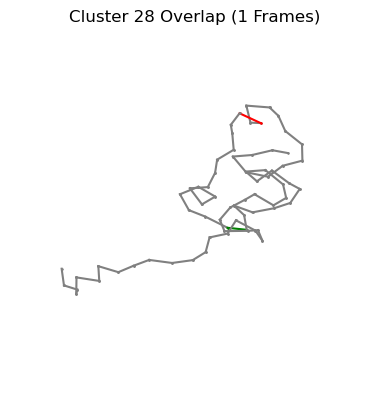

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 125.09it/s]


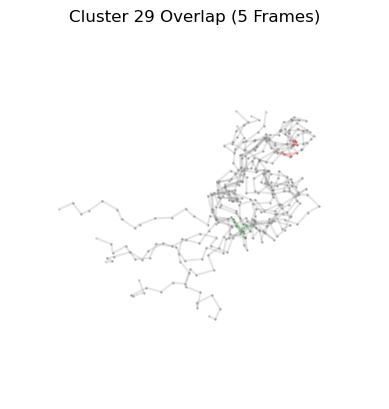

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 156.01it/s]


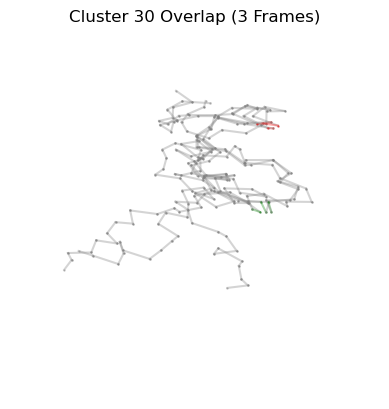

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 121.85it/s]


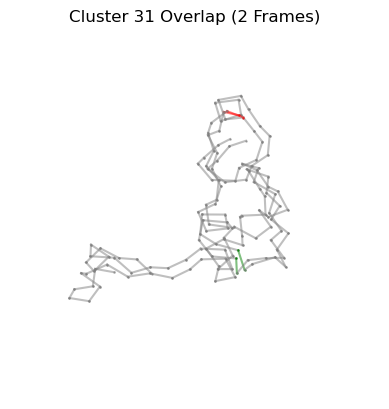

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 137.25it/s]


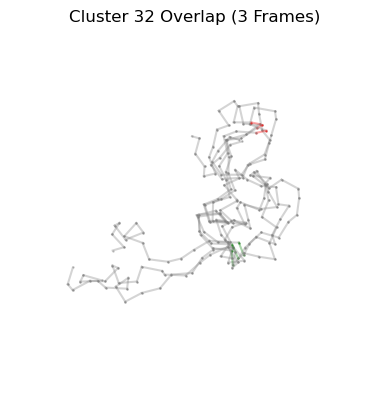

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 187.31it/s]


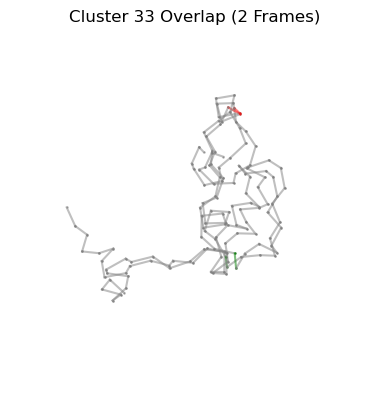

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 116.95it/s]


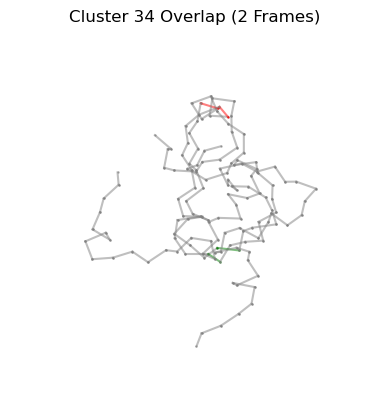

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 133.81it/s]


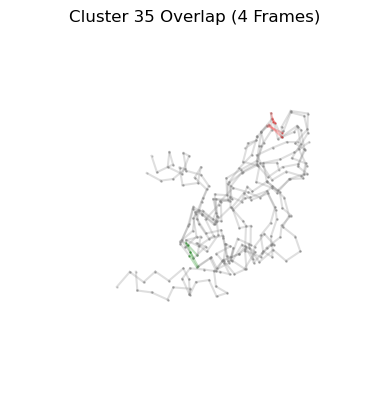

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 151.22it/s]


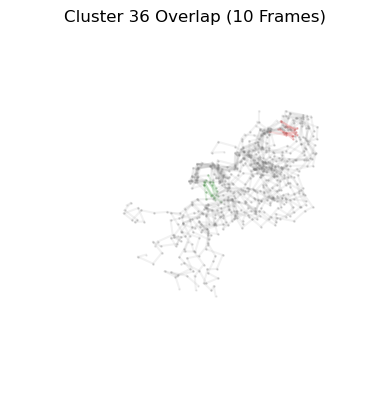

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 140.79it/s]


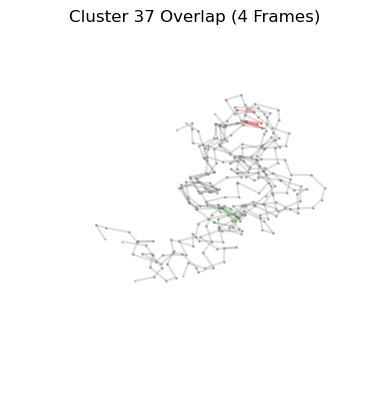

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 159.69it/s]


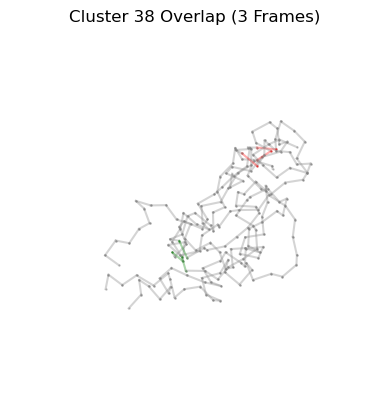

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 149.52it/s]


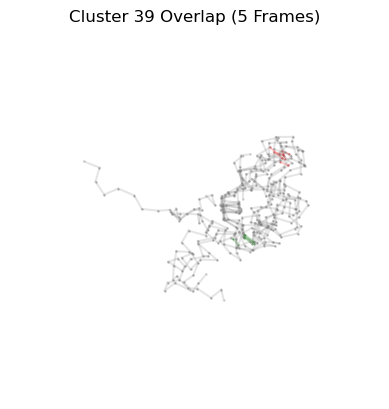

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 165.63it/s]


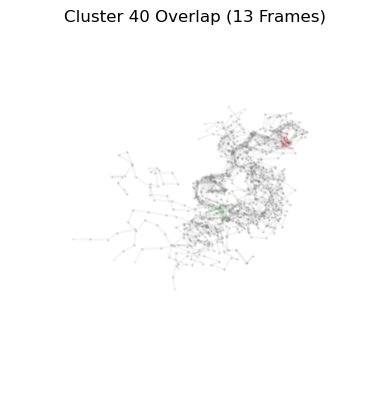

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 146.98it/s]


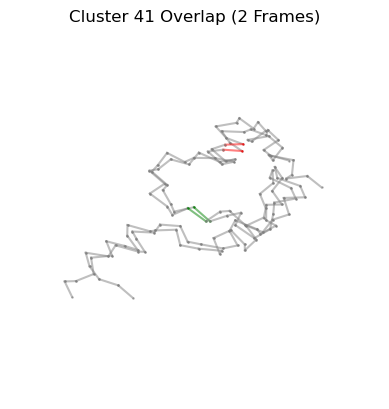

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 140.81it/s]


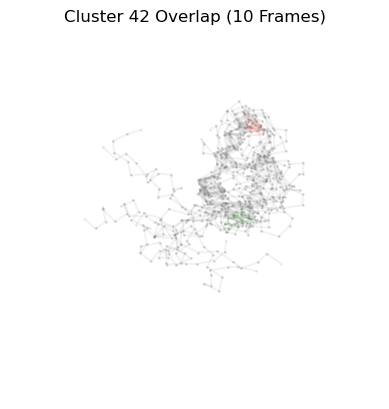

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 143.13it/s]


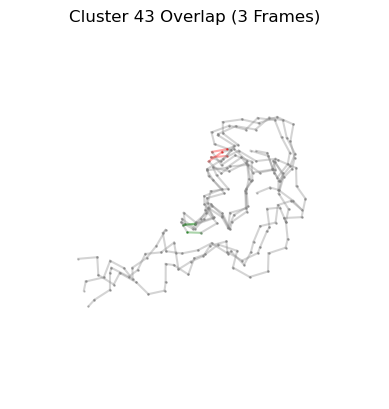

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 155.96it/s]


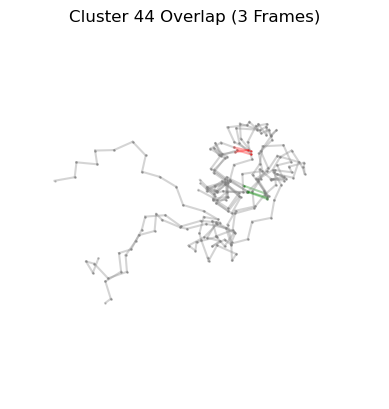

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 128.22it/s]


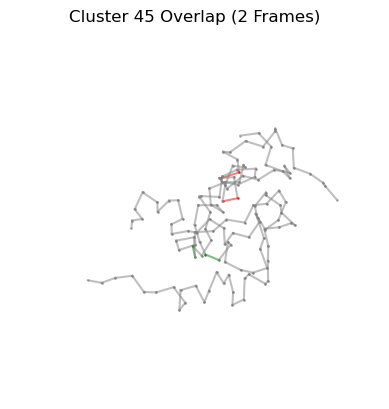

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 138.53it/s]


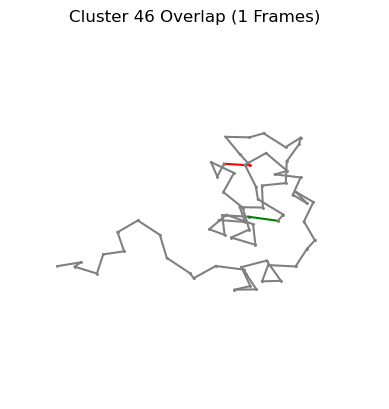

Aligning frames: 100%|█████████████████████████| 36/36 [00:00<00:00, 182.65it/s]


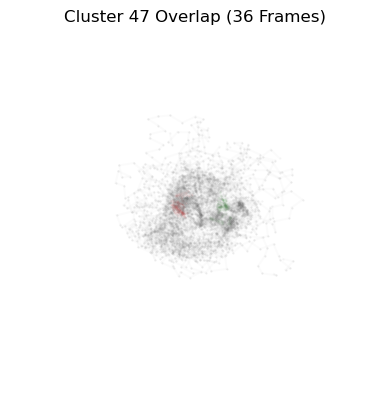

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 156.70it/s]


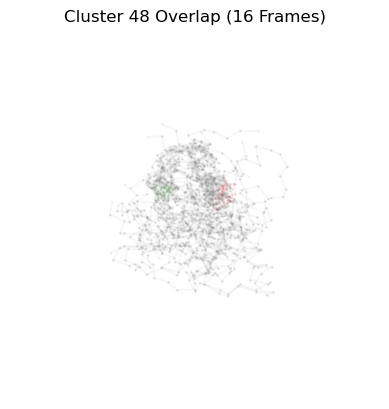

Aligning frames: 100%|█████████████████████████| 41/41 [00:00<00:00, 192.29it/s]


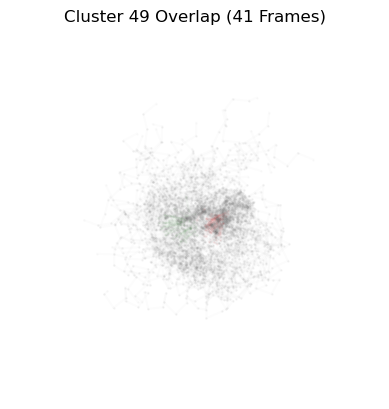

Aligning frames: 100%|██████████████████████████| 13/13 [00:00<00:00, 35.86it/s]


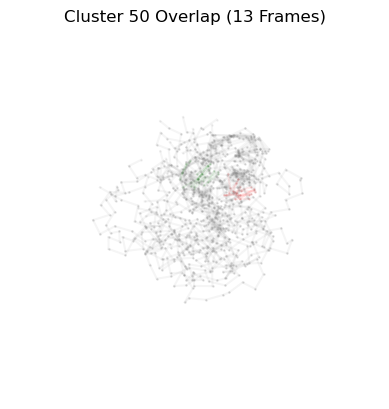

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 147.04it/s]


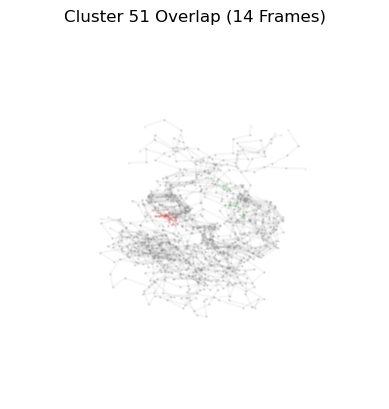

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 128.48it/s]


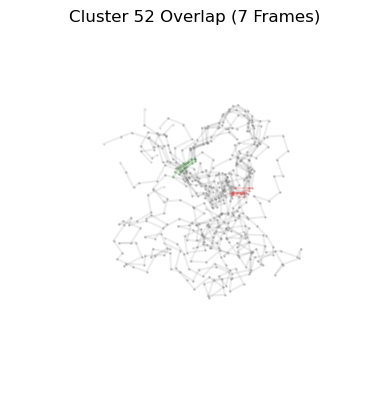

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 140.51it/s]


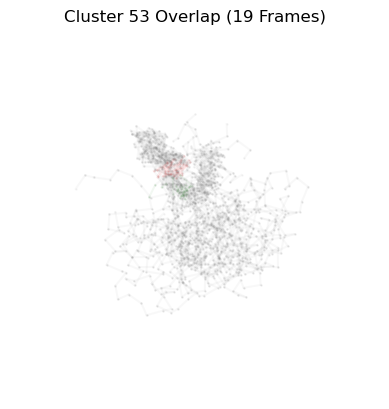

Aligning frames: 100%|█████████████████████████| 56/56 [00:00<00:00, 184.02it/s]


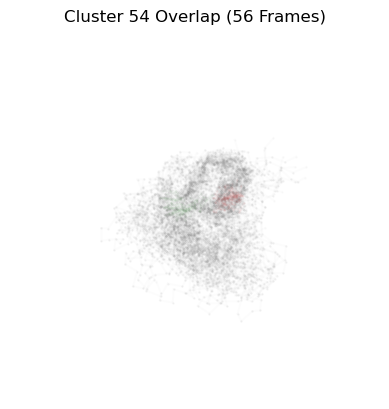

Aligning frames: 100%|█████████████████████████| 55/55 [00:00<00:00, 191.14it/s]


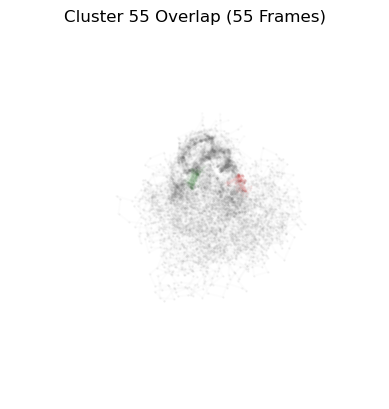

Aligning frames: 100%|████████████████████████████| 5/5 [00:00<00:00, 11.97it/s]


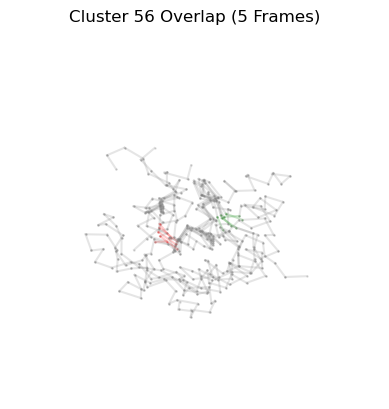

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 172.67it/s]


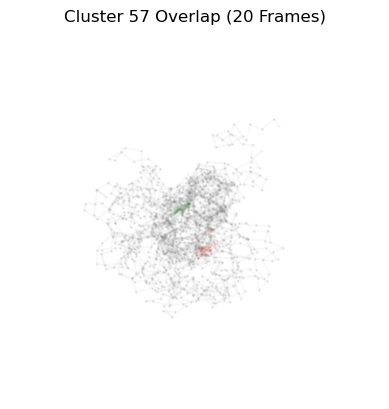

Aligning frames: 100%|███████████████████████| 124/124 [00:00<00:00, 197.57it/s]


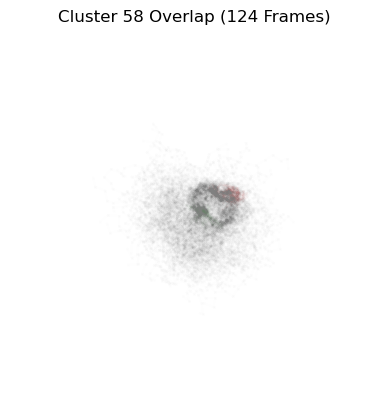

Aligning frames: 100%|██████████████████████████| 66/66 [00:01<00:00, 62.81it/s]


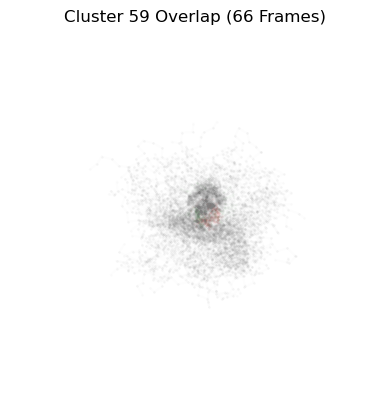

Aligning frames: 100%|█████████████████████████| 56/56 [00:00<00:00, 184.65it/s]


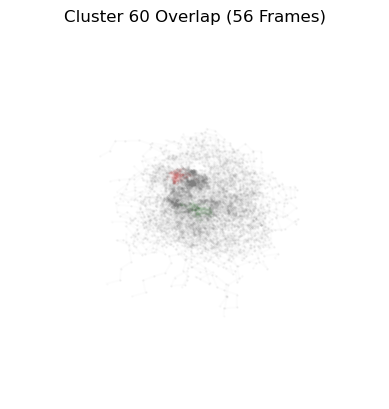

Aligning frames: 100%|█████████████████████████| 44/44 [00:00<00:00, 182.44it/s]


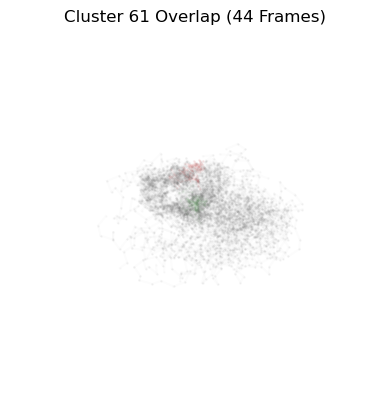

Aligning frames: 100%|██████████████████████████| 62/62 [00:00<00:00, 97.48it/s]


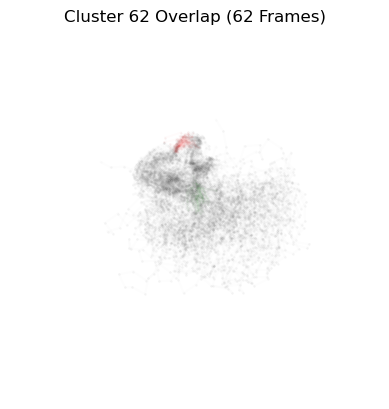

Aligning frames: 100%|█████████████████████████| 71/71 [00:00<00:00, 192.11it/s]


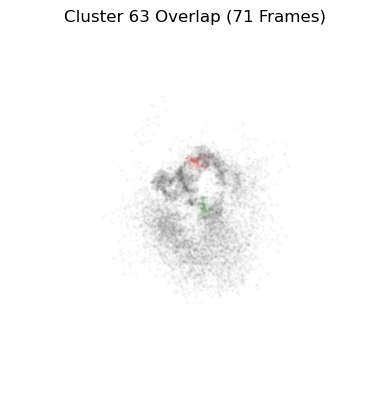

Aligning frames: 100%|███████████████████████| 110/110 [00:00<00:00, 182.57it/s]


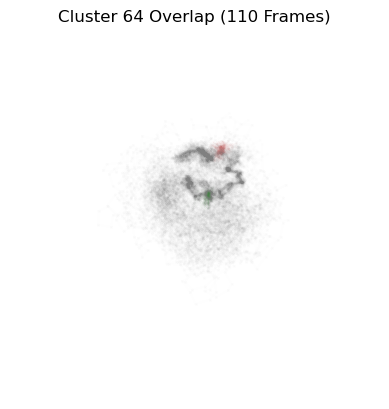

Aligning frames: 100%|██████████████████████████| 70/70 [00:01<00:00, 68.61it/s]


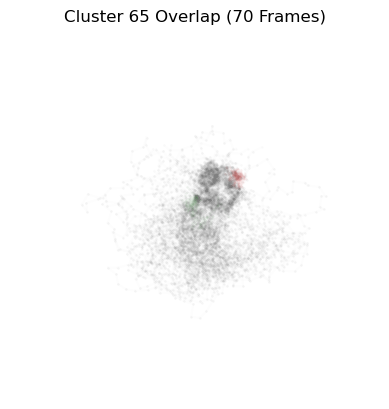

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 114.30it/s]


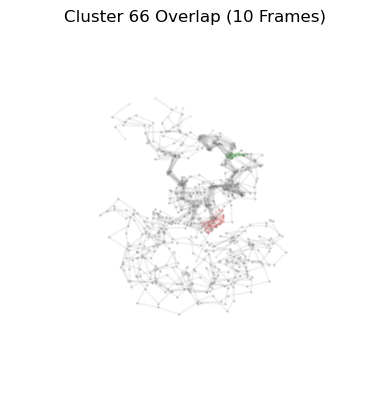

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 149.42it/s]


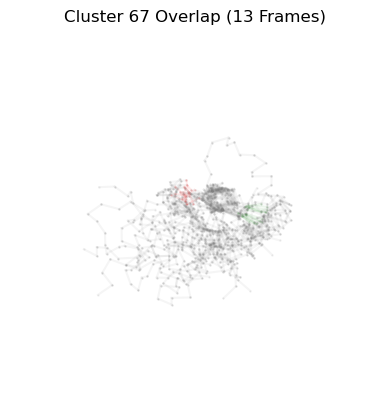

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 162.34it/s]


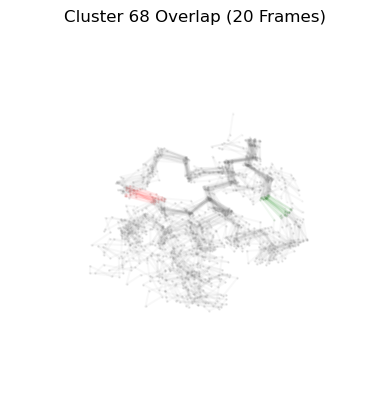

Aligning frames: 100%|█████████████████████████| 31/31 [00:00<00:00, 190.64it/s]


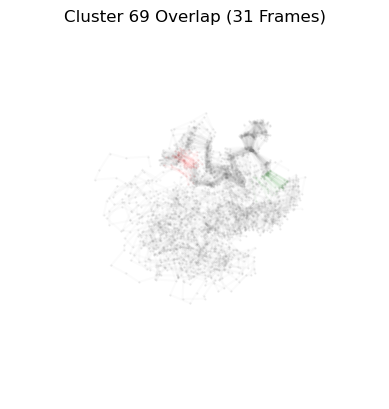

Aligning frames: 100%|█████████████████████████| 36/36 [00:00<00:00, 168.61it/s]


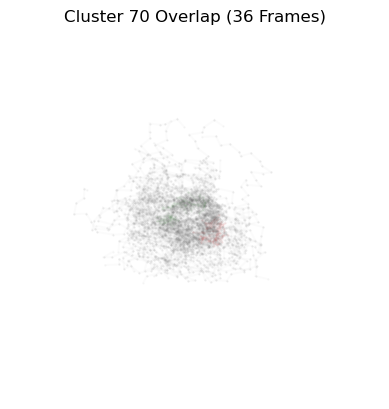

Aligning frames: 100%|██████████████████████████| 18/18 [00:00<00:00, 52.46it/s]


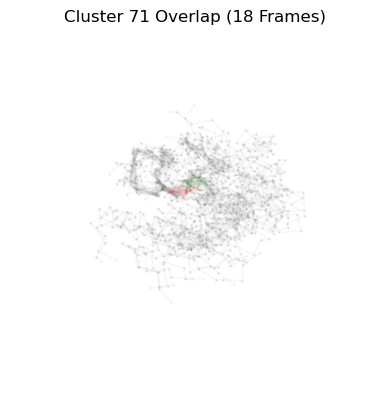

Aligning frames: 100%|█████████████████████████| 27/27 [00:00<00:00, 169.86it/s]


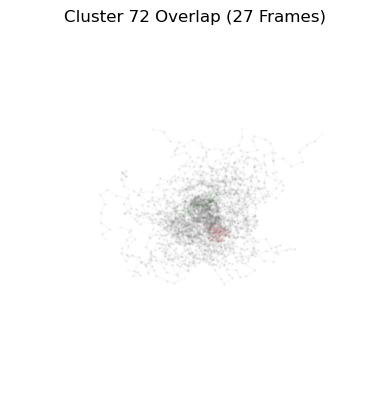

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 144.22it/s]


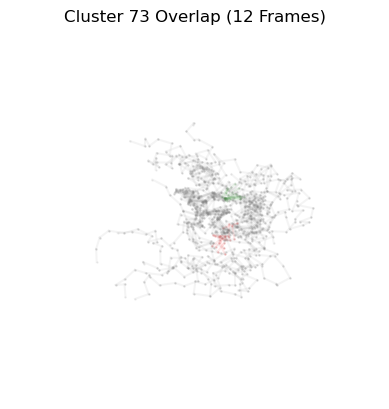

Aligning frames: 100%|█████████████████████████| 17/17 [00:00<00:00, 182.95it/s]


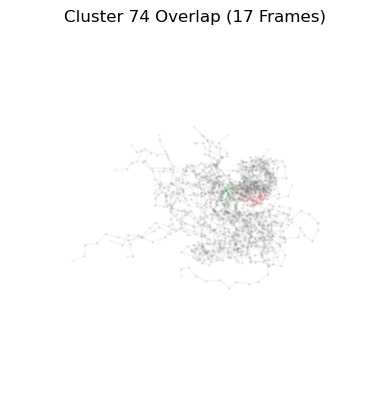

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 140.35it/s]


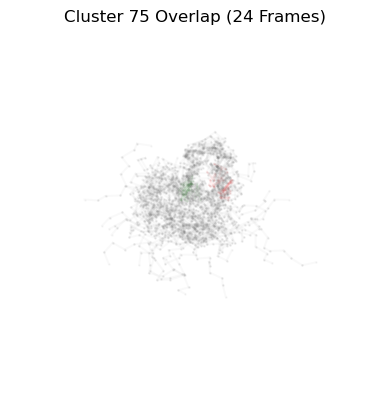

Aligning frames: 100%|███████████████████████| 136/136 [00:00<00:00, 150.74it/s]


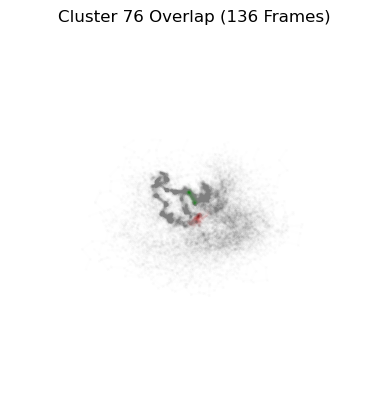

Aligning frames: 100%|█████████████████████████| 25/25 [00:00<00:00, 148.97it/s]


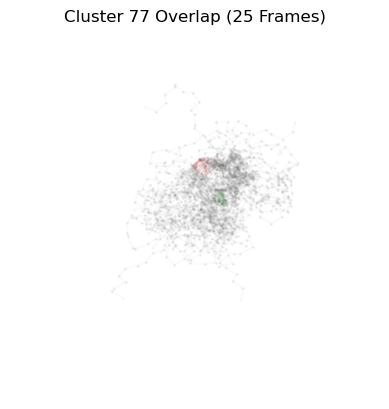

Aligning frames: 100%|█████████████████████████| 54/54 [00:00<00:00, 111.30it/s]


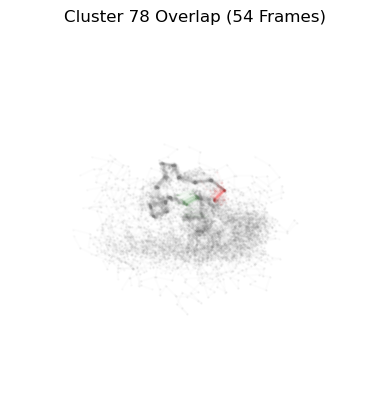

Aligning frames: 100%|███████████████████████| 191/191 [00:01<00:00, 143.35it/s]


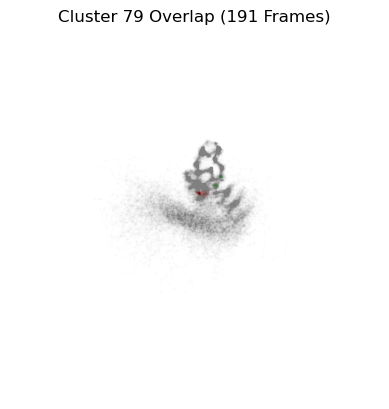

Aligning frames: 100%|████████████████████████| 121/121 [00:01<00:00, 72.71it/s]


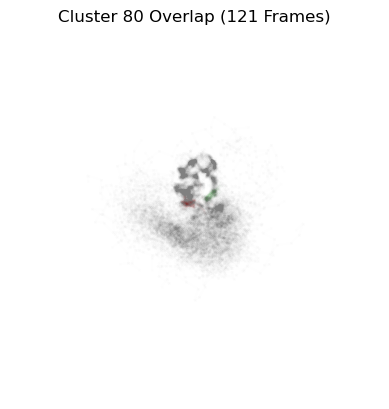

Aligning frames: 100%|███████████████████████| 250/250 [00:01<00:00, 126.92it/s]


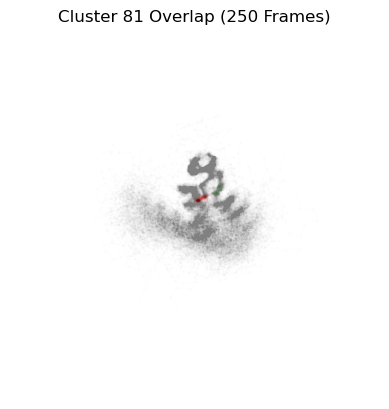

Aligning frames: 100%|████████████████████████████| 8/8 [00:01<00:00,  5.93it/s]


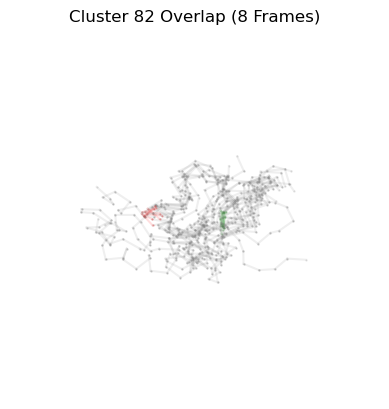

Aligning frames: 100%|█████████████████████████| 23/23 [00:00<00:00, 160.50it/s]


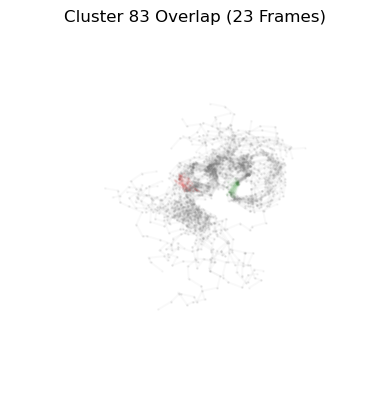

Aligning frames: 100%|██████████████████████████| 25/25 [00:00<00:00, 75.74it/s]


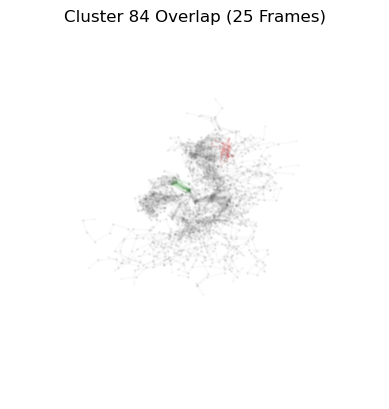

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 138.37it/s]


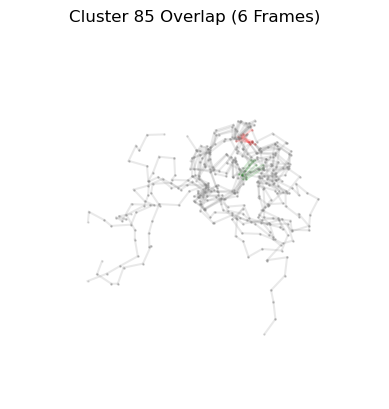

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 149.56it/s]


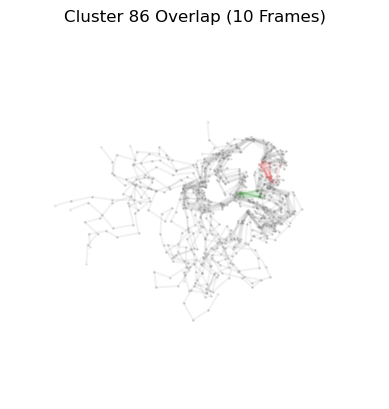

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 165.50it/s]


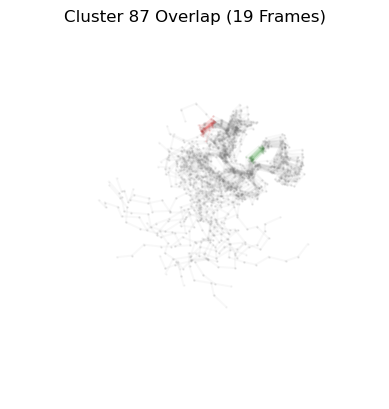

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 108.17it/s]


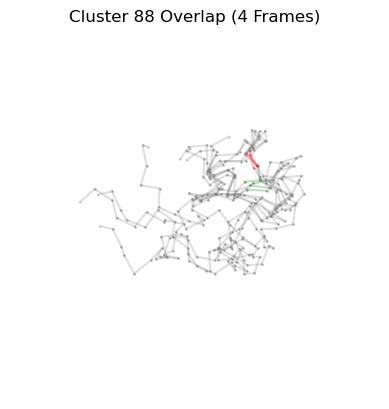

Aligning frames: 100%|██████████████████████████| 25/25 [00:00<00:00, 68.50it/s]


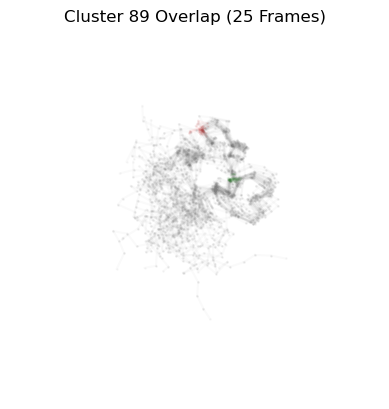

Aligning frames: 100%|█████████████████████████| 25/25 [00:00<00:00, 164.15it/s]


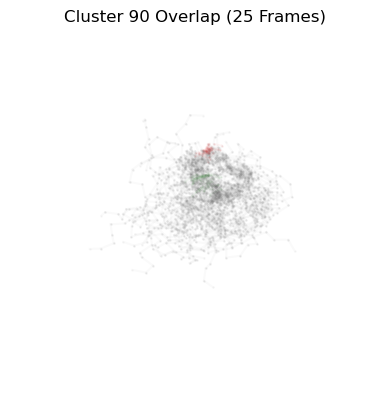

Aligning frames: 100%|█████████████████████████| 74/74 [00:00<00:00, 124.95it/s]


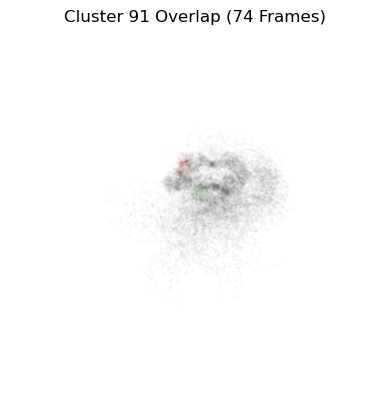

Aligning frames: 100%|█████████████████████████| 28/28 [00:00<00:00, 194.19it/s]


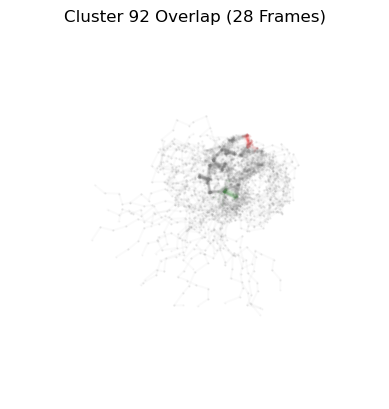

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 201.71it/s]


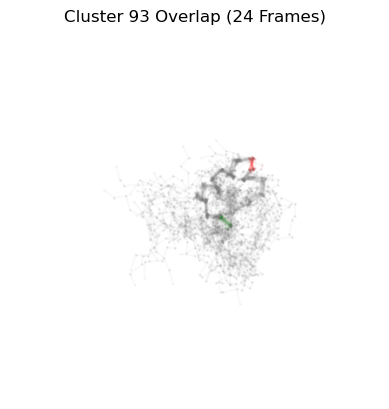

Aligning frames: 100%|█████████████████████████| 96/96 [00:00<00:00, 138.48it/s]


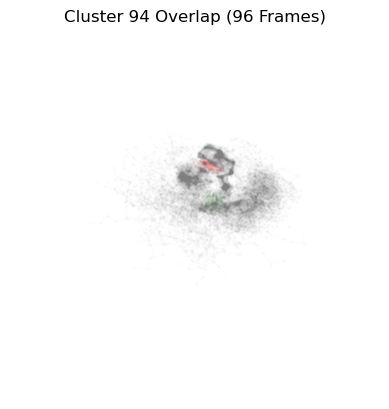

Aligning frames: 100%|█████████████████████████| 33/33 [00:00<00:00, 174.52it/s]


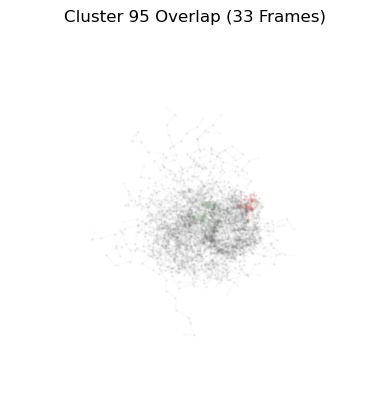

Aligning frames: 100%|█████████████████████████| 44/44 [00:00<00:00, 198.56it/s]


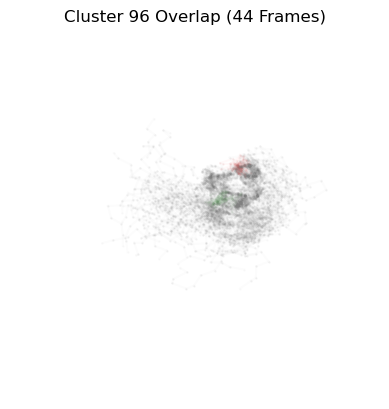

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 177.42it/s]


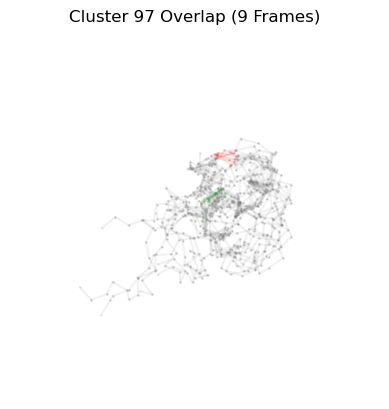

Aligning frames: 100%|█████████████████████████| 40/40 [00:00<00:00, 191.66it/s]


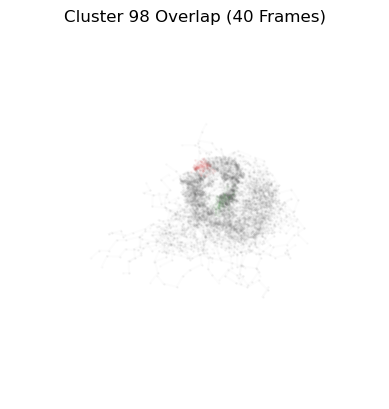

Aligning frames: 100%|██████████████████████████| 39/39 [00:00<00:00, 79.89it/s]


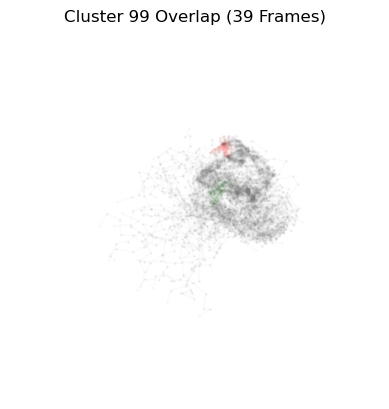

Aligning frames: 100%|█████████████████████████| 72/72 [00:00<00:00, 199.44it/s]


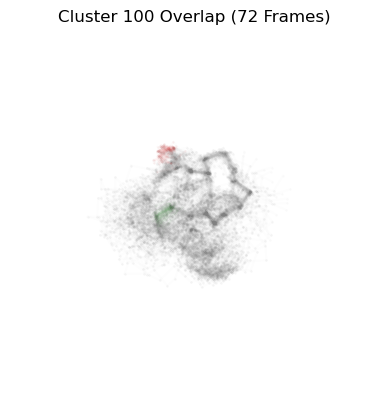

Aligning frames: 100%|█████████████████████████| 41/41 [00:00<00:00, 191.24it/s]


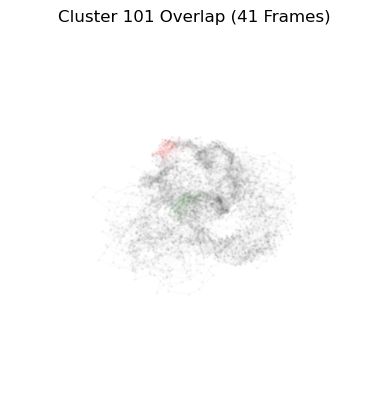

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 173.23it/s]


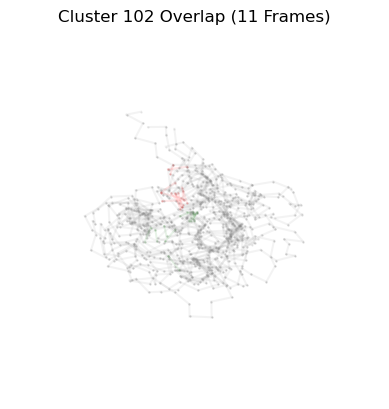

Aligning frames: 100%|█████████████████████████| 81/81 [00:00<00:00, 191.89it/s]


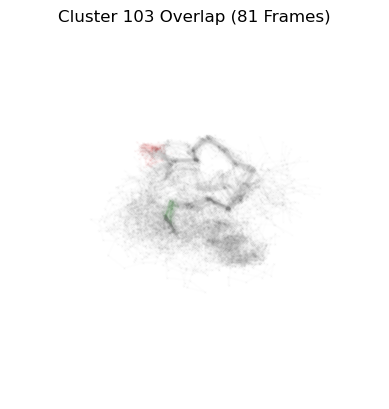

Aligning frames: 100%|█████████████████████████| 22/22 [00:00<00:00, 180.22it/s]


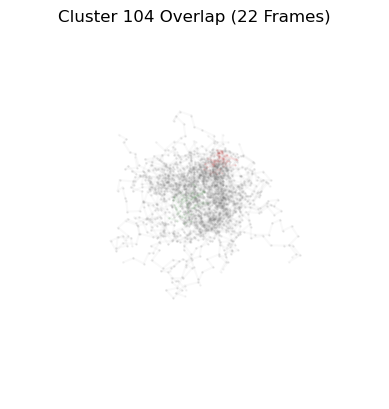

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 166.75it/s]


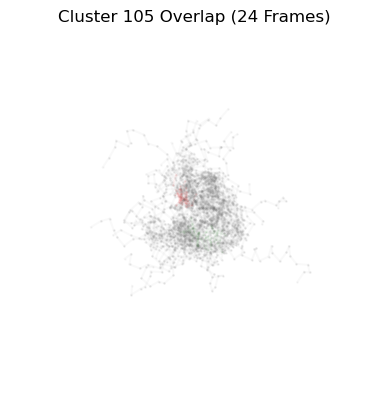

Aligning frames: 100%|█████████████████████████| 22/22 [00:00<00:00, 165.50it/s]


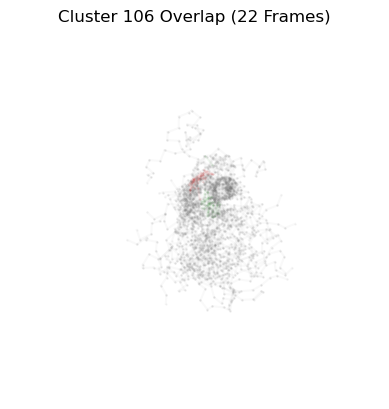

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 166.79it/s]


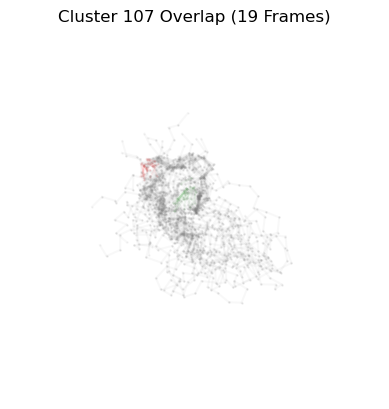

Aligning frames: 100%|█████████████████████████| 47/47 [00:00<00:00, 184.59it/s]


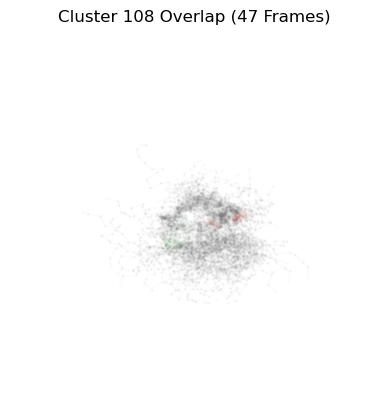

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 156.21it/s]


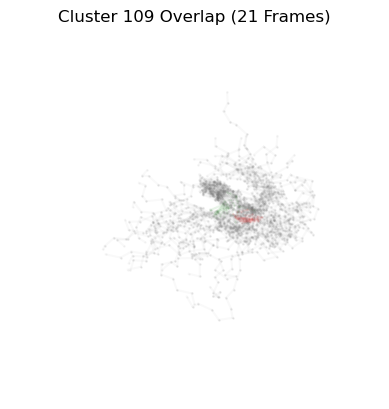

Aligning frames: 100%|█████████████████████████| 46/46 [00:00<00:00, 181.47it/s]


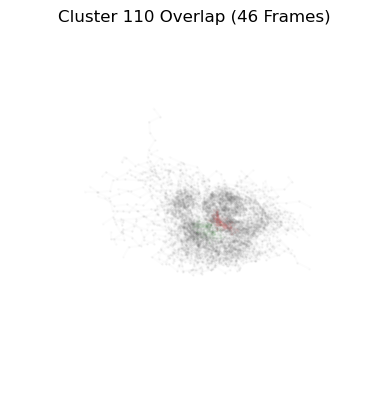

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 130.01it/s]


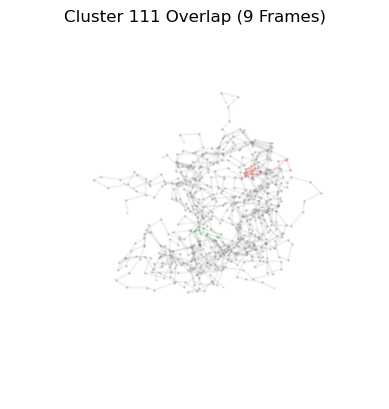

Aligning frames: 100%|█████████████████████████| 64/64 [00:00<00:00, 199.95it/s]


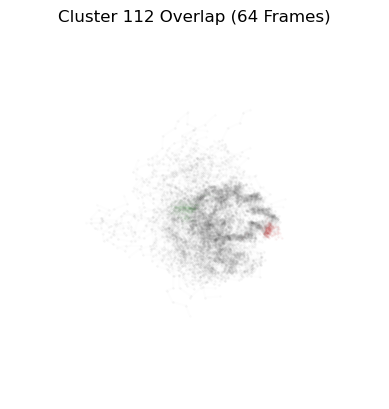

Aligning frames: 100%|█████████████████████████| 78/78 [00:00<00:00, 184.04it/s]


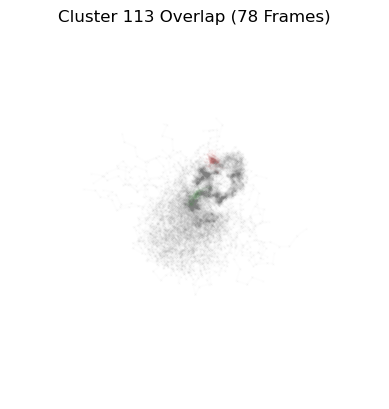

Aligning frames: 100%|███████████████████████| 110/110 [00:00<00:00, 185.56it/s]


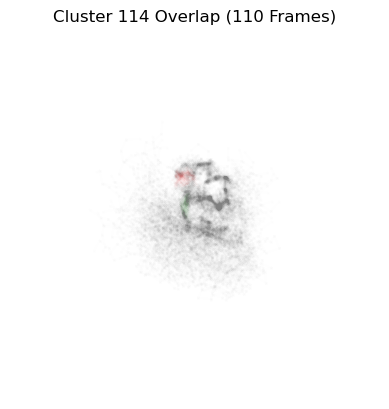

Aligning frames: 100%|██████████████████████████| 49/49 [00:00<00:00, 56.12it/s]


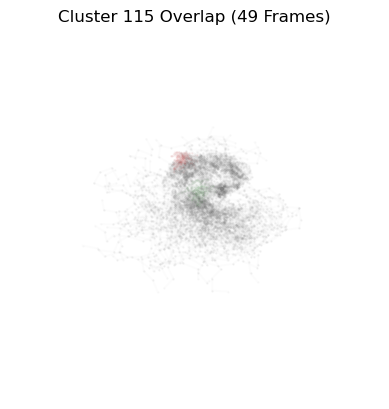

Aligning frames: 100%|█████████████████████████| 82/82 [00:00<00:00, 108.16it/s]


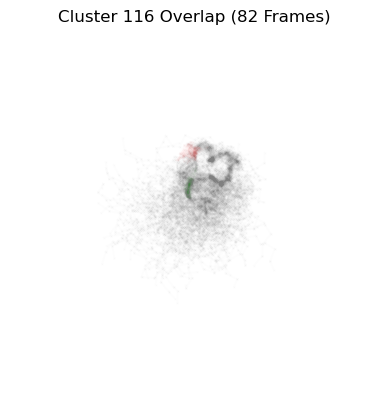

Aligning frames: 100%|██████████████████████████| 40/40 [00:00<00:00, 55.77it/s]


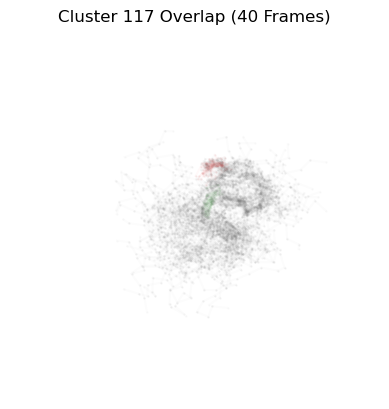

Aligning frames: 100%|█████████████████████████| 49/49 [00:00<00:00, 168.86it/s]


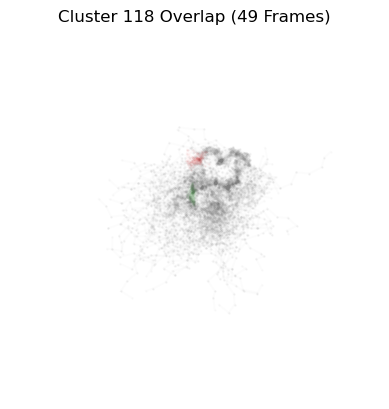

Aligning frames: 100%|██████████████████████████| 72/72 [00:00<00:00, 89.73it/s]


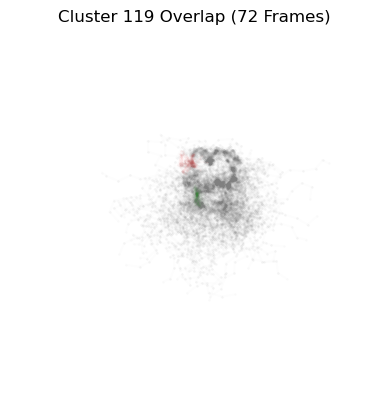

Aligning frames: 100%|███████████████████████| 108/108 [00:00<00:00, 187.82it/s]


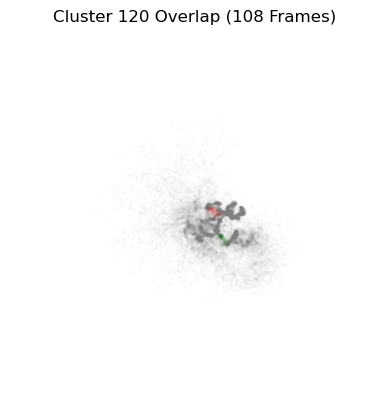

Aligning frames: 100%|█████████████████████████| 57/57 [00:00<00:00, 193.36it/s]


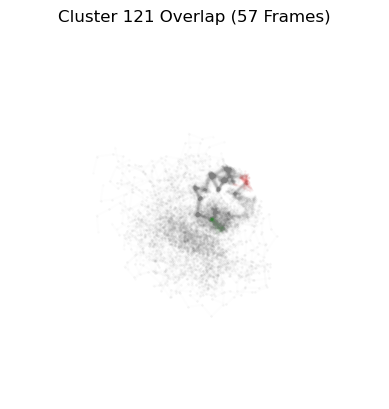

Aligning frames: 100%|█████████████████████████| 36/36 [00:00<00:00, 205.21it/s]


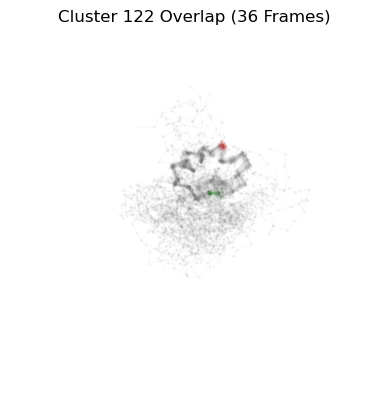

Aligning frames: 100%|█████████████████████████| 59/59 [00:00<00:00, 191.24it/s]


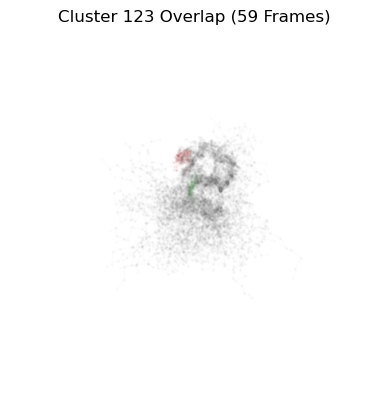

Aligning frames: 100%|███████████████████████| 117/117 [00:00<00:00, 185.67it/s]


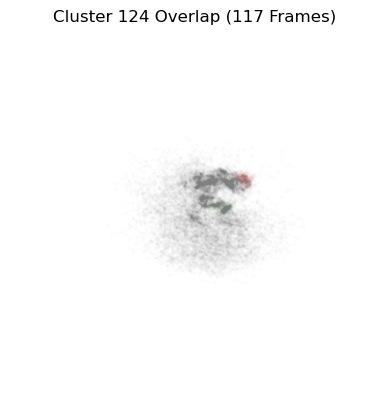

Aligning frames: 100%|██████████████████████████| 41/41 [00:00<00:00, 45.40it/s]


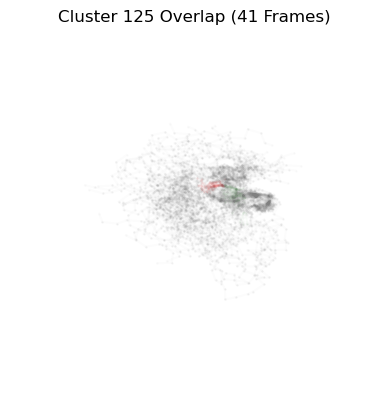

Aligning frames: 100%|█████████████████████████| 51/51 [00:00<00:00, 202.04it/s]


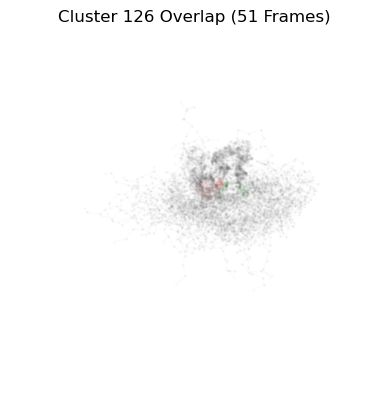

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 185.54it/s]


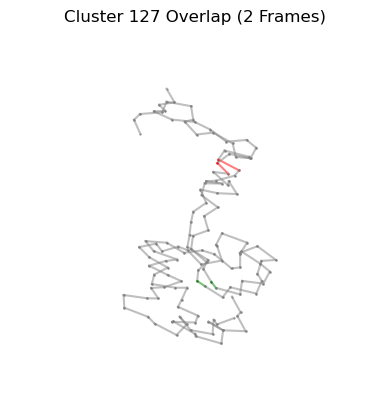

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 133.68it/s]


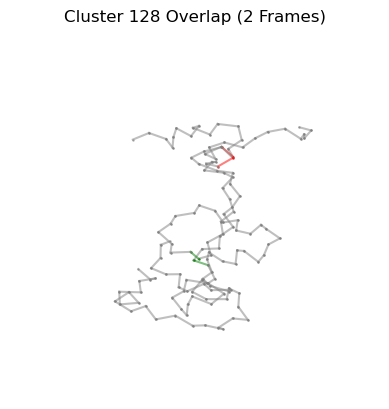

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 143.72it/s]


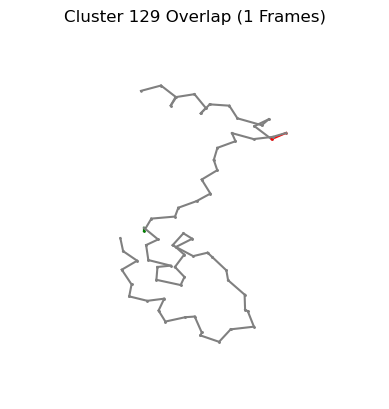

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 123.03it/s]


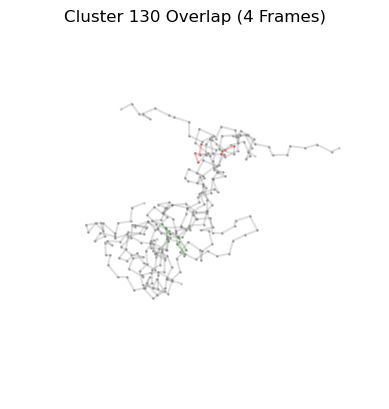

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 173.40it/s]


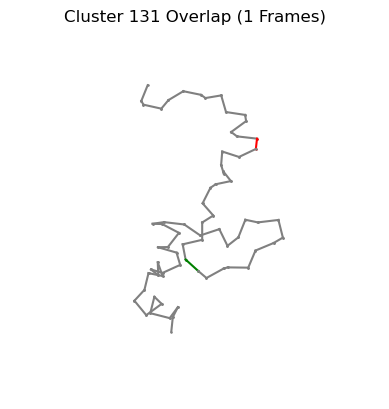

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 153.16it/s]


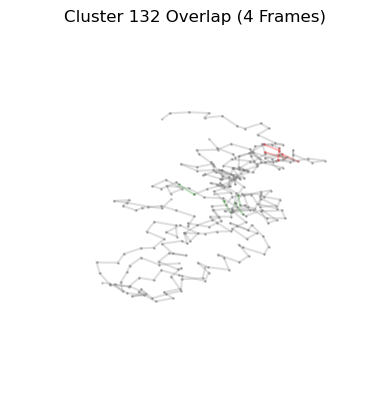

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 178.30it/s]


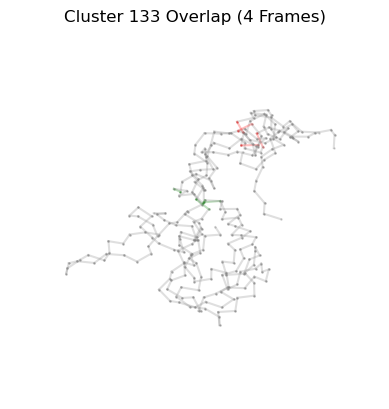

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 133.86it/s]


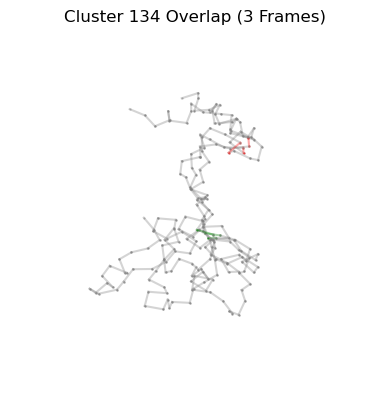

Aligning frames: 100%|████████████████████████████| 1/1 [00:00<00:00, 77.21it/s]


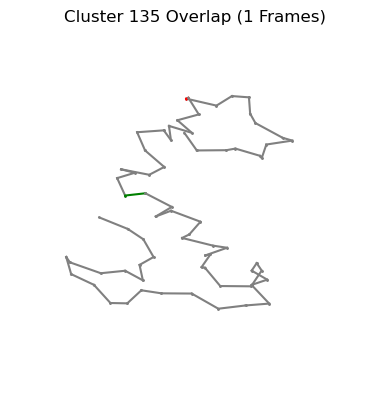

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 110.27it/s]


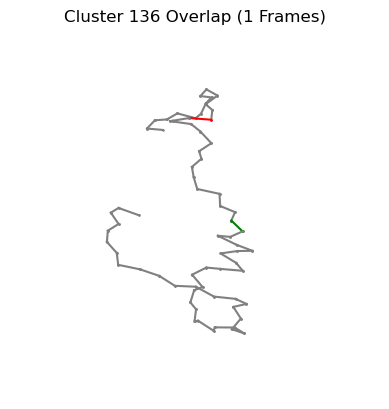

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 125.36it/s]


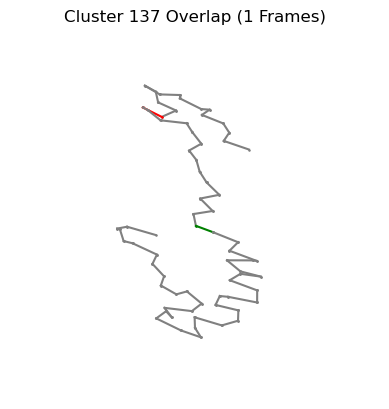

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 156.57it/s]


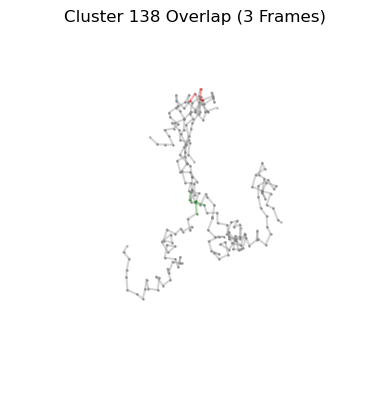

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 120.23it/s]


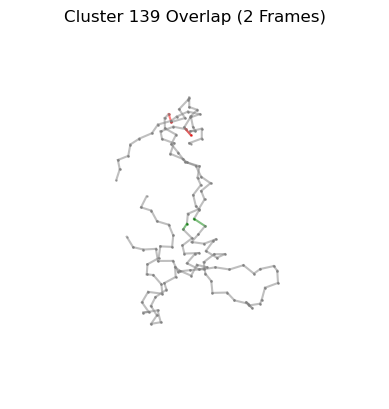

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 152.57it/s]


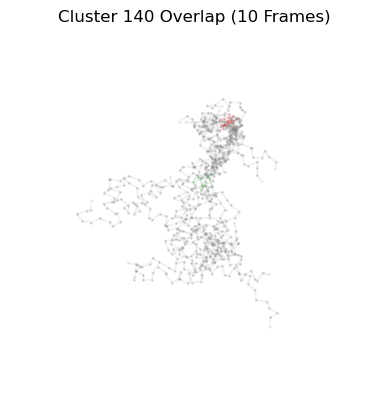

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 151.37it/s]


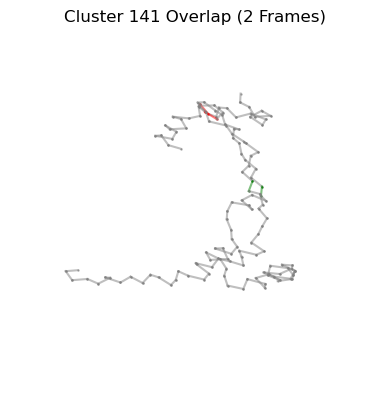

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 119.68it/s]


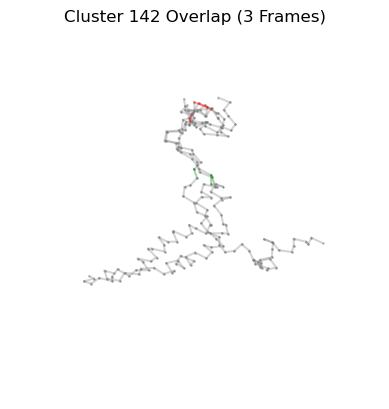

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 147.14it/s]


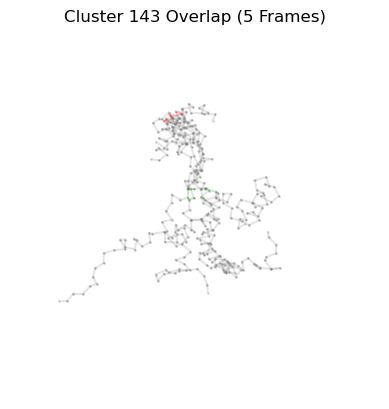

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 137.28it/s]


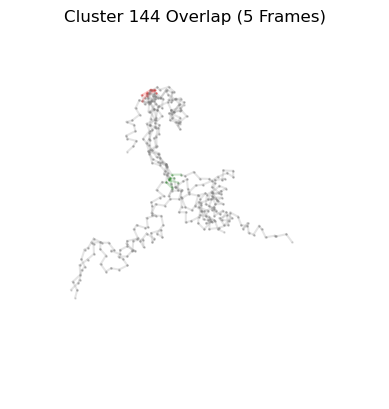

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 142.79it/s]


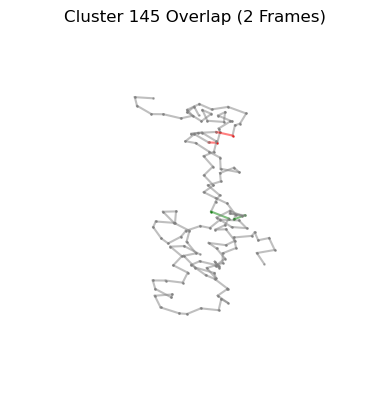

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 134.24it/s]


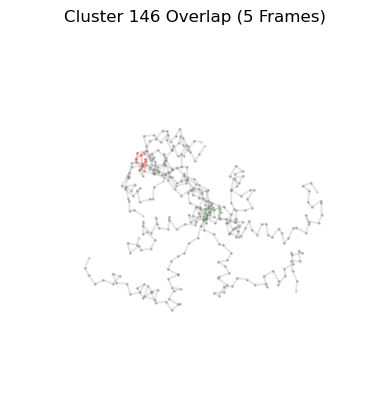

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 140.06it/s]


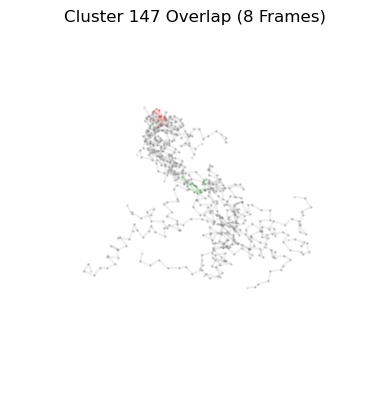

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 150.16it/s]


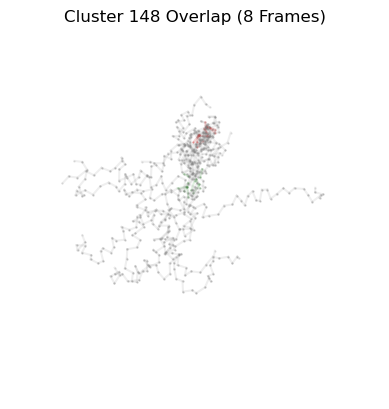

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 144.32it/s]


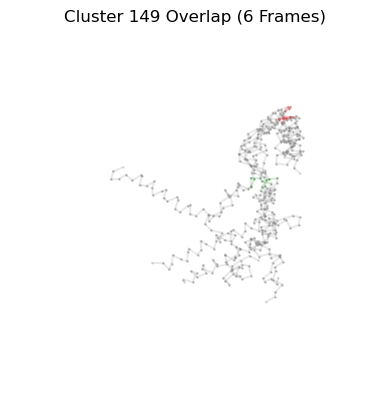

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 134.89it/s]


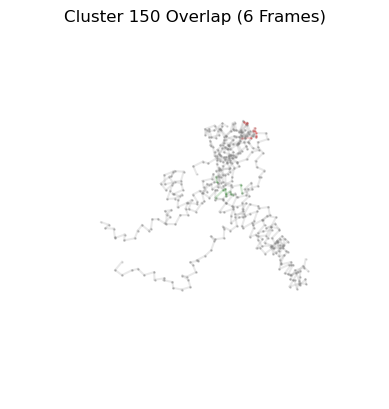

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 159.04it/s]


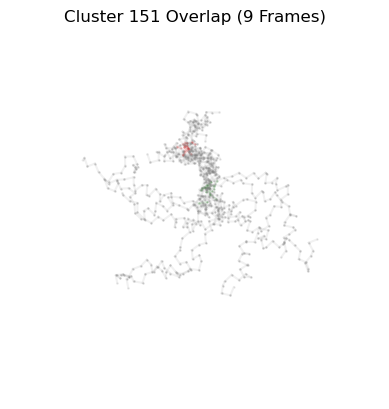

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 148.72it/s]


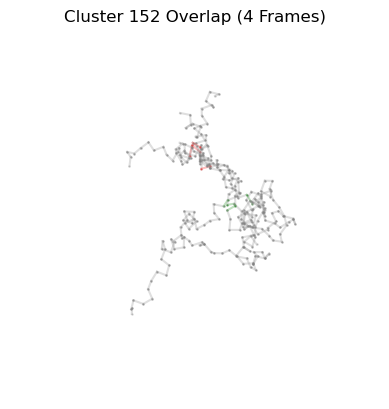

Aligning frames: 100%|██████████████████████████| 13/13 [00:00<00:00, 47.05it/s]


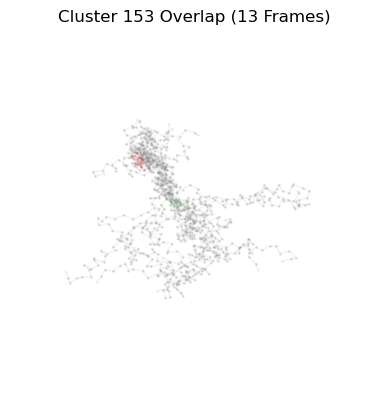

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 170.00it/s]


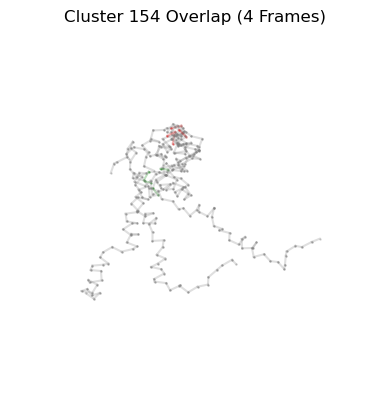

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 134.53it/s]


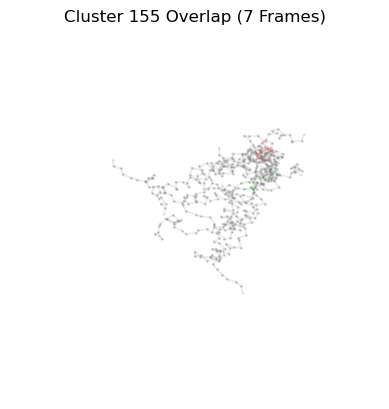

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 146.69it/s]


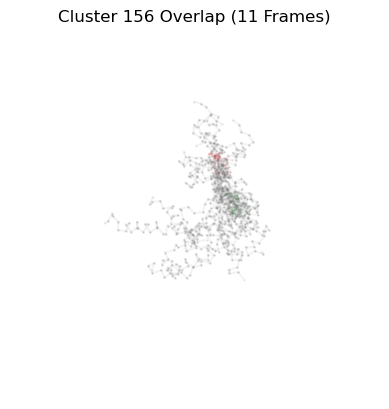

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 121.48it/s]


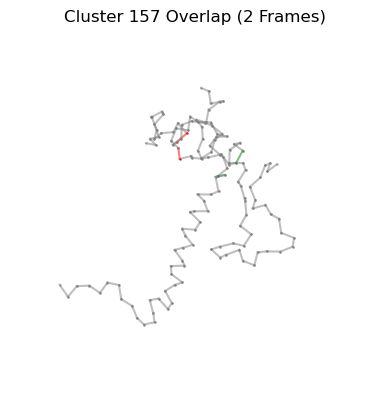

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 144.11it/s]


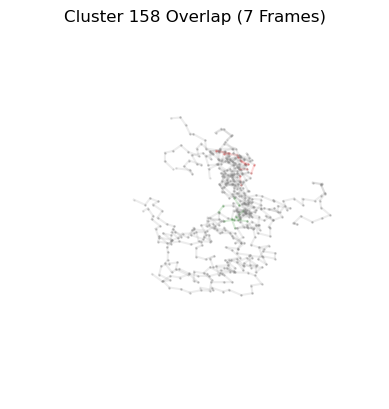

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 120.77it/s]


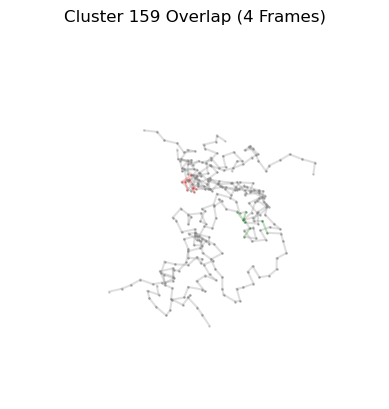

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 138.02it/s]


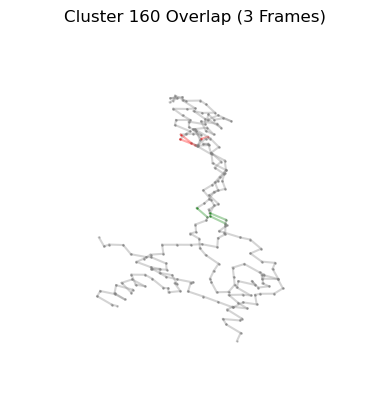

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 153.04it/s]


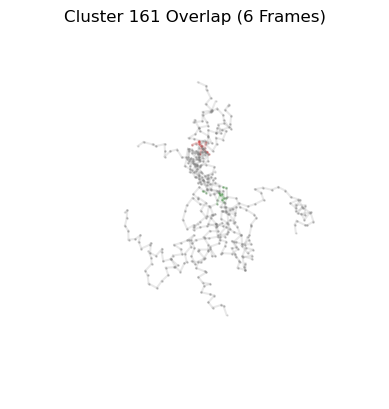

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 133.22it/s]


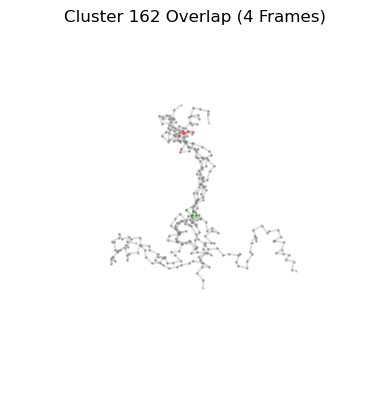

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 142.16it/s]


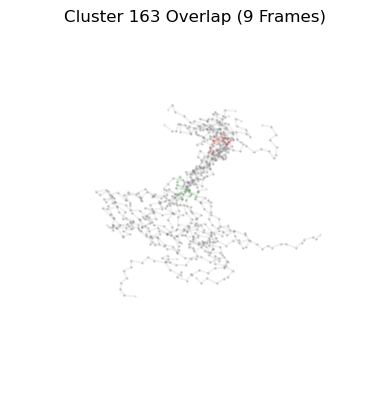

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 169.71it/s]


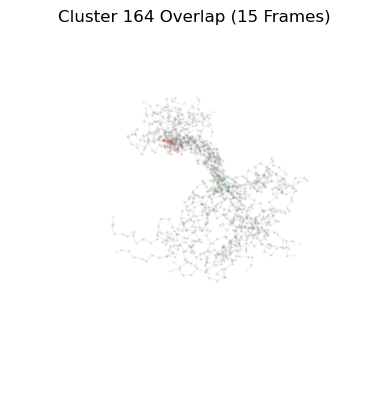

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 145.78it/s]


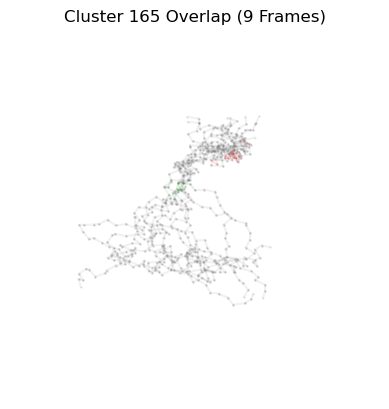

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 139.51it/s]


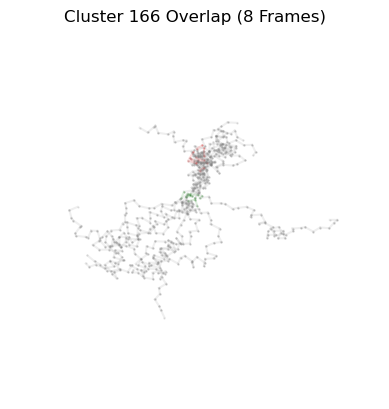

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 148.93it/s]


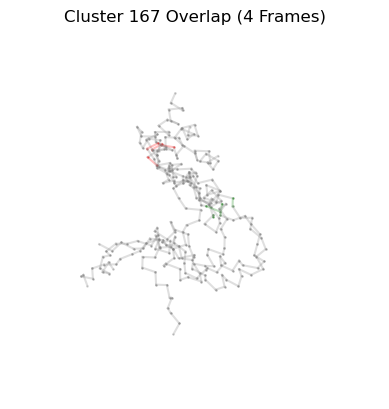

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 154.24it/s]


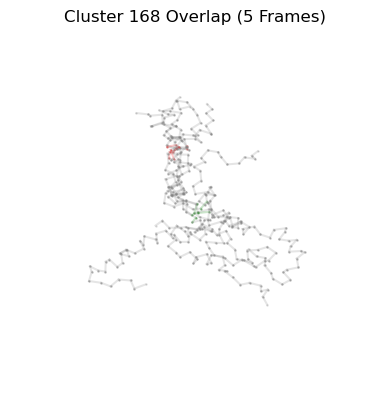

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 167.74it/s]


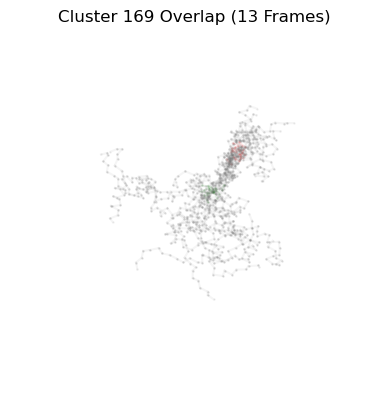

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 137.52it/s]


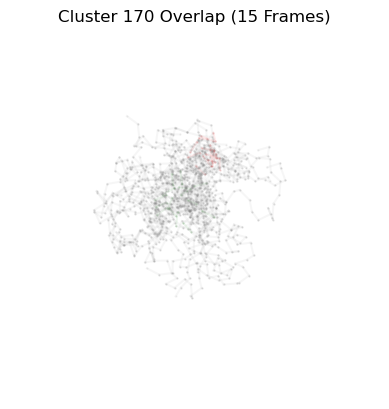

Aligning frames: 100%|█████████████████████████| 81/81 [00:00<00:00, 191.79it/s]


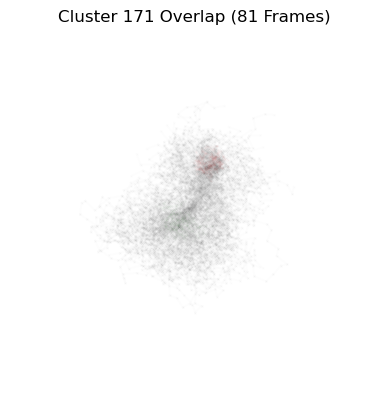

Aligning frames: 100%|██████████████████████████| 27/27 [00:00<00:00, 41.73it/s]


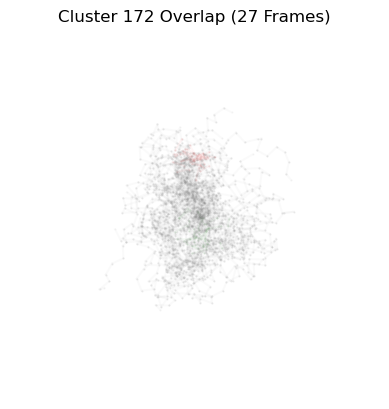

Aligning frames: 100%|█████████████████████████| 17/17 [00:00<00:00, 157.59it/s]


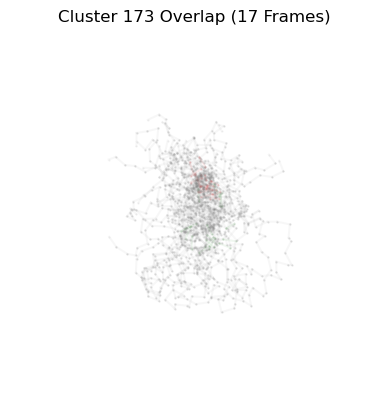

Aligning frames: 100%|█████████████████████████| 46/46 [00:00<00:00, 183.64it/s]


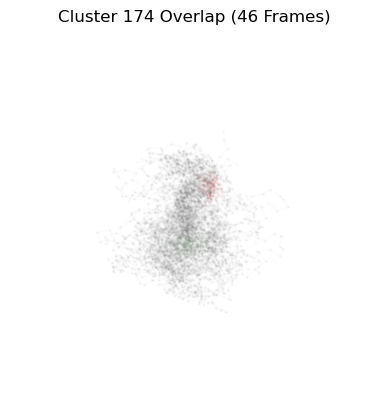

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 125.39it/s]


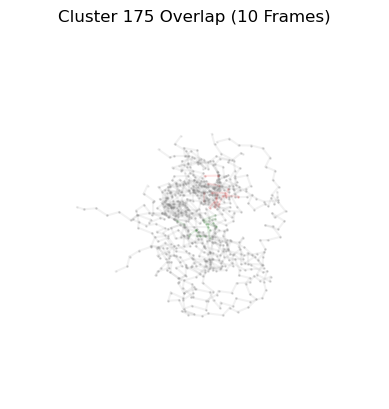

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 165.88it/s]


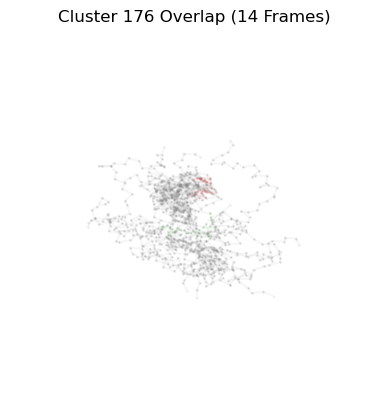

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 170.20it/s]


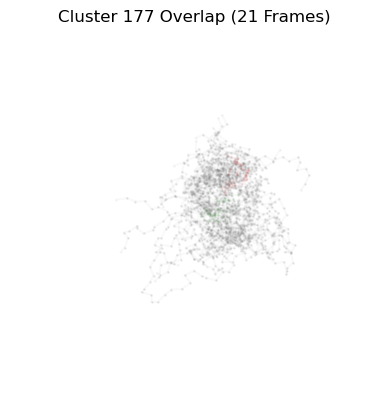

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 161.00it/s]


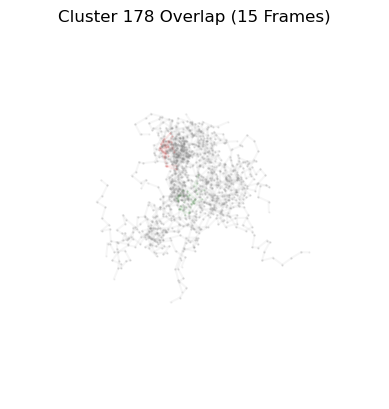

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 181.06it/s]


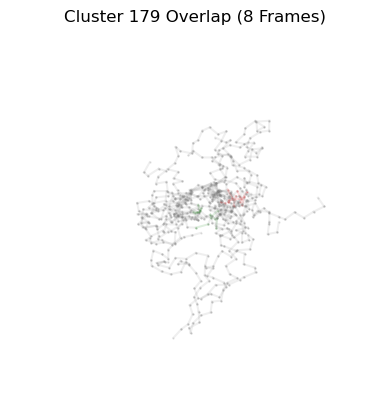

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 156.09it/s]


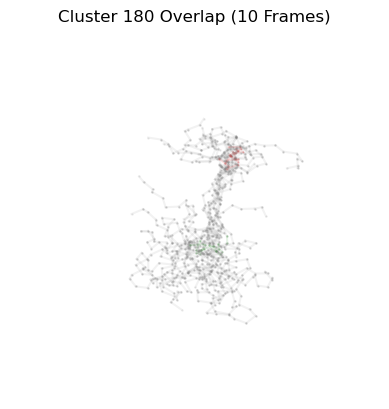

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 169.43it/s]


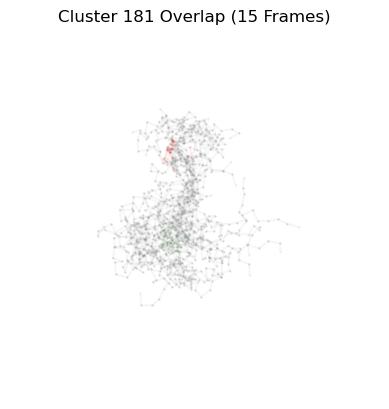

Aligning frames: 100%|██████████████████████████| 15/15 [00:00<00:00, 48.05it/s]


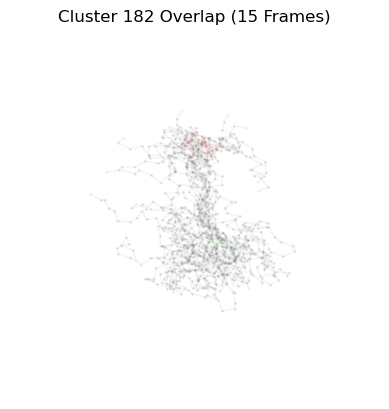

Aligning frames: 100%|██████████████████████████| 13/13 [00:00<00:00, 51.40it/s]


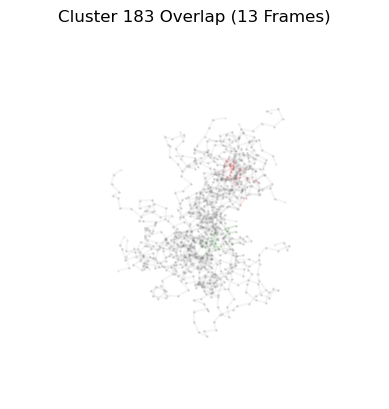

Aligning frames: 100%|█████████████████████████| 23/23 [00:00<00:00, 177.92it/s]


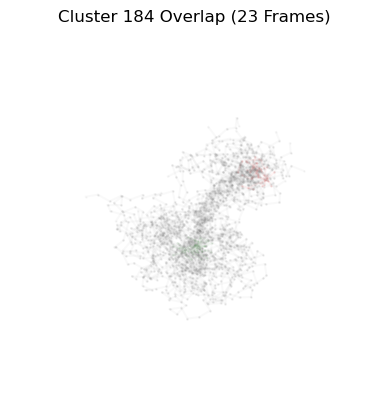

Aligning frames: 100%|█████████████████████████| 26/26 [00:00<00:00, 164.99it/s]


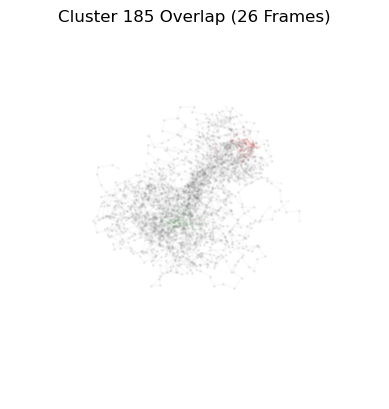

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 156.26it/s]


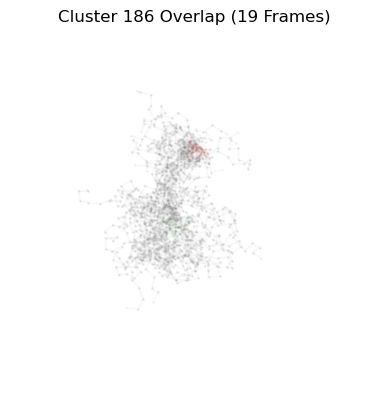

Aligning frames: 100%|██████████████████████████| 35/35 [00:00<00:00, 95.20it/s]


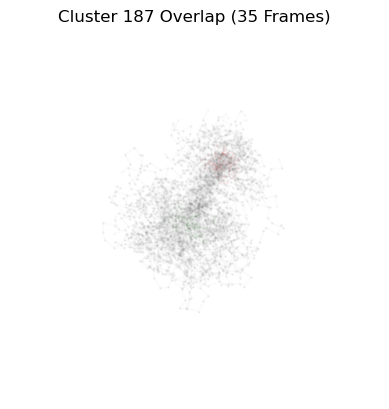

Aligning frames: 100%|██████████████████████████| 23/23 [00:00<00:00, 62.64it/s]


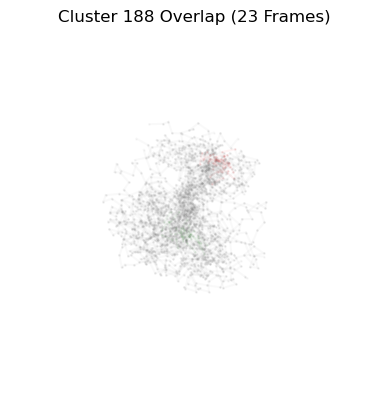

Aligning frames: 100%|█████████████████████████| 31/31 [00:00<00:00, 179.18it/s]


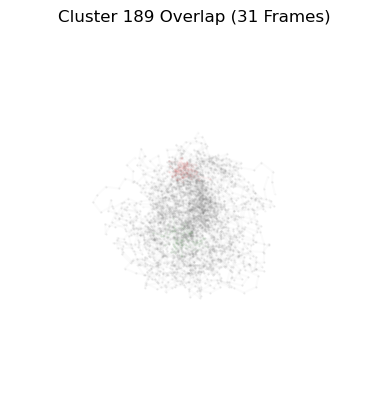

Aligning frames: 100%|█████████████████████████| 63/63 [00:00<00:00, 207.80it/s]


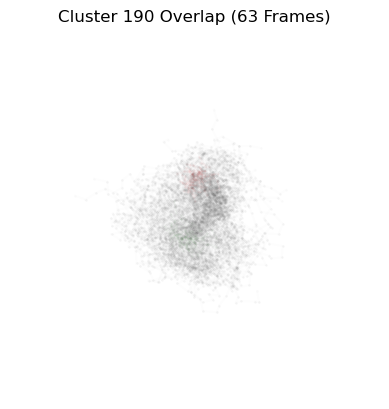

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 192.43it/s]


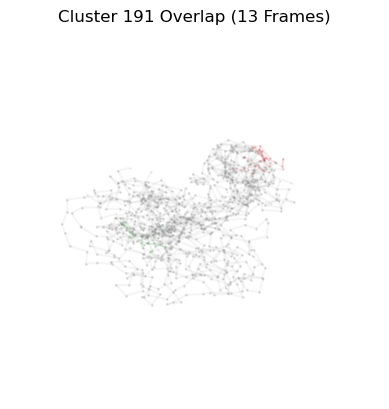

Aligning frames: 100%|████████████████████████████| 8/8 [00:00<00:00, 14.94it/s]


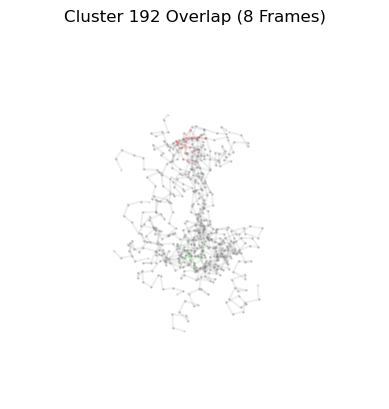

Aligning frames: 100%|█████████████████████████| 39/39 [00:00<00:00, 183.22it/s]


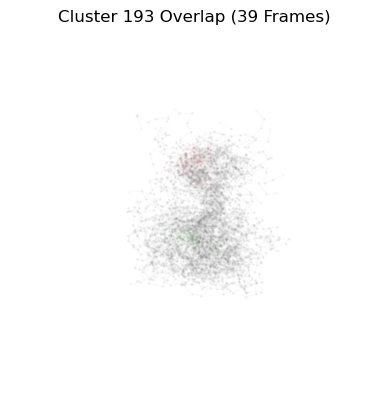

Aligning frames: 100%|██████████████████████████| 47/47 [00:00<00:00, 76.33it/s]


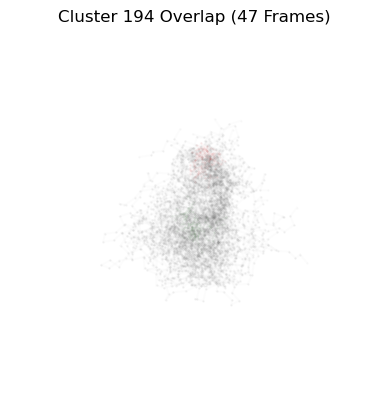

Aligning frames: 100%|█████████████████████████| 58/58 [00:00<00:00, 181.81it/s]


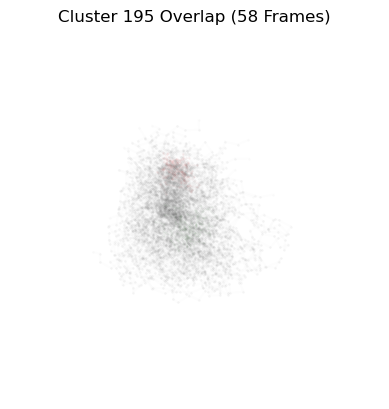

Aligning frames: 100%|█████████████████████████| 74/74 [00:00<00:00, 200.46it/s]


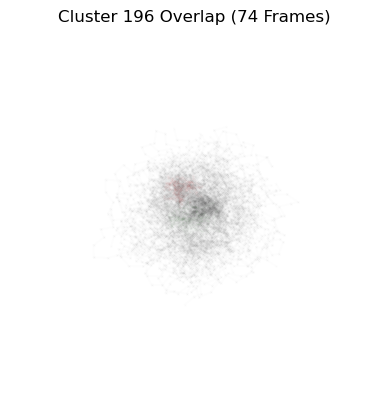

Aligning frames: 100%|█████████████████████████| 36/36 [00:00<00:00, 169.03it/s]


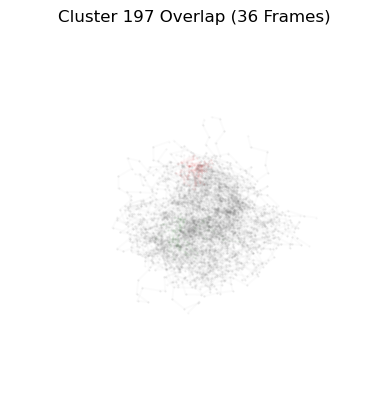

Aligning frames: 100%|█████████████████████████| 48/48 [00:00<00:00, 179.17it/s]


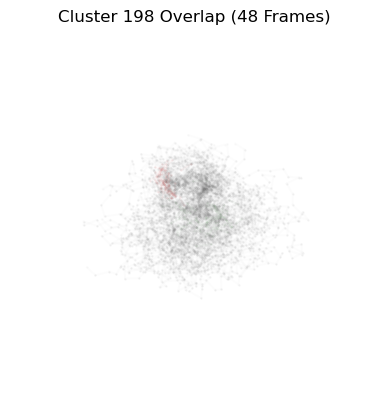

Aligning frames: 100%|█████████████████████████| 35/35 [00:00<00:00, 201.14it/s]


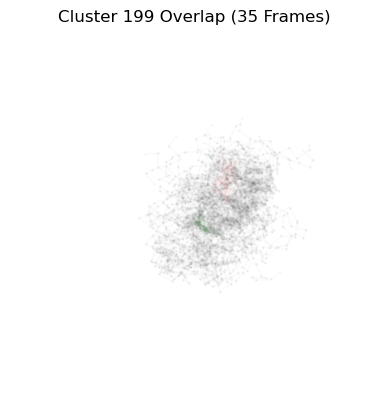

Aligning frames: 100%|██████████████████████████| 23/23 [00:00<00:00, 58.41it/s]


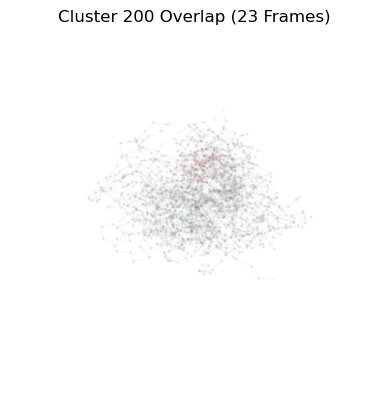

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 199.46it/s]


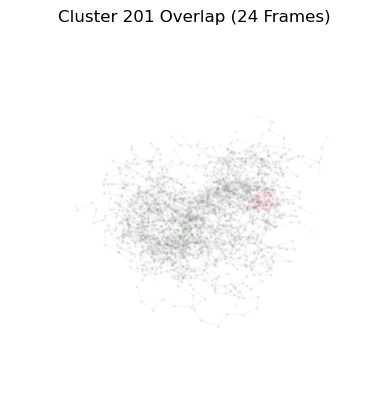

Aligning frames: 100%|█████████████████████████| 25/25 [00:00<00:00, 168.87it/s]


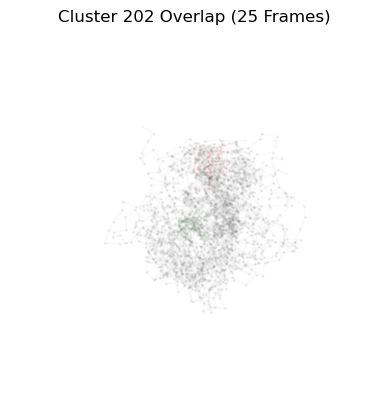

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 161.15it/s]


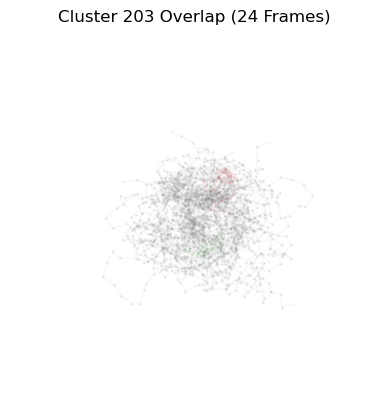

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 168.12it/s]


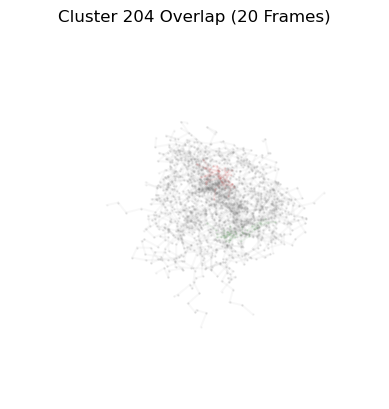

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 178.22it/s]


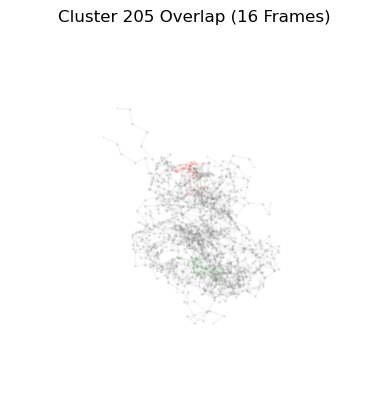

Aligning frames: 100%|██████████████████████████| 29/29 [00:00<00:00, 87.23it/s]


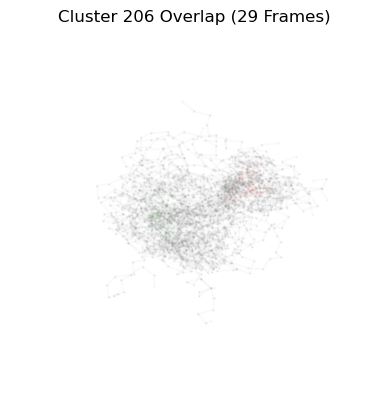

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 125.60it/s]


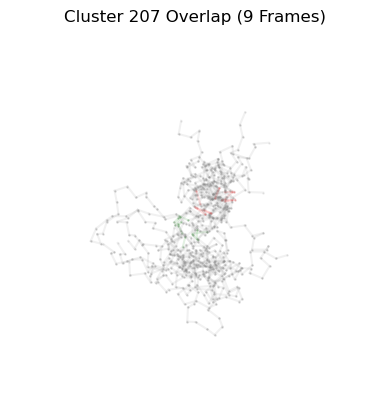

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 177.03it/s]


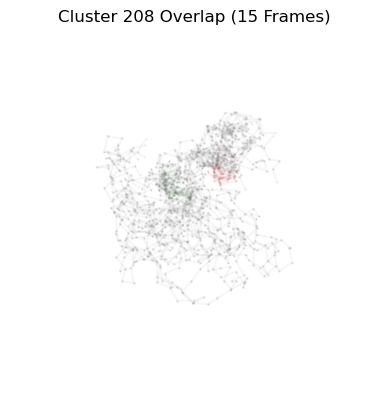

Aligning frames: 100%|█████████████████████████| 33/33 [00:00<00:00, 175.31it/s]


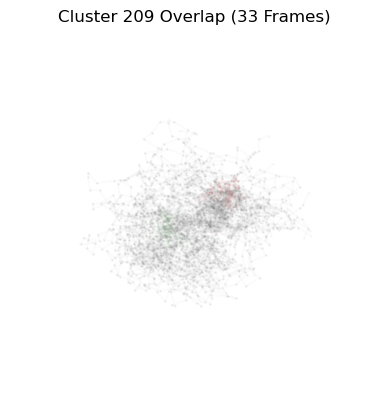

Aligning frames: 100%|█████████████████████████| 50/50 [00:00<00:00, 172.40it/s]


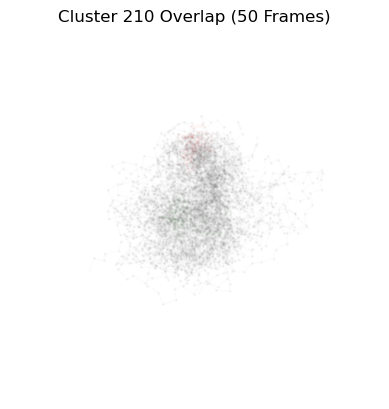

Aligning frames: 100%|█████████████████████████| 32/32 [00:00<00:00, 191.08it/s]


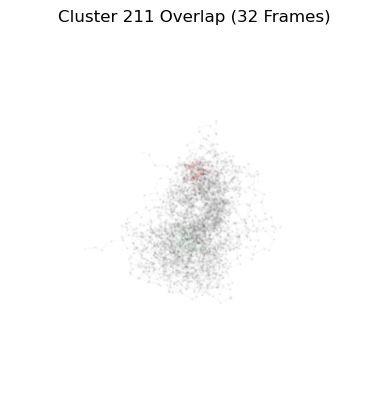

Aligning frames: 100%|█████████████████████████| 55/55 [00:00<00:00, 181.92it/s]


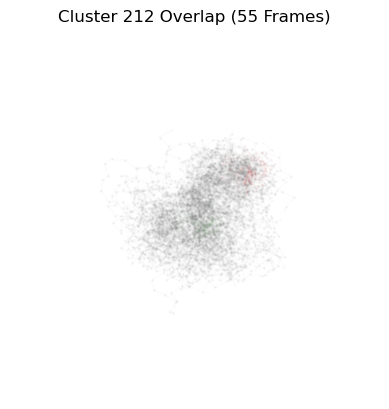

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 106.86it/s]


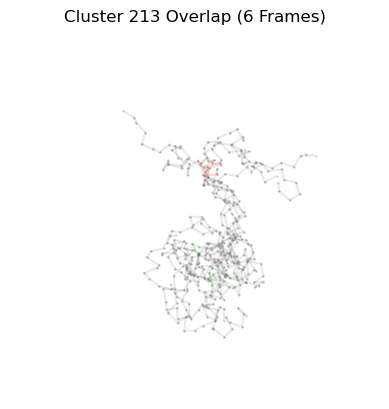

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 145.07it/s]


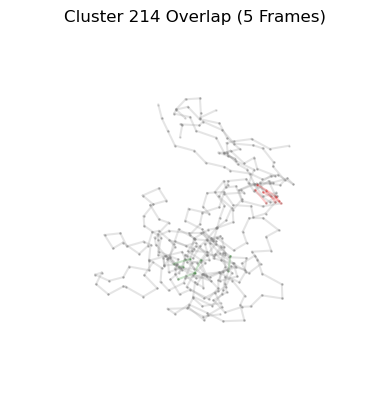

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 150.68it/s]


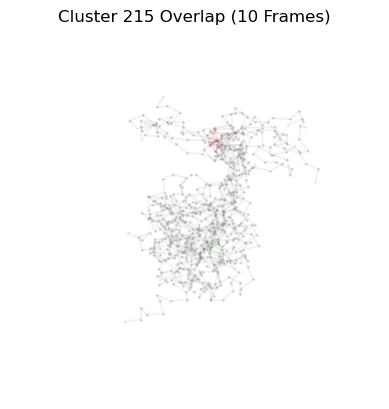

Aligning frames: 100%|█████████████████████████| 18/18 [00:00<00:00, 180.99it/s]


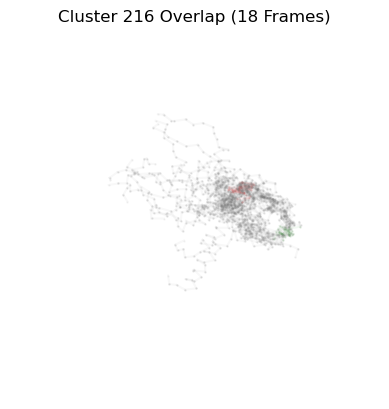

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 193.15it/s]


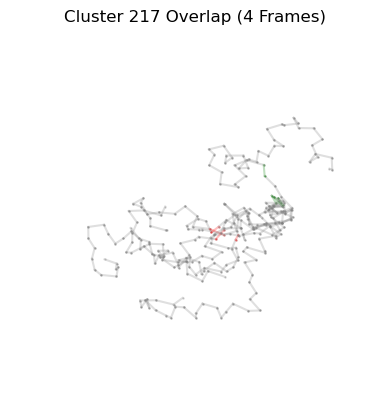

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 152.88it/s]


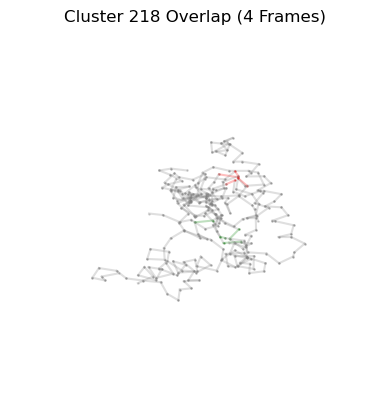

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 160.05it/s]


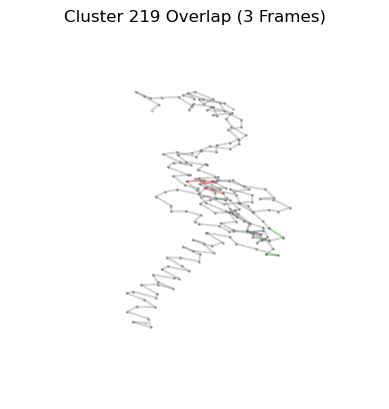

Aligning frames: 100%|███████████████████████████| 1/1 [00:00<00:00, 168.15it/s]


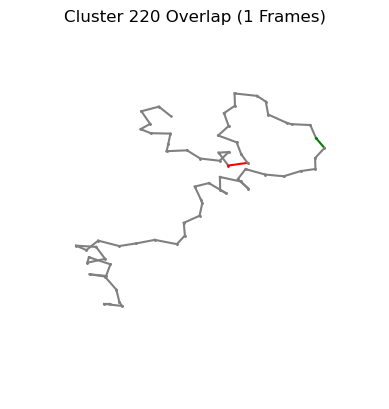

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 151.06it/s]


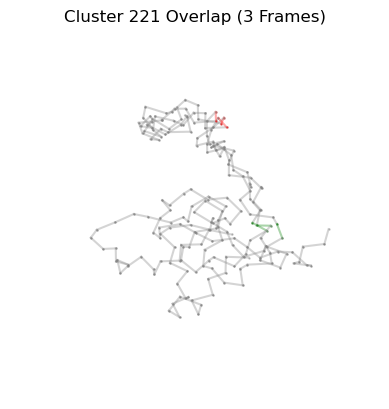

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 145.78it/s]


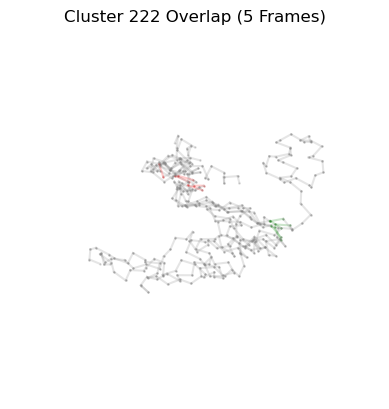

Aligning frames: 100%|██████████████████████████| 14/14 [00:00<00:00, 53.85it/s]


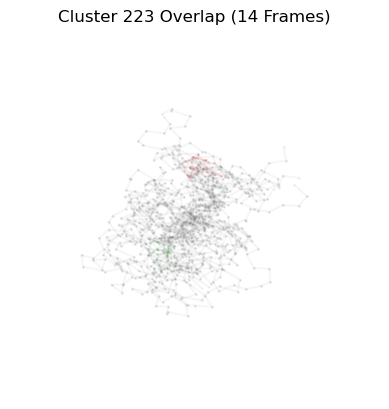

Aligning frames: 100%|████████████████████████████| 3/3 [00:00<00:00, 98.17it/s]


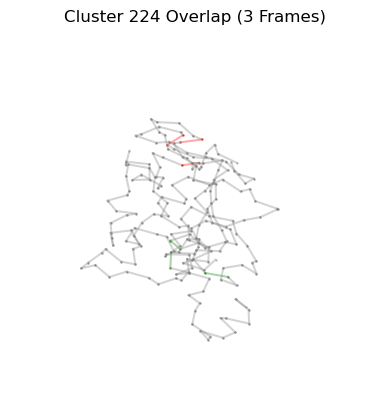

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 169.24it/s]


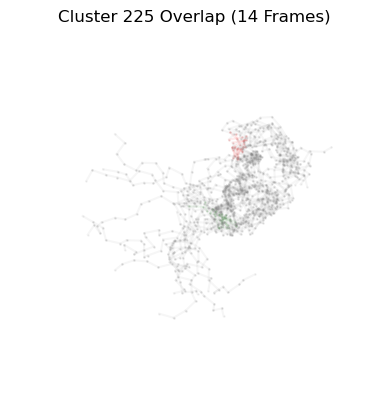

Aligning frames: 100%|██████████████████████████| 37/37 [00:00<00:00, 90.03it/s]


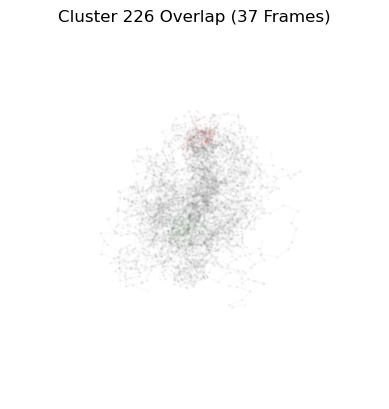

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 155.24it/s]


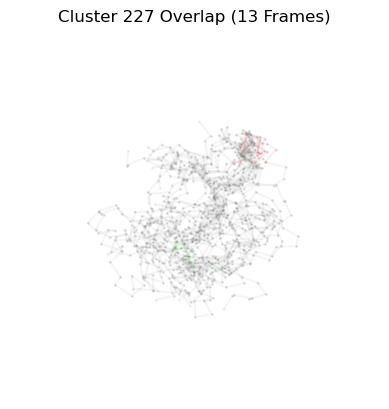

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 164.16it/s]


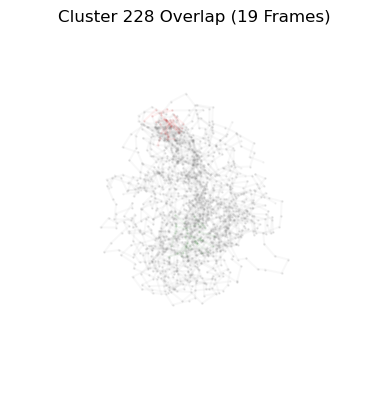

Aligning frames: 100%|██████████████████████████| 27/27 [00:00<00:00, 83.45it/s]


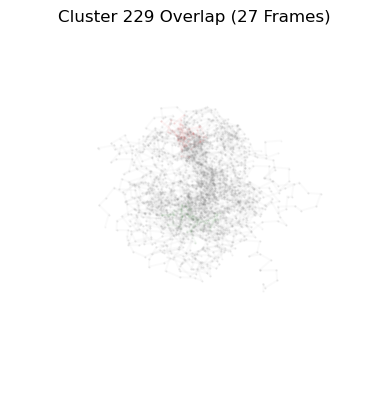

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 180.96it/s]


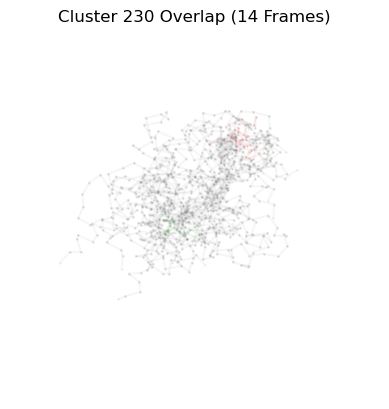

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 135.50it/s]


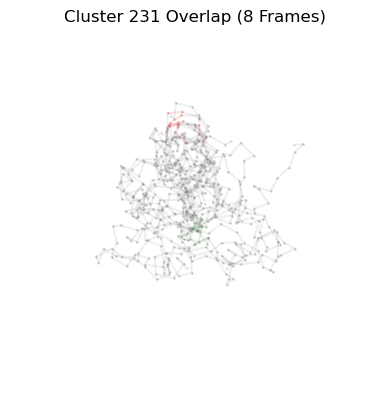

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 173.66it/s]


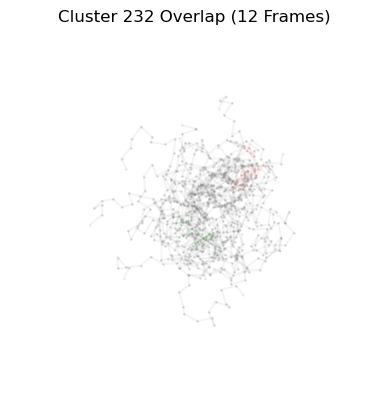

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 146.50it/s]


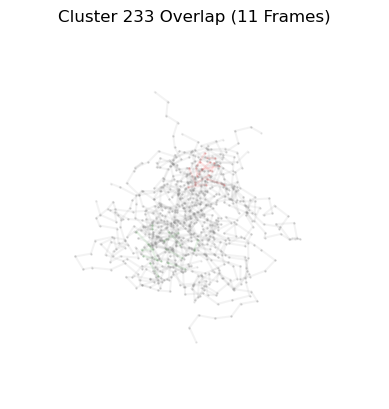

Aligning frames: 100%|█████████████████████████| 23/23 [00:00<00:00, 168.51it/s]


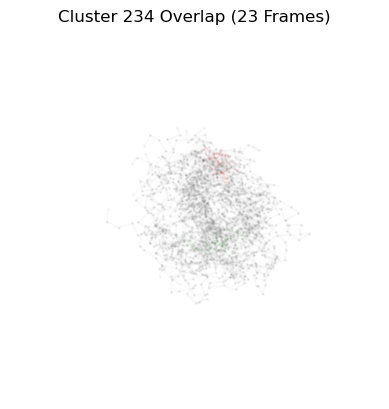

Aligning frames: 100%|██████████████████████████| 18/18 [00:00<00:00, 57.80it/s]


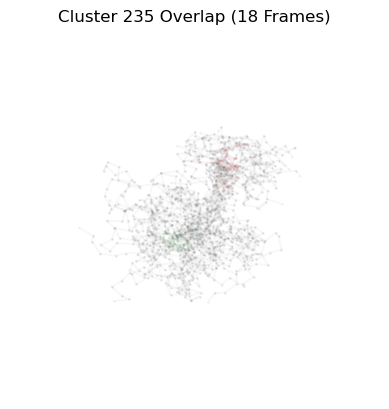

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 184.44it/s]


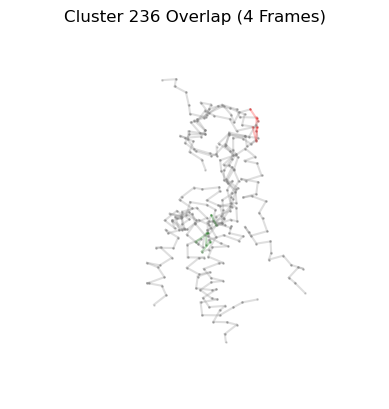

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 145.16it/s]


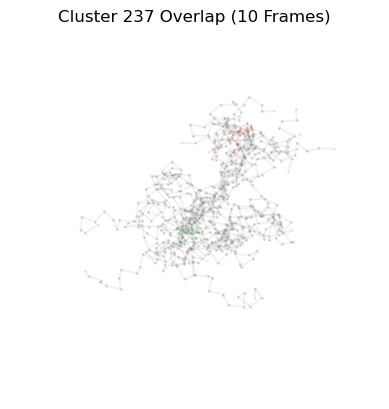

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 168.72it/s]


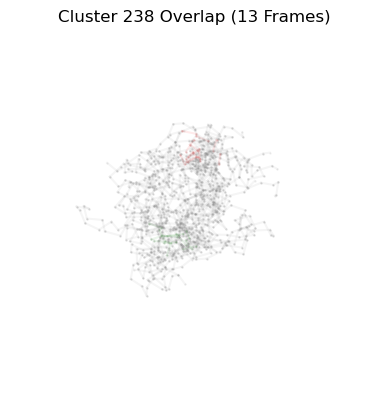

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 159.22it/s]


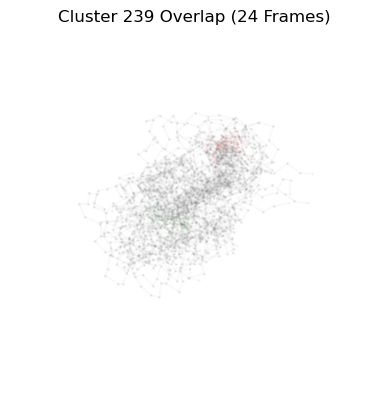

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 173.89it/s]


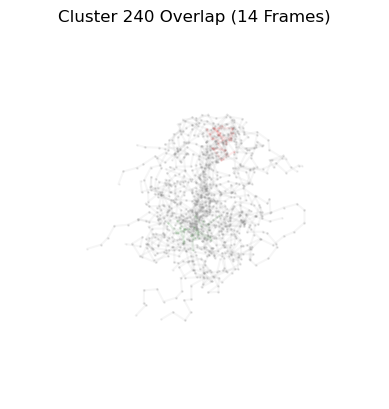

Aligning frames: 100%|██████████████████████████| 23/23 [00:00<00:00, 58.26it/s]


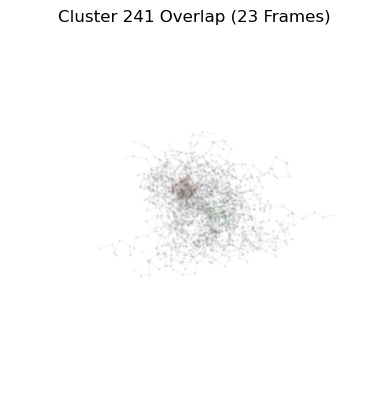

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 168.38it/s]


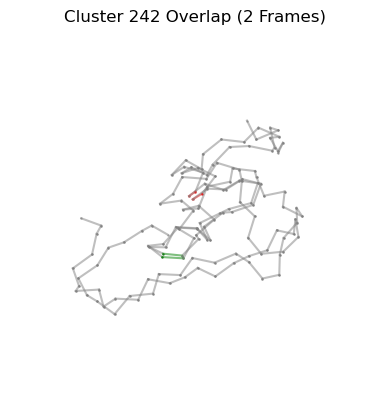

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 152.28it/s]


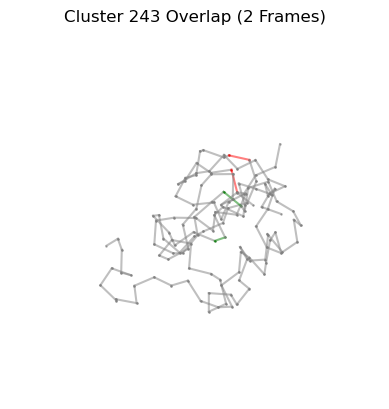

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 129.98it/s]


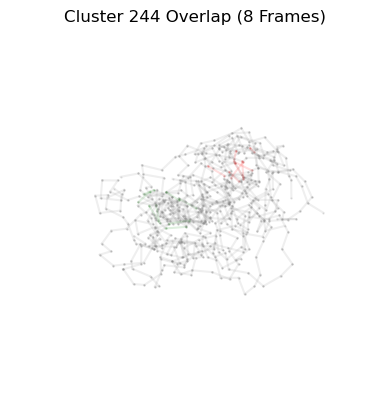

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 183.32it/s]


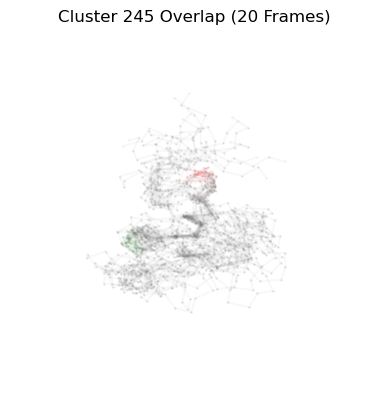

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 158.05it/s]


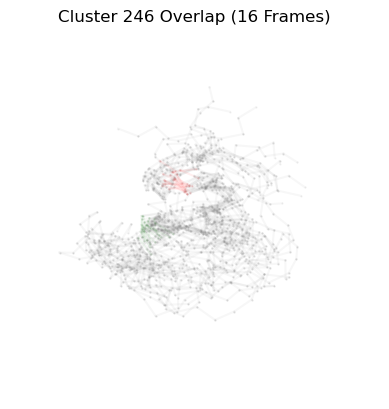

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 161.83it/s]


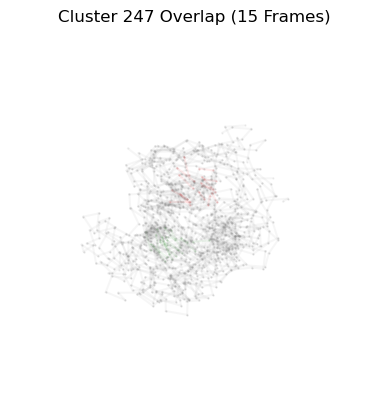

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 164.25it/s]


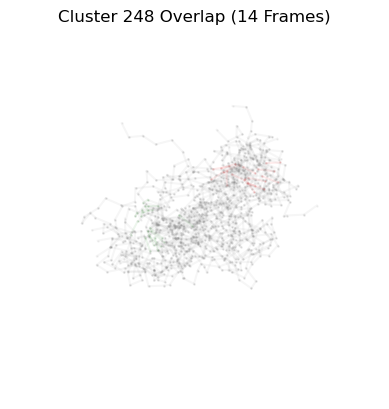

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 176.10it/s]


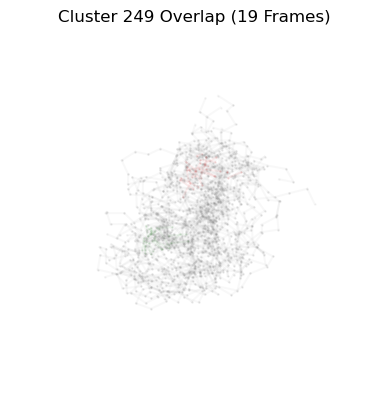

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 151.43it/s]


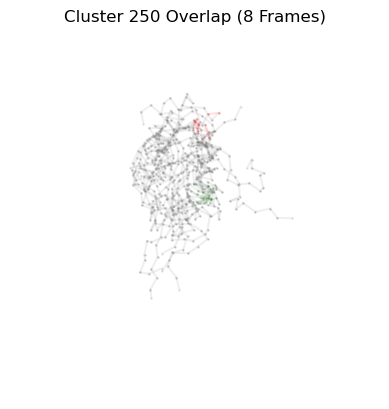

Aligning frames: 100%|██████████████████████████| 11/11 [00:00<00:00, 35.53it/s]


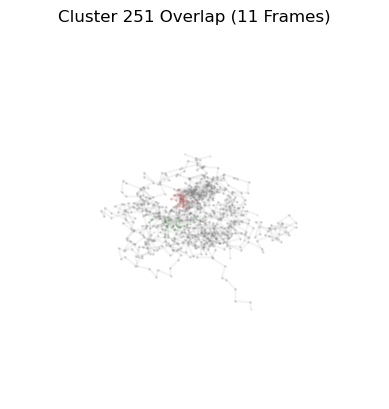

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 150.18it/s]


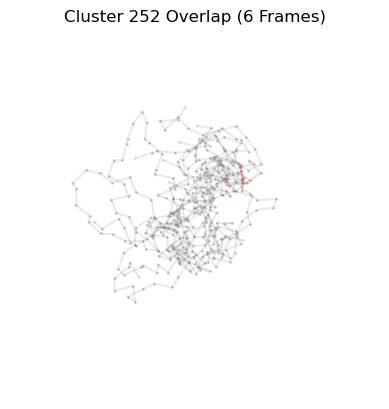

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 166.89it/s]


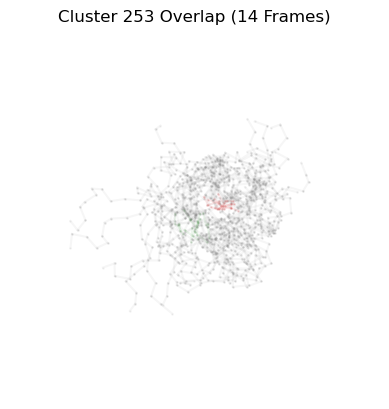

Aligning frames: 100%|████████████████████████████| 8/8 [00:00<00:00, 32.01it/s]


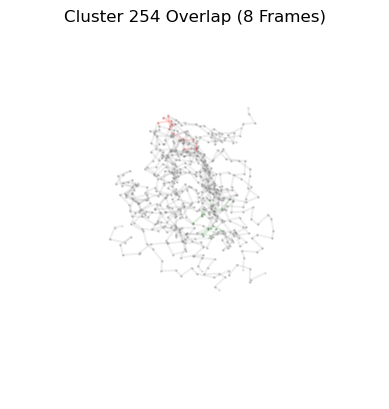

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 148.07it/s]


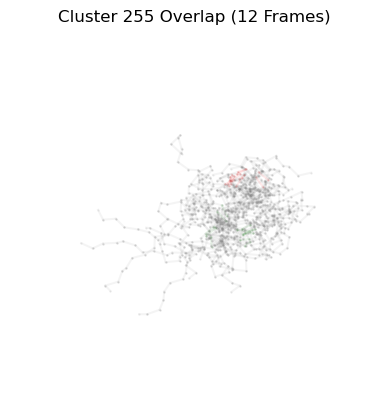

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 175.65it/s]


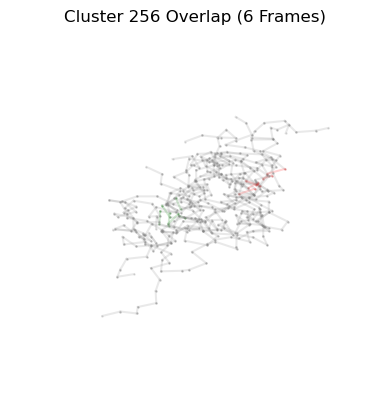

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 139.34it/s]


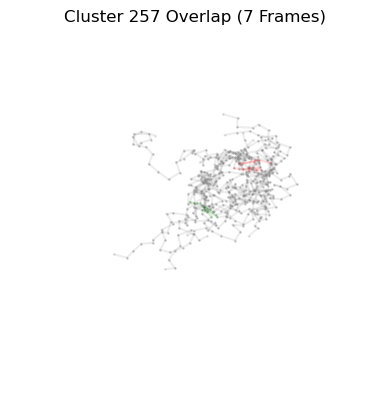

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 120.38it/s]


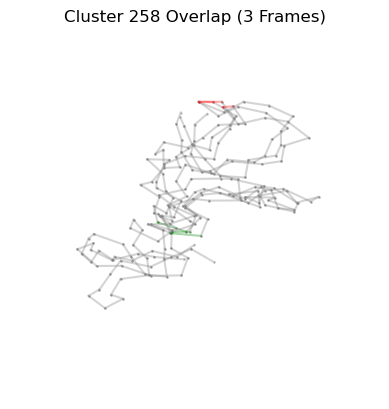

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 105.61it/s]


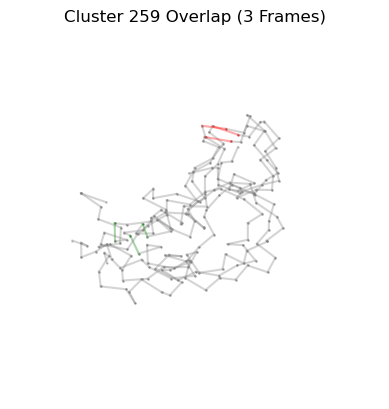

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 159.54it/s]


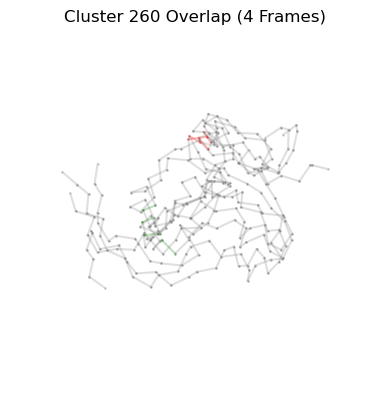

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 130.71it/s]


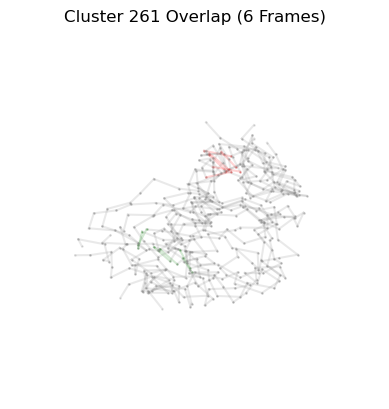

Aligning frames: 100%|█████████████████████████| 18/18 [00:00<00:00, 157.90it/s]


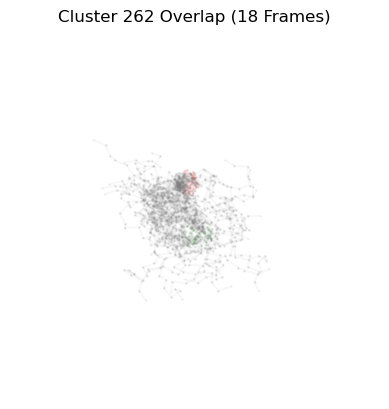

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 207.93it/s]


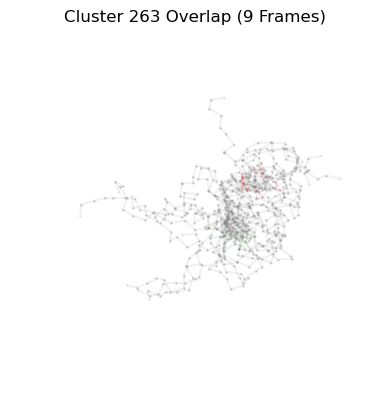

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 134.19it/s]


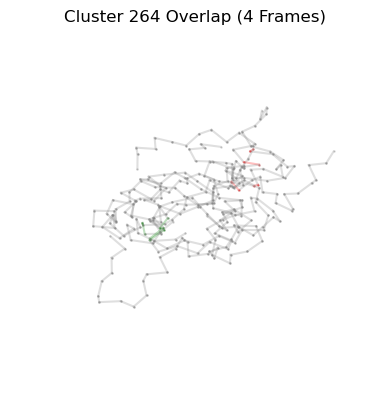

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 145.29it/s]


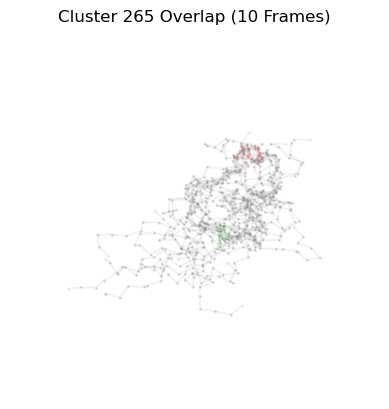

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 158.20it/s]


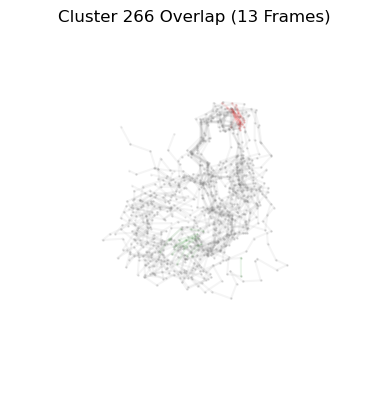

Aligning frames: 100%|█████████████████████████| 17/17 [00:00<00:00, 181.04it/s]


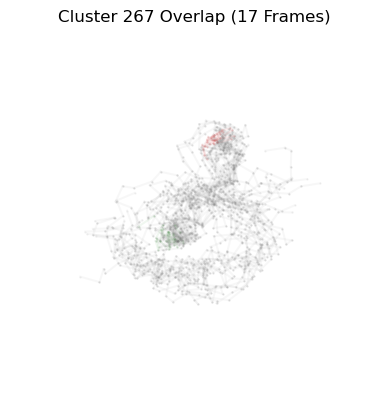

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 171.22it/s]


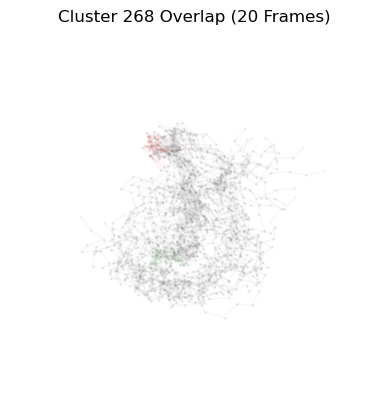

Aligning frames: 100%|█████████████████████████| 25/25 [00:00<00:00, 168.94it/s]


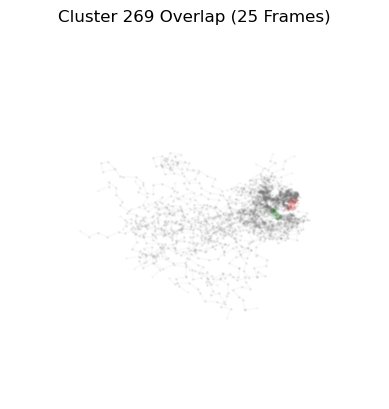

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 117.83it/s]


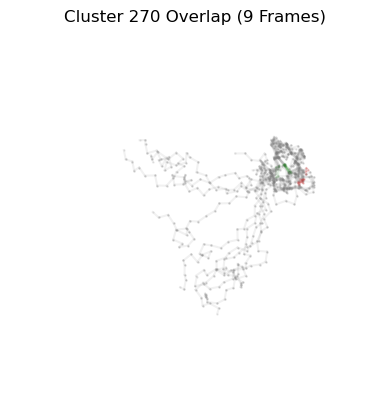

Aligning frames: 100%|████████████████████████████| 3/3 [00:00<00:00, 10.16it/s]


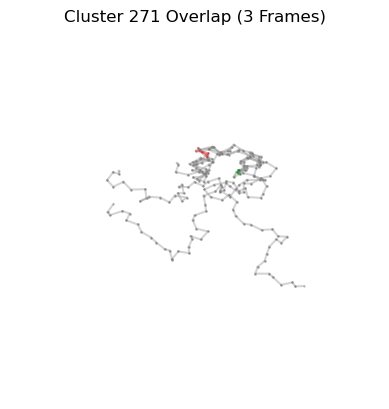

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 134.86it/s]


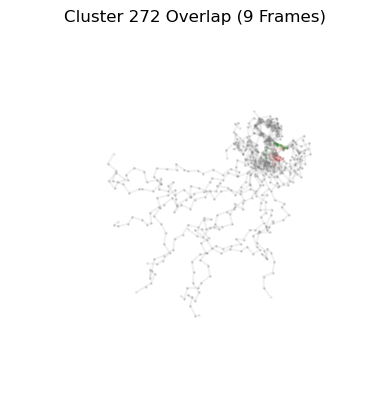

Aligning frames: 100%|██████████████████████████| 28/28 [00:00<00:00, 79.17it/s]


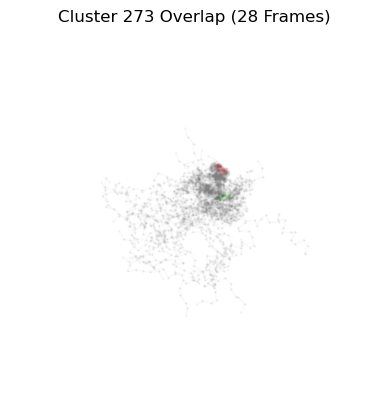

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 171.82it/s]


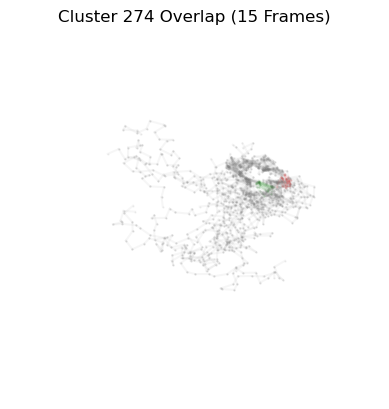

Aligning frames: 100%|█████████████████████████| 34/34 [00:00<00:00, 175.50it/s]


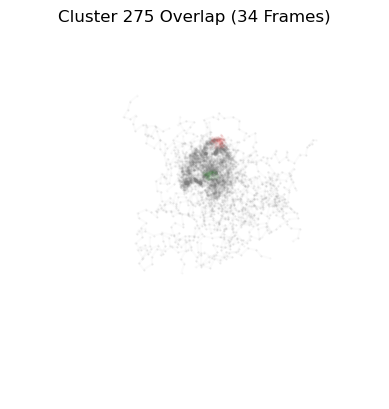

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 171.38it/s]


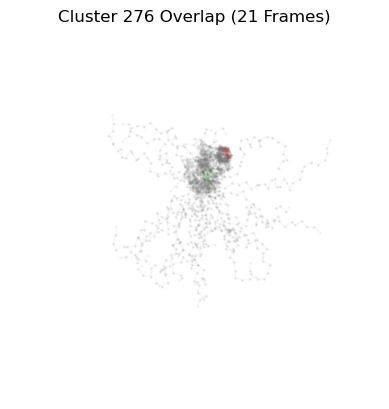

Aligning frames: 100%|█████████████████████████| 37/37 [00:00<00:00, 179.69it/s]


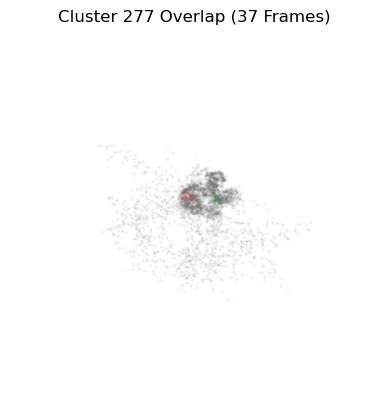

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 165.56it/s]


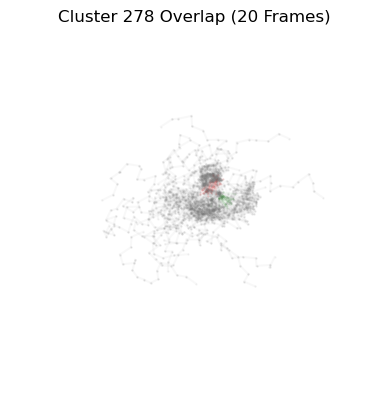

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 209.62it/s]


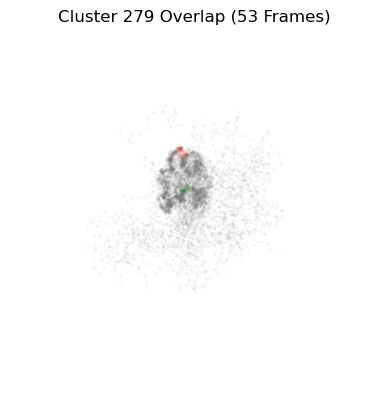

Aligning frames: 100%|██████████████████████████| 57/57 [00:00<00:00, 83.90it/s]


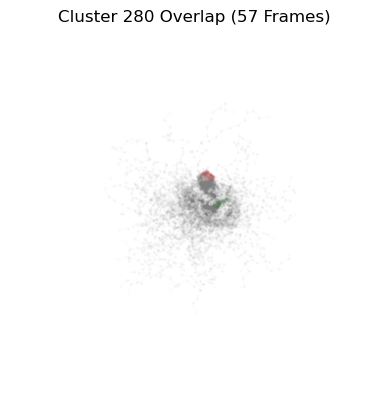

Aligning frames: 100%|██████████████████████████| 61/61 [00:00<00:00, 88.11it/s]


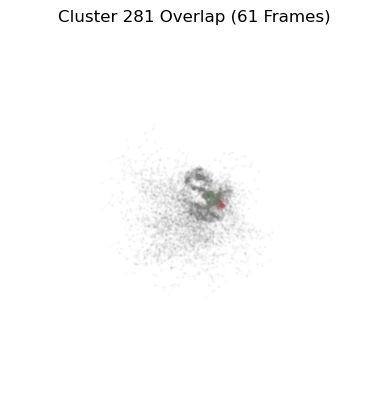

Aligning frames: 100%|█████████████████████████| 35/35 [00:00<00:00, 187.55it/s]


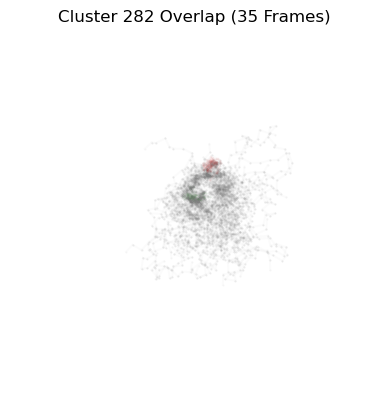

Aligning frames: 100%|██████████████████████████| 28/28 [00:00<00:00, 54.00it/s]


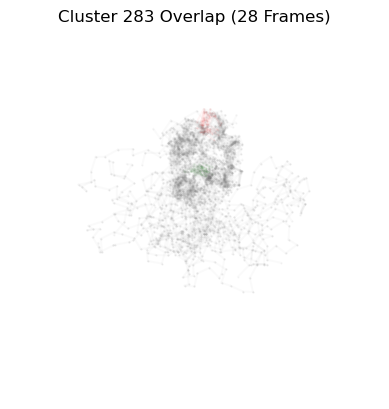

Aligning frames: 100%|█████████████████████████| 42/42 [00:00<00:00, 166.93it/s]


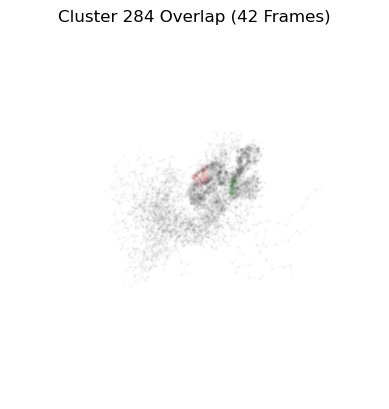

Aligning frames: 100%|██████████████████████████| 30/30 [00:00<00:00, 67.31it/s]


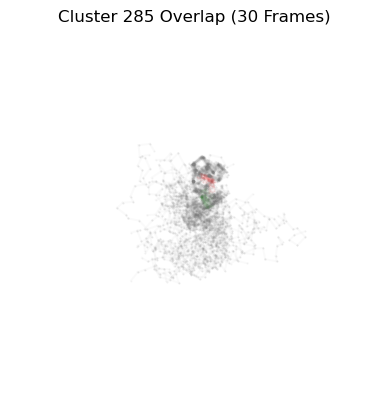

Aligning frames: 100%|██████████████████████████| 34/34 [00:00<00:00, 84.03it/s]


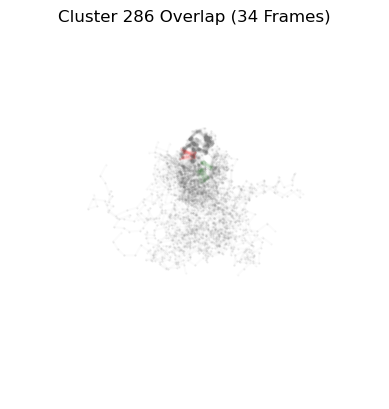

Aligning frames: 100%|██████████████████████████| 38/38 [00:00<00:00, 81.11it/s]


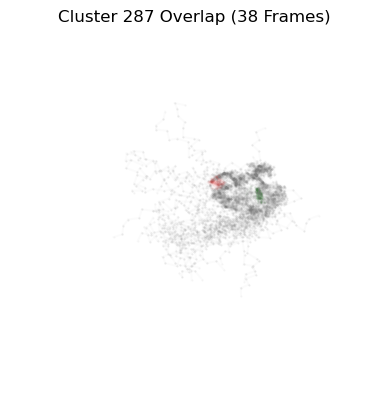

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 193.21it/s]


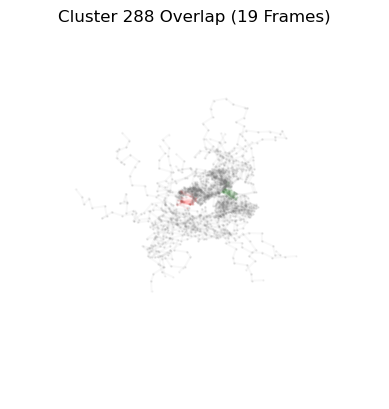

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 153.72it/s]


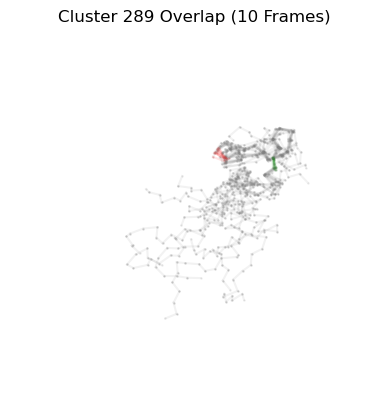

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 172.46it/s]


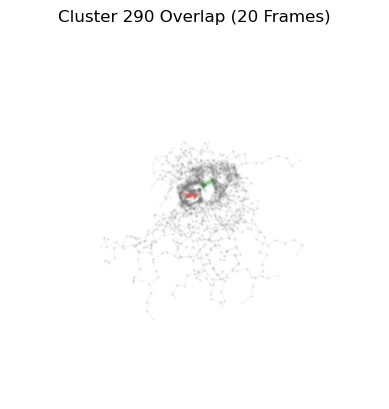

Aligning frames: 100%|██████████████████████████| 17/17 [00:00<00:00, 54.38it/s]


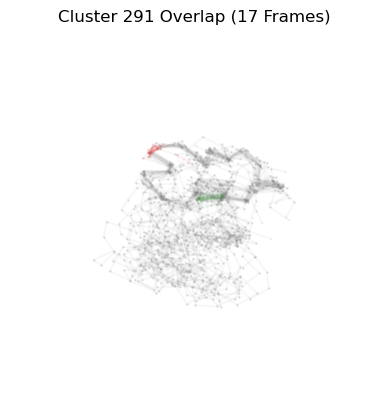

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 183.44it/s]


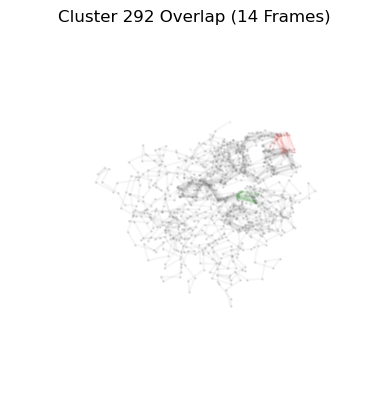

Aligning frames: 100%|██████████████████████████| 18/18 [00:00<00:00, 72.11it/s]


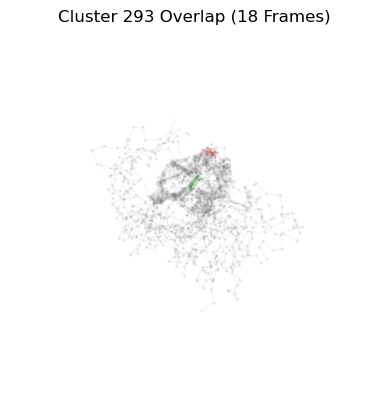

Aligning frames: 100%|█████████████████████████| 49/49 [00:00<00:00, 181.42it/s]


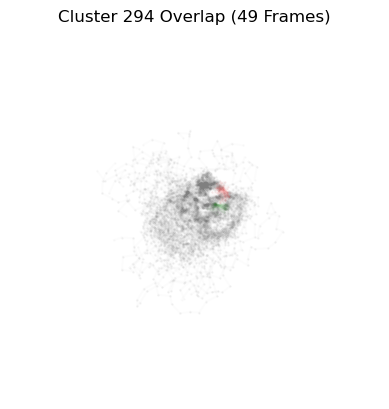

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 182.00it/s]


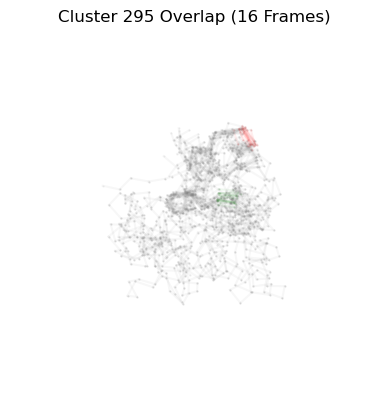

Aligning frames: 100%|█████████████████████████| 49/49 [00:00<00:00, 176.02it/s]


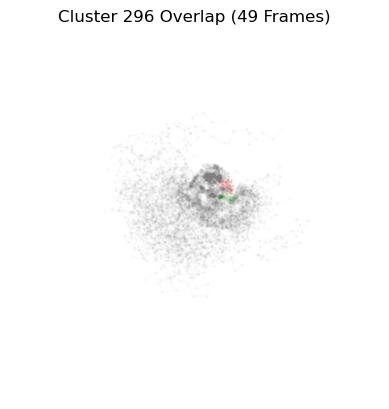

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 154.76it/s]


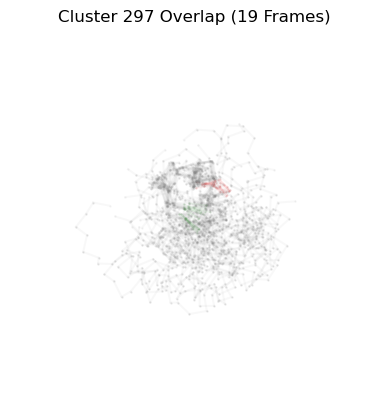

Aligning frames: 100%|█████████████████████████| 49/49 [00:00<00:00, 183.12it/s]


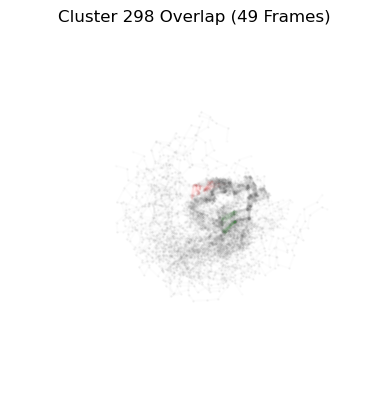

Aligning frames: 100%|█████████████████████████| 18/18 [00:00<00:00, 151.48it/s]


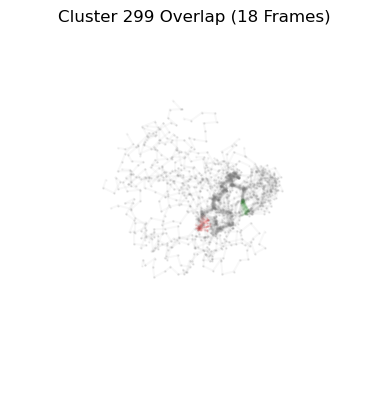

Aligning frames: 100%|█████████████████████████| 18/18 [00:00<00:00, 185.26it/s]


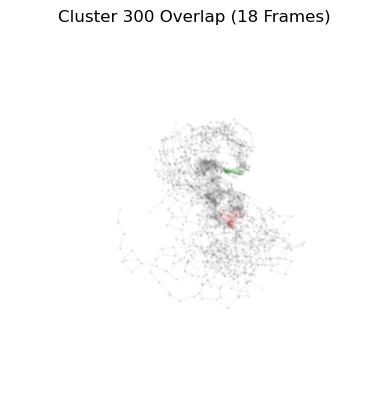

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 153.07it/s]


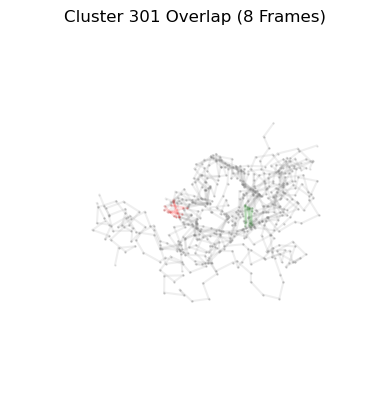

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 127.45it/s]


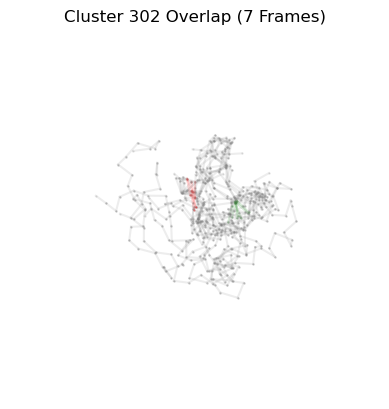

Aligning frames: 100%|██████████████████████████| 29/29 [00:00<00:00, 87.22it/s]


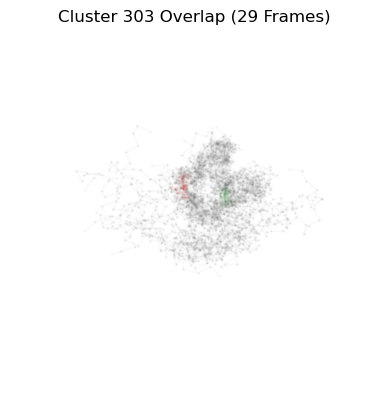

Aligning frames: 100%|█████████████████████████| 24/24 [00:00<00:00, 166.34it/s]


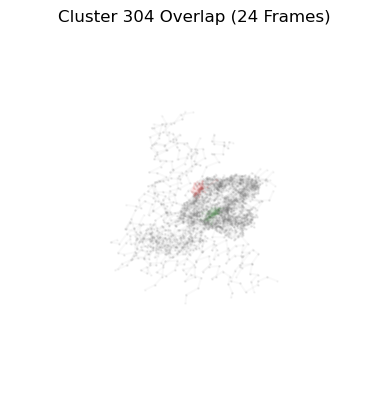

Aligning frames: 100%|██████████████████████████| 40/40 [00:00<00:00, 94.63it/s]


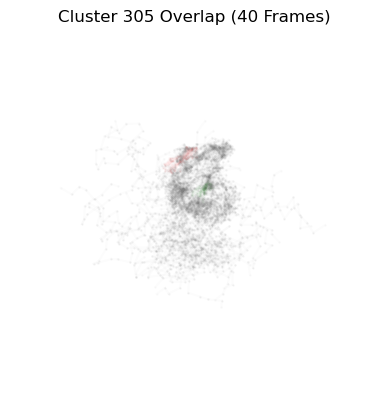

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 154.16it/s]


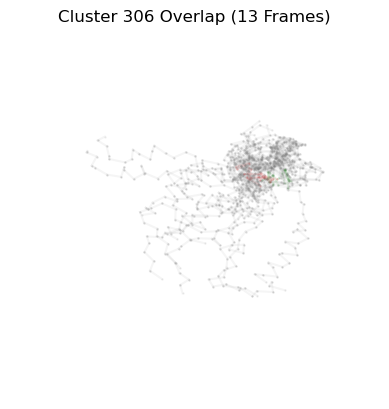

Aligning frames: 100%|██████████████████████████| 16/16 [00:00<00:00, 33.68it/s]


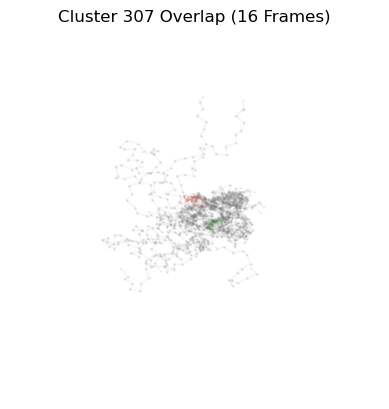

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 130.04it/s]


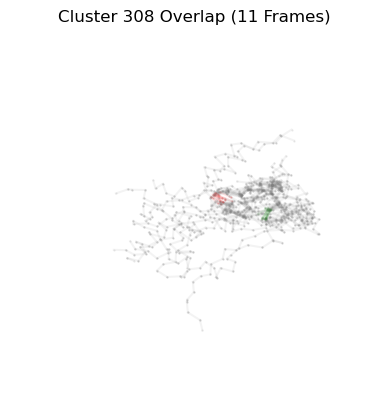

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 132.72it/s]


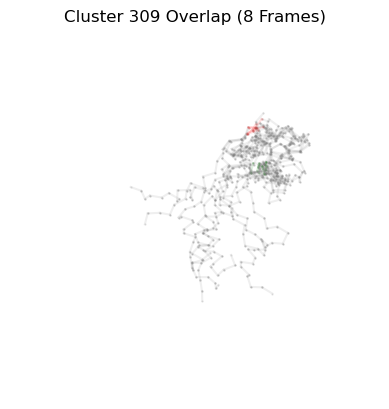

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 153.57it/s]


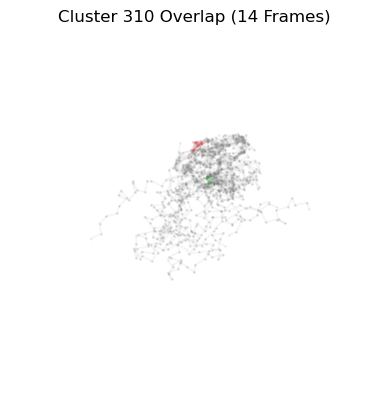

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 132.09it/s]


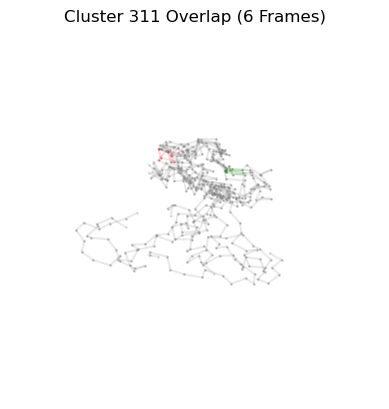

Aligning frames: 100%|█████████████████████████| 17/17 [00:00<00:00, 176.60it/s]


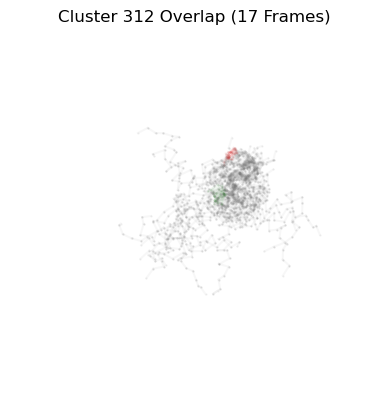

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 165.04it/s]


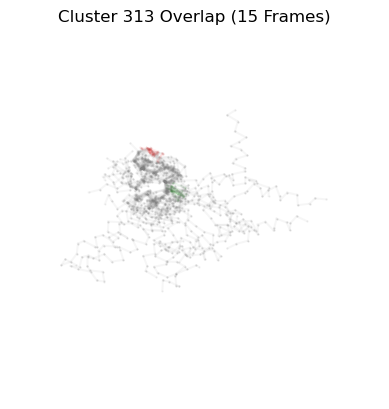

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 152.04it/s]


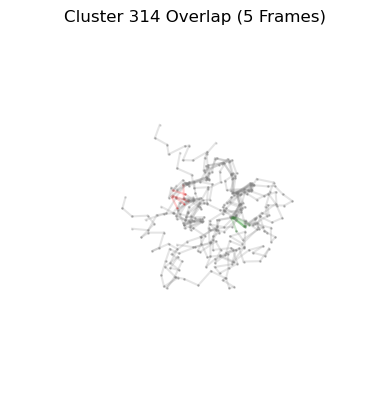

Aligning frames: 100%|██████████████████████████| 18/18 [00:00<00:00, 63.56it/s]


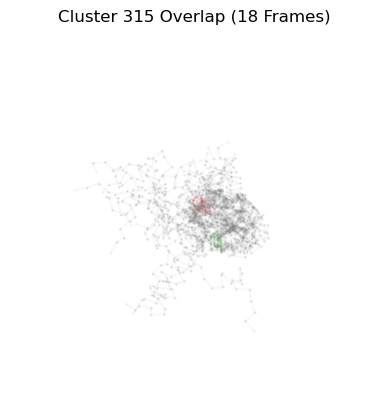

Aligning frames: 100%|███████████████████████████| 5/5 [00:00<00:00, 161.49it/s]


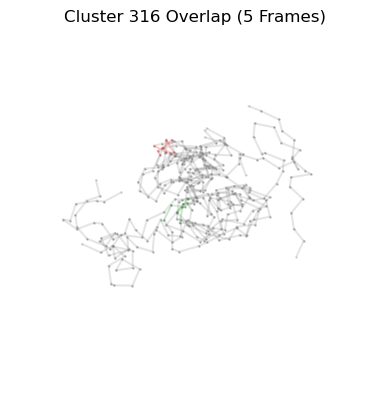

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 168.43it/s]


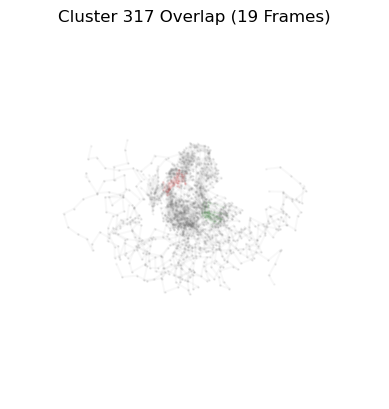

Aligning frames: 100%|█████████████████████████| 23/23 [00:00<00:00, 170.78it/s]


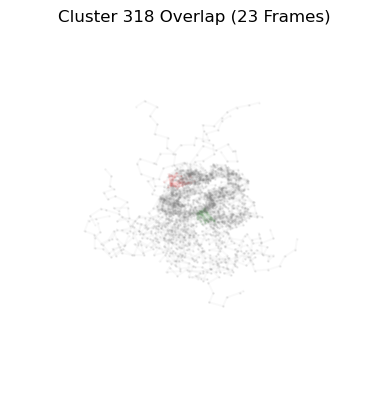

Aligning frames: 100%|██████████████████████████| 17/17 [00:00<00:00, 55.68it/s]


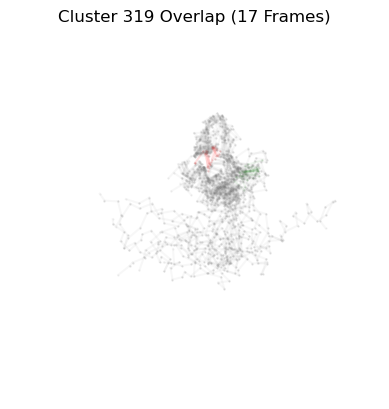

Aligning frames: 100%|██████████████████████████| 15/15 [00:00<00:00, 55.37it/s]


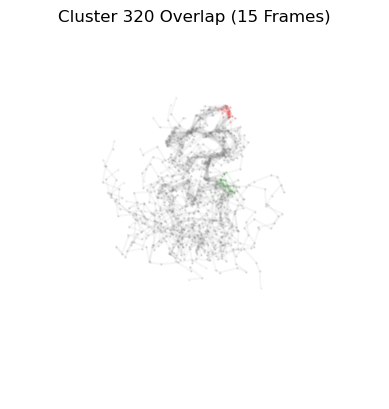

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 147.40it/s]


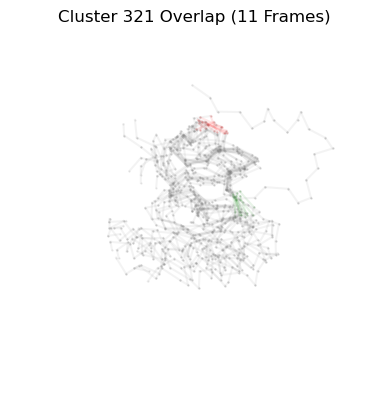

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 157.70it/s]


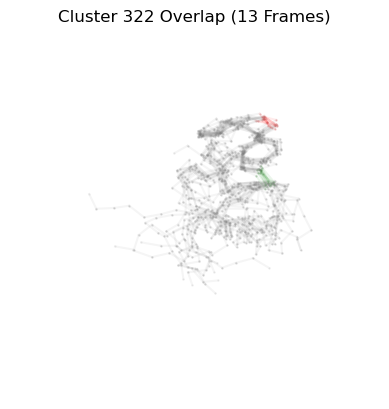

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 150.10it/s]


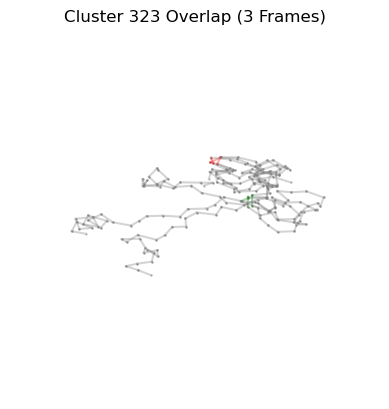

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 160.41it/s]


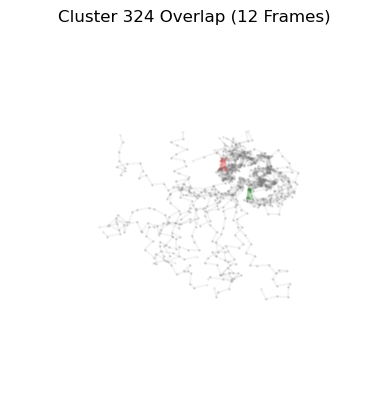

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 166.17it/s]


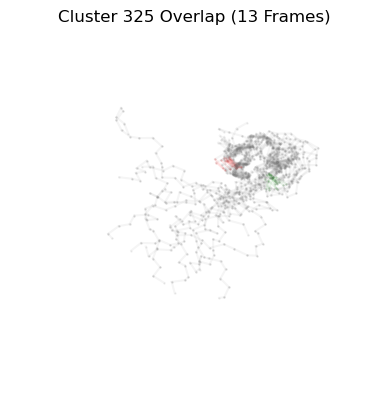

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 152.81it/s]


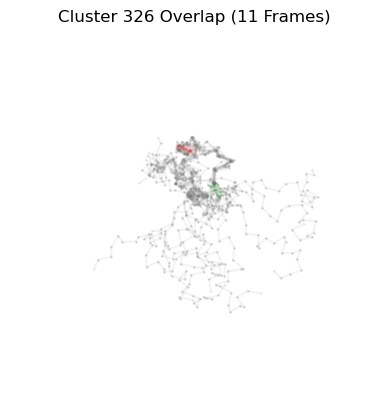

Aligning frames: 100%|██████████████████████████| 23/23 [00:00<00:00, 69.04it/s]


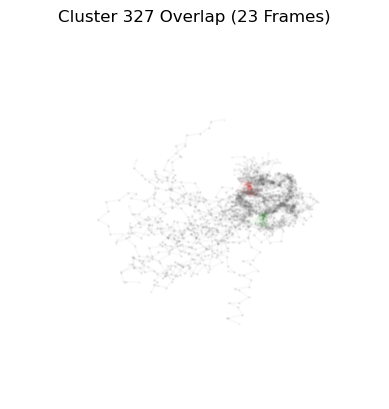

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 134.08it/s]


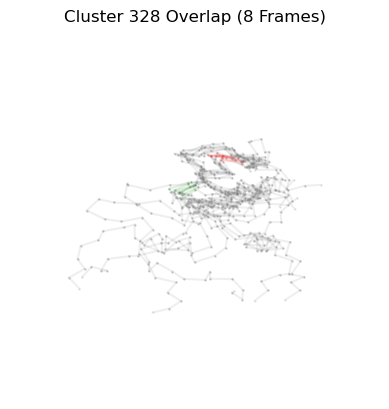

Aligning frames: 100%|██████████████████████████| 17/17 [00:00<00:00, 49.35it/s]


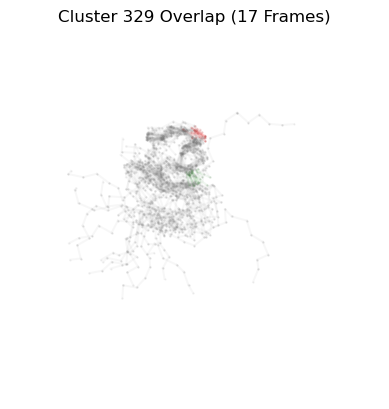

Aligning frames: 100%|██████████████████████████| 24/24 [00:00<00:00, 76.99it/s]


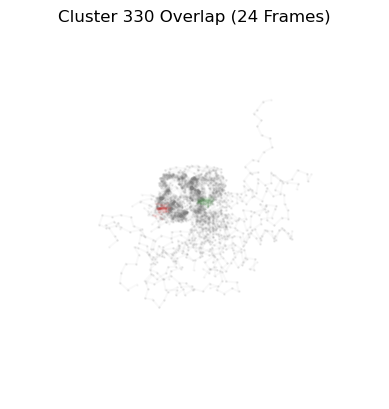

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 174.82it/s]


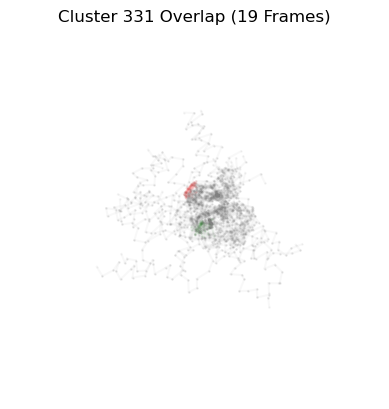

Aligning frames: 100%|█████████████████████████| 41/41 [00:00<00:00, 176.36it/s]


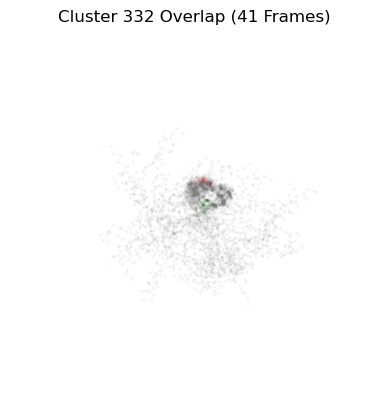

Aligning frames: 100%|██████████████████████████| 67/67 [00:00<00:00, 86.97it/s]


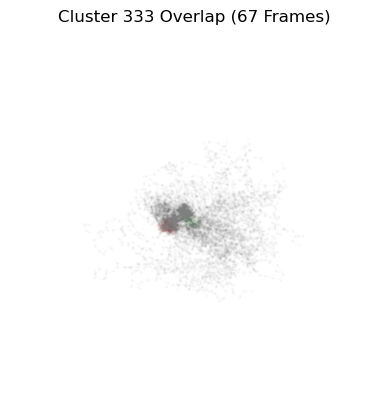

Aligning frames: 100%|███████████████████████| 103/103 [00:00<00:00, 190.65it/s]


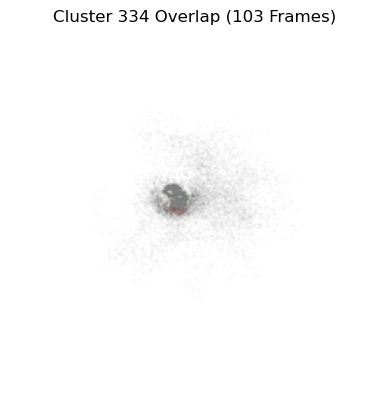

Aligning frames: 100%|██████████████████████████| 89/89 [00:01<00:00, 83.21it/s]


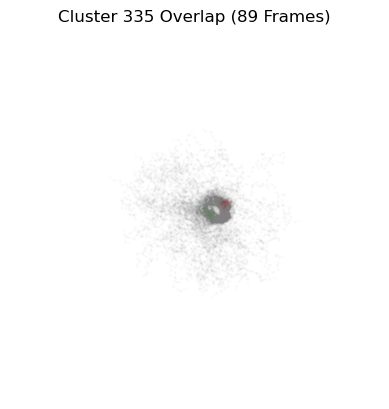

Aligning frames: 100%|██████████████████████████| 96/96 [00:01<00:00, 90.59it/s]


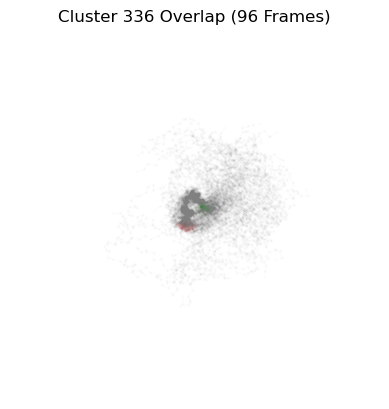

Aligning frames: 100%|███████████████████████| 110/110 [00:00<00:00, 185.89it/s]


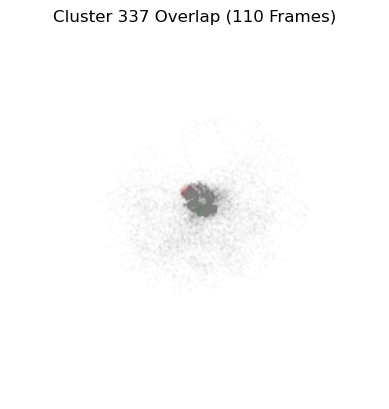

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 152.44it/s]


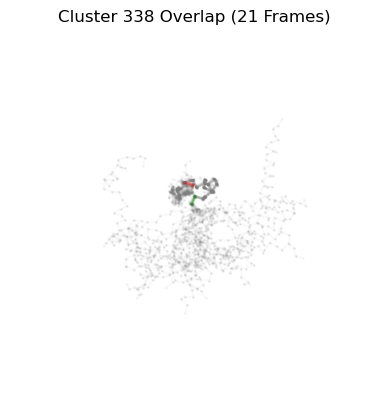

Aligning frames: 100%|███████████████████████| 104/104 [00:00<00:00, 192.09it/s]


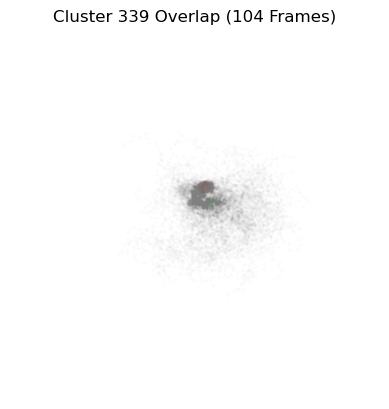

Aligning frames: 100%|█████████████████████████| 72/72 [00:00<00:00, 194.29it/s]


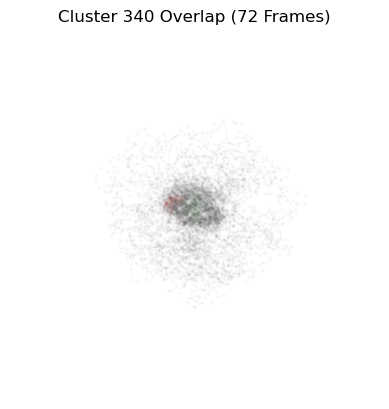

Aligning frames: 100%|███████████████████████| 123/123 [00:00<00:00, 195.31it/s]


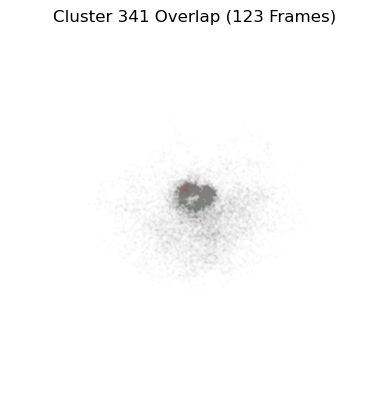

Aligning frames: 100%|█████████████████████████| 83/83 [00:00<00:00, 183.48it/s]


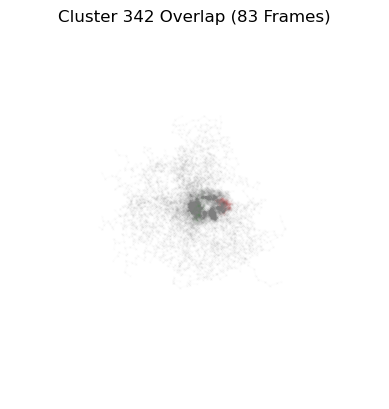

Aligning frames: 100%|█████████████████████████| 83/83 [00:00<00:00, 181.04it/s]


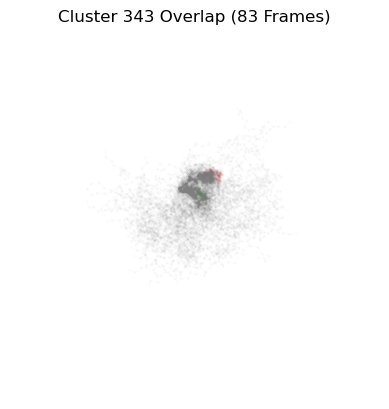

Aligning frames: 100%|██████████████████████████| 80/80 [00:00<00:00, 83.69it/s]


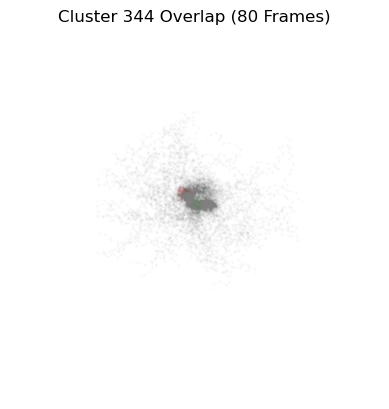

Aligning frames: 100%|██████████████████████████| 74/74 [00:00<00:00, 81.38it/s]


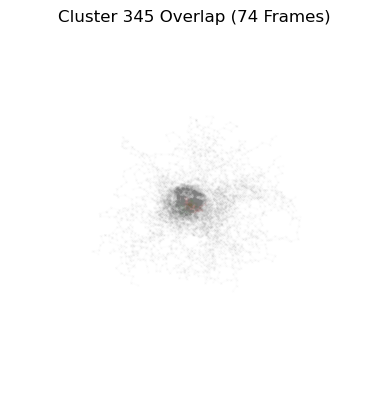

Aligning frames: 100%|█████████████████████████| 52/52 [00:00<00:00, 181.87it/s]


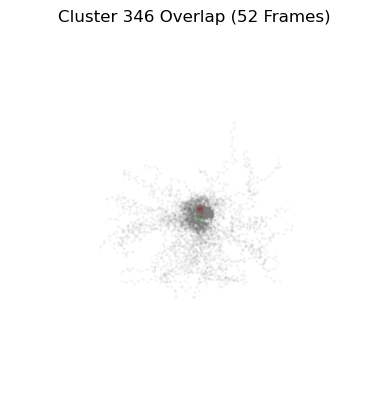

Aligning frames: 100%|█████████████████████████| 30/30 [00:00<00:00, 158.96it/s]


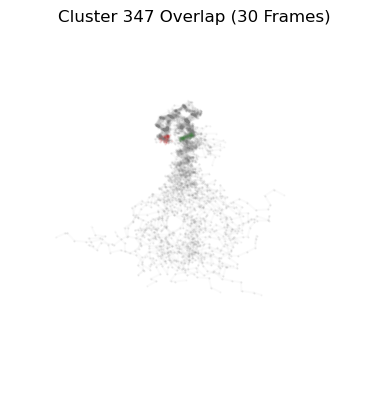

Aligning frames: 100%|█████████████████████████| 77/77 [00:00<00:00, 120.49it/s]


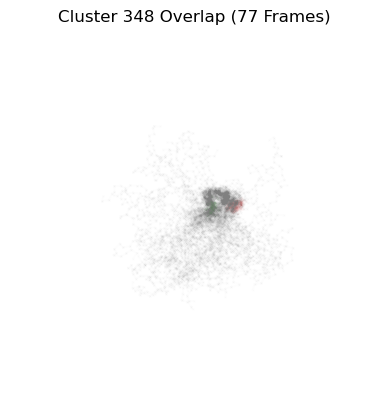

Aligning frames: 100%|██████████████████████████| 45/45 [00:00<00:00, 59.67it/s]


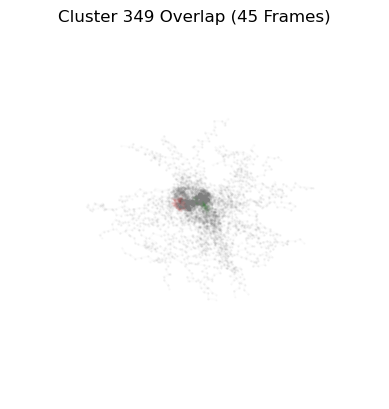

Aligning frames: 100%|█████████████████████████| 75/75 [00:00<00:00, 190.69it/s]


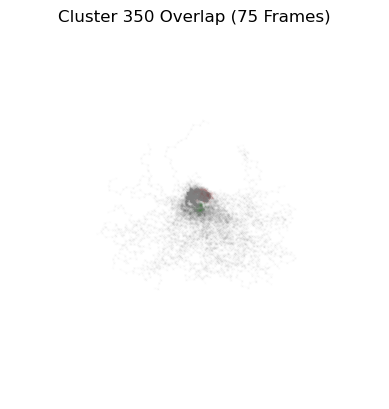

Aligning frames: 100%|████████████████████████| 112/112 [00:01<00:00, 98.80it/s]


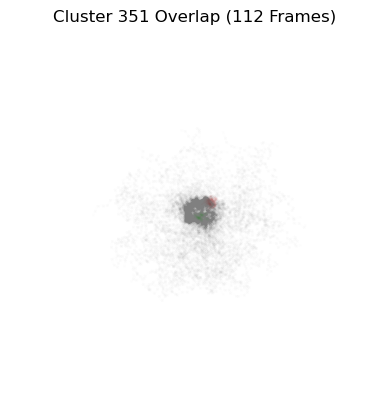

Aligning frames: 100%|██████████████████████████| 18/18 [00:00<00:00, 23.00it/s]


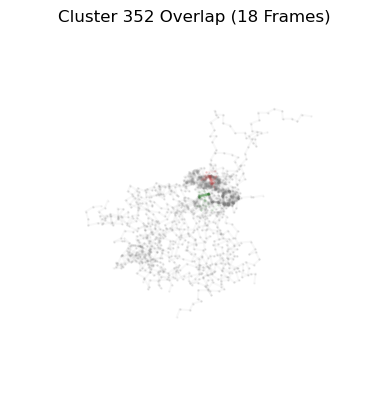

Aligning frames: 100%|█████████████████████████| 91/91 [00:00<00:00, 185.09it/s]


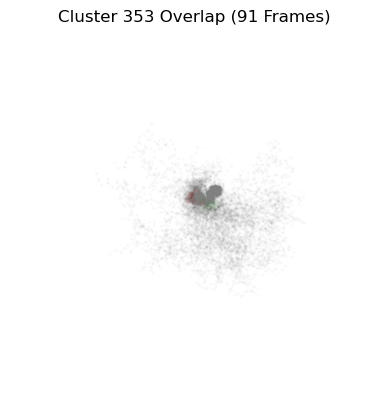

Aligning frames: 100%|█████████████████████████| 50/50 [00:00<00:00, 187.78it/s]


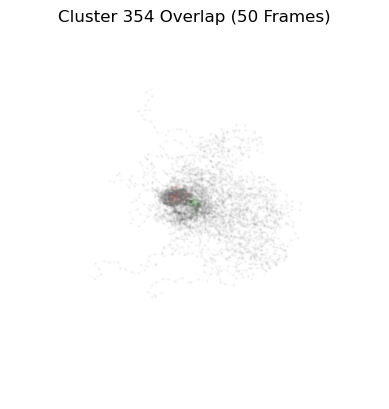

Aligning frames: 100%|█████████████████████████| 87/87 [00:00<00:00, 189.28it/s]


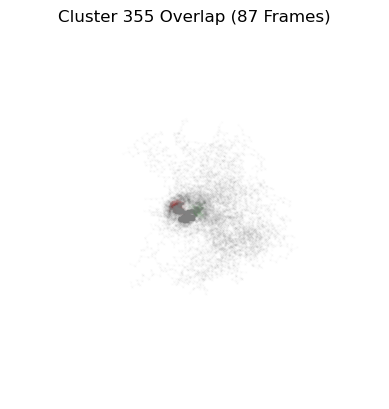

Aligning frames: 100%|█████████████████████████| 73/73 [00:00<00:00, 172.90it/s]


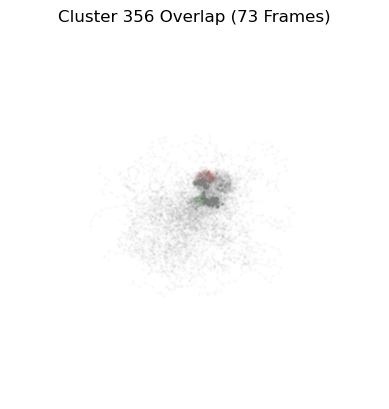

Aligning frames: 100%|███████████████████████| 118/118 [00:01<00:00, 107.50it/s]


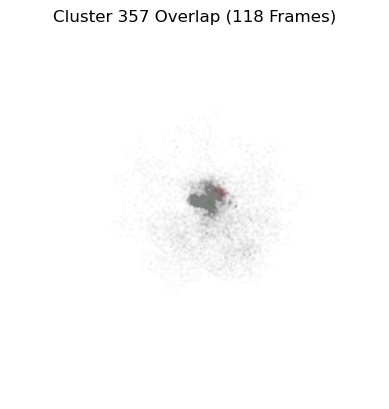

Aligning frames: 100%|████████████████████████████| 3/3 [00:00<00:00,  4.07it/s]


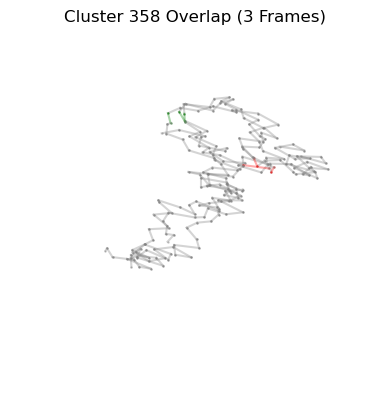

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 161.77it/s]


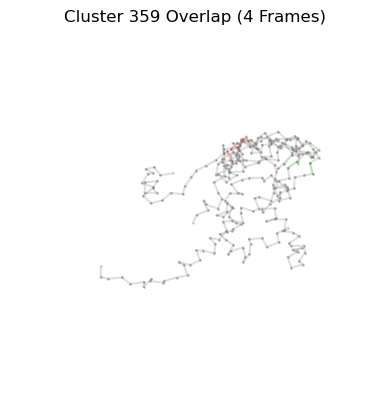

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 167.27it/s]


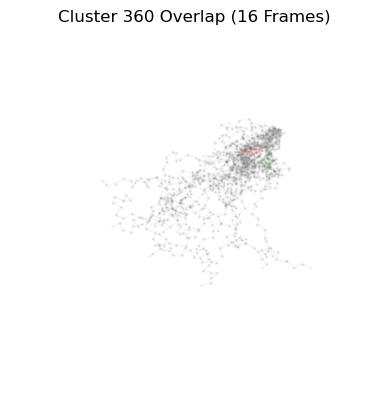

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 192.99it/s]


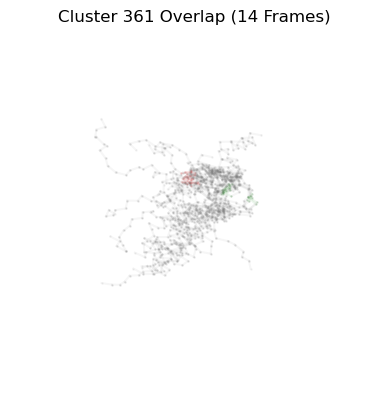

Aligning frames: 100%|█████████████████████████| 34/34 [00:00<00:00, 170.97it/s]


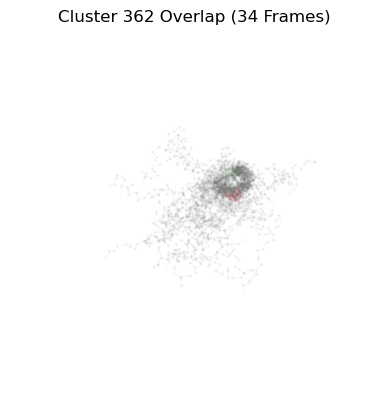

Aligning frames: 100%|█████████████████████████| 39/39 [00:00<00:00, 176.24it/s]


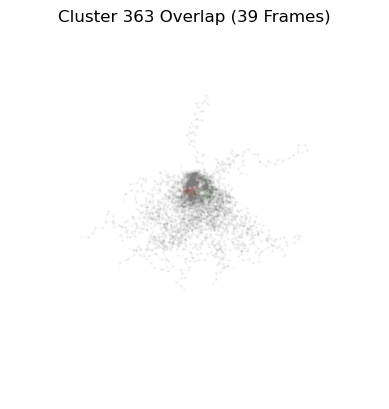

Aligning frames: 100%|███████████████████████| 106/106 [00:00<00:00, 174.50it/s]


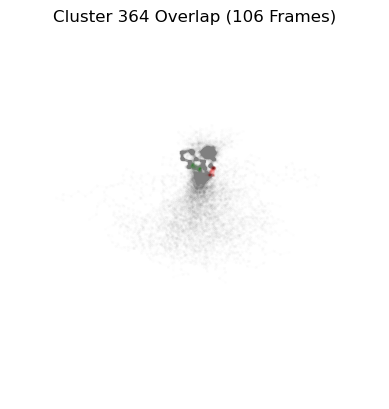

Aligning frames: 100%|██████████████████████████| 52/52 [00:00<00:00, 55.14it/s]


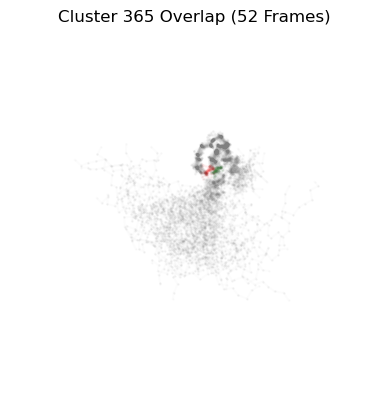

Aligning frames: 100%|██████████████████████████| 72/72 [00:00<00:00, 96.87it/s]


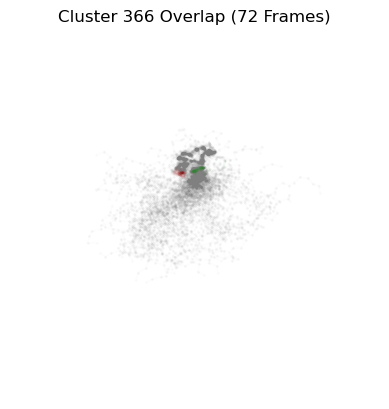

Aligning frames: 100%|█████████████████████████| 42/42 [00:00<00:00, 174.83it/s]


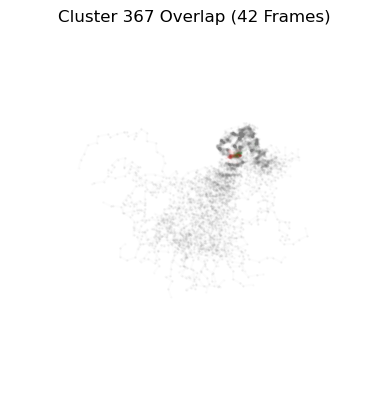

Aligning frames: 100%|█████████████████████████| 69/69 [00:00<00:00, 101.56it/s]


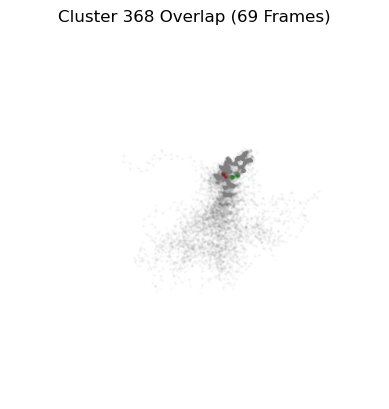

Aligning frames: 100%|█████████████████████████| 69/69 [00:00<00:00, 180.95it/s]


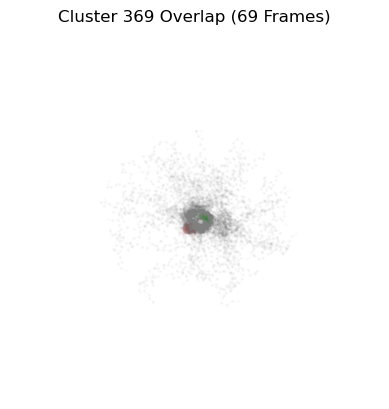

Aligning frames: 100%|██████████████████████████| 95/95 [00:00<00:00, 99.08it/s]


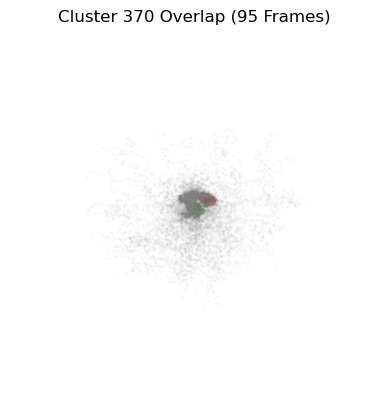

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 122.15it/s]


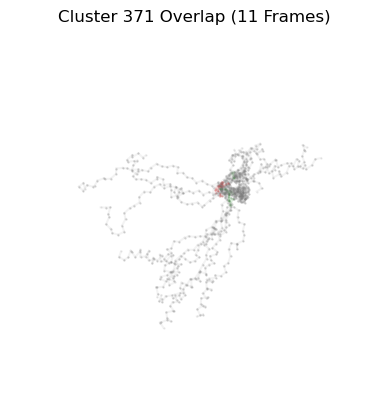

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 146.57it/s]


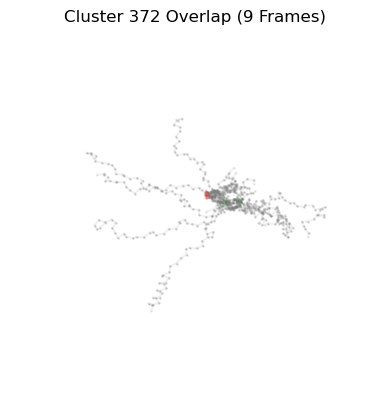

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 180.58it/s]


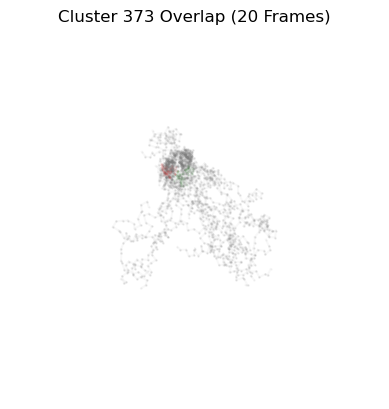

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 157.76it/s]


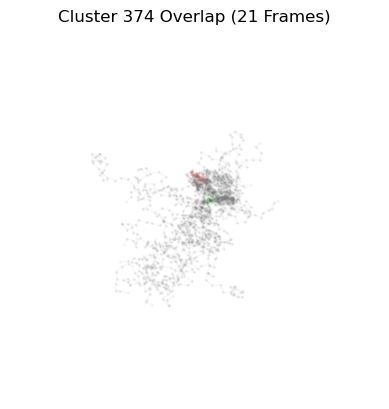

Aligning frames: 100%|██████████████████████████| 35/35 [00:00<00:00, 93.19it/s]


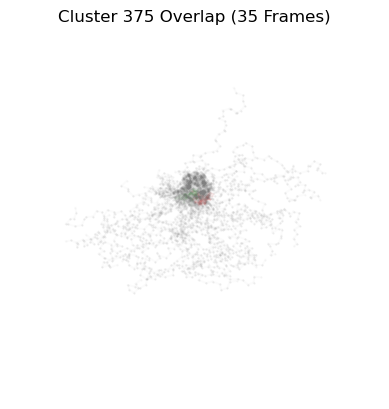

Aligning frames: 100%|██████████████████████████| 14/14 [00:00<00:00, 38.22it/s]


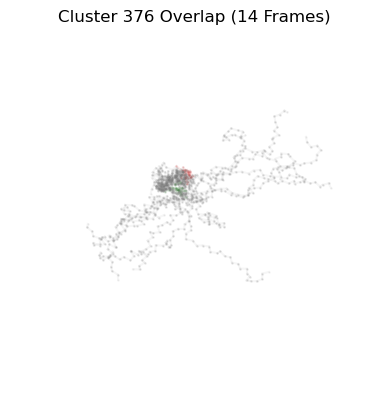

Aligning frames: 100%|██████████████████████████| 24/24 [00:00<00:00, 75.47it/s]


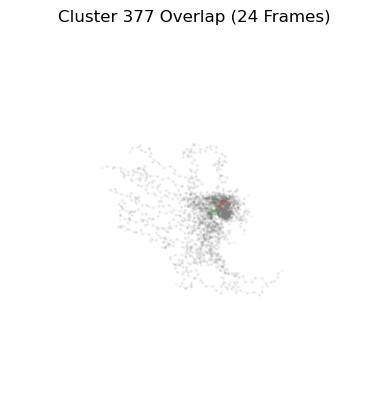

Aligning frames: 100%|█████████████████████████| 30/30 [00:00<00:00, 168.09it/s]


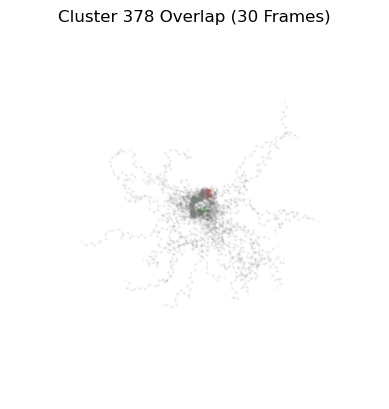

Aligning frames: 100%|█████████████████████████| 47/47 [00:00<00:00, 175.65it/s]


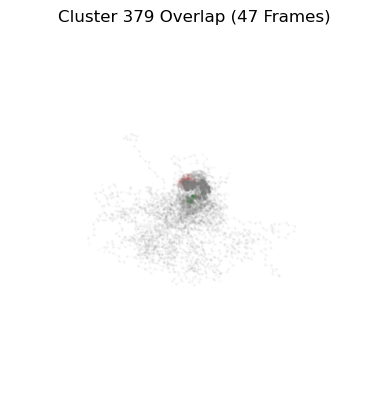

Aligning frames: 100%|█████████████████████████| 46/46 [00:00<00:00, 189.65it/s]


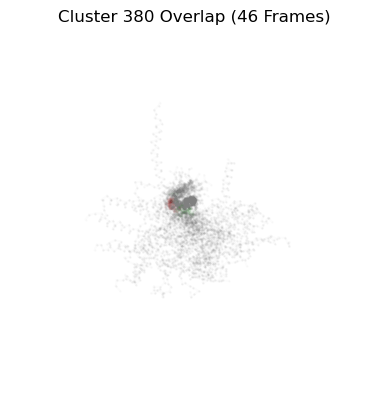

Aligning frames: 100%|█████████████████████████| 57/57 [00:00<00:00, 167.86it/s]


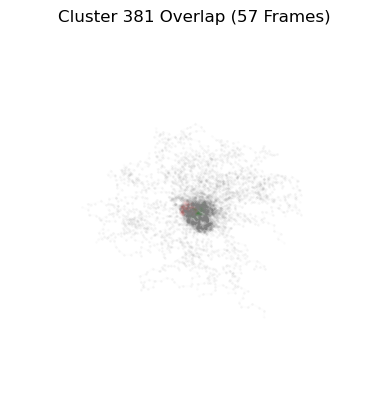

Aligning frames: 100%|█████████████████████████| 27/27 [00:00<00:00, 146.87it/s]


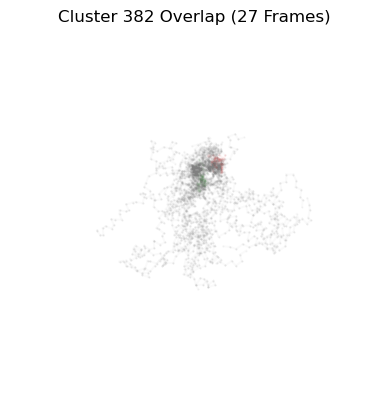

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 180.63it/s]


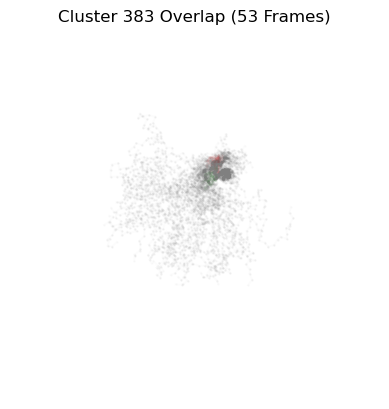

Aligning frames: 100%|████████████████████████████| 8/8 [00:00<00:00, 17.18it/s]


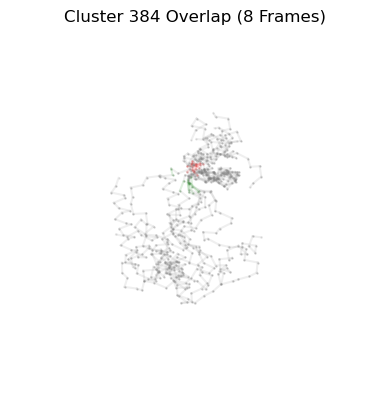

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 184.53it/s]


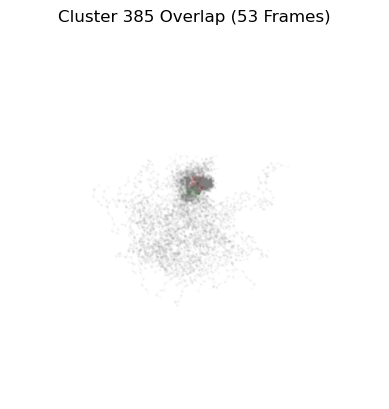

Aligning frames: 100%|███████████████████████████| 7/7 [00:00<00:00, 135.27it/s]


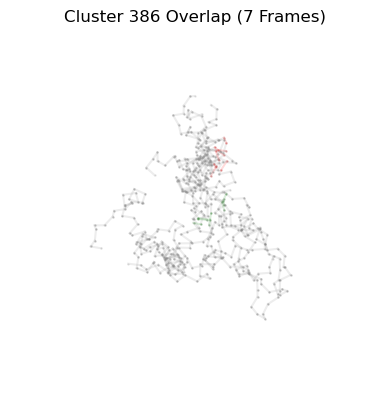

Aligning frames: 100%|█████████████████████████| 22/22 [00:00<00:00, 172.63it/s]


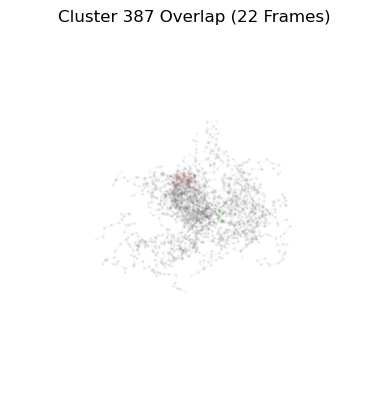

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 155.54it/s]


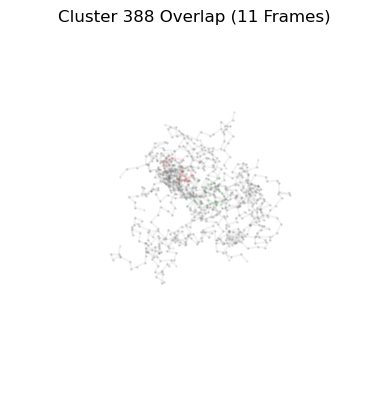

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 146.81it/s]


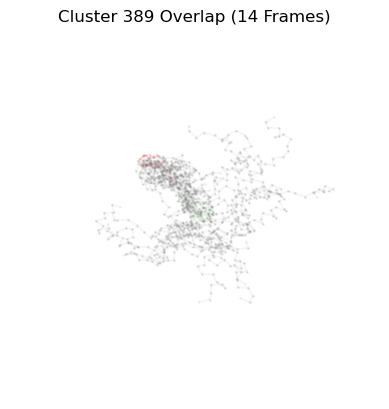

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 154.92it/s]


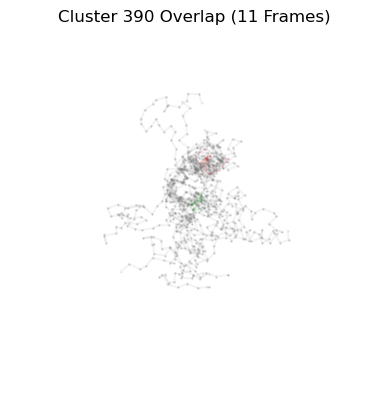

Aligning frames: 100%|█████████████████████████| 19/19 [00:00<00:00, 174.95it/s]


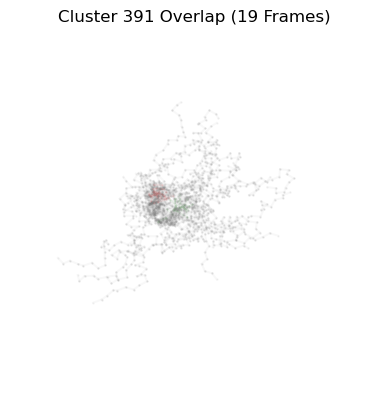

Aligning frames: 100%|█████████████████████████| 20/20 [00:00<00:00, 174.53it/s]


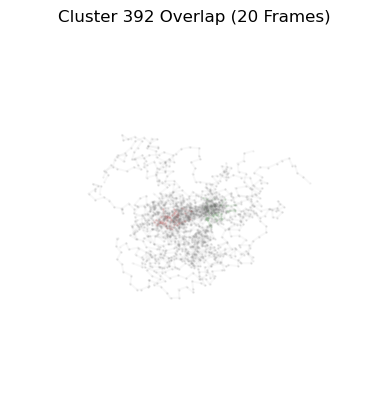

Aligning frames: 100%|█████████████████████████| 18/18 [00:00<00:00, 195.69it/s]


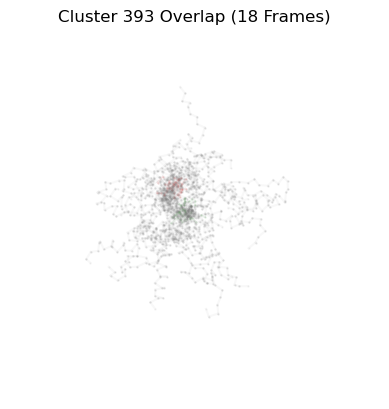

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 147.67it/s]


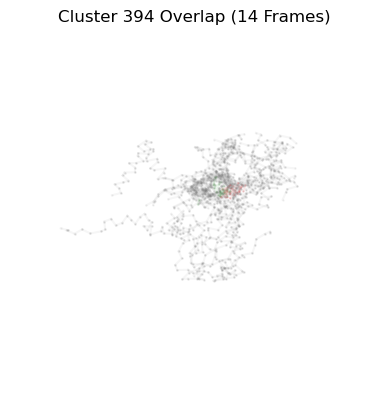

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 159.73it/s]


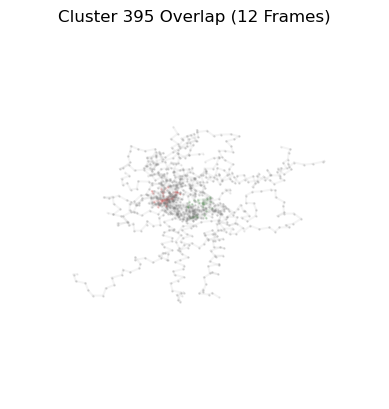

Aligning frames: 100%|███████████████████████████| 2/2 [00:00<00:00, 167.35it/s]


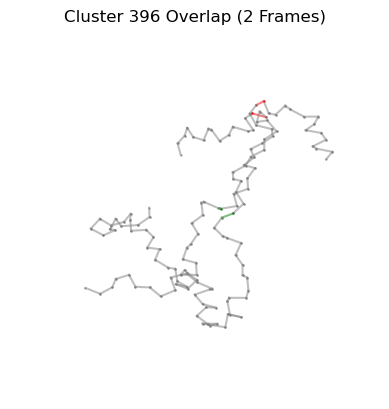

Aligning frames: 100%|███████████████████████████| 3/3 [00:00<00:00, 133.66it/s]


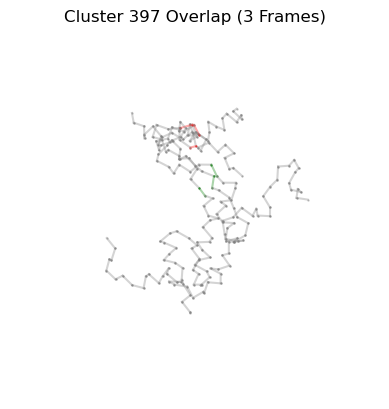

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 138.39it/s]


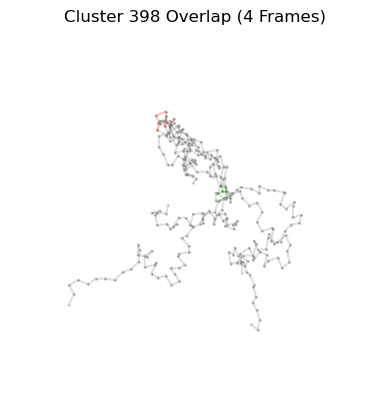

Aligning frames: 100%|███████████████████████████| 4/4 [00:00<00:00, 143.83it/s]


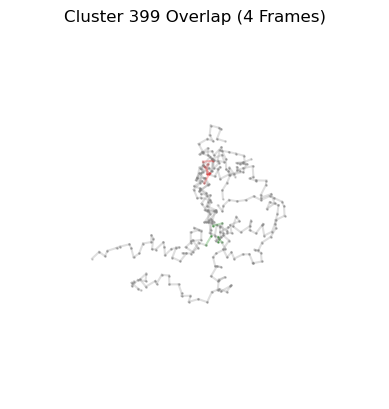

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 127.72it/s]


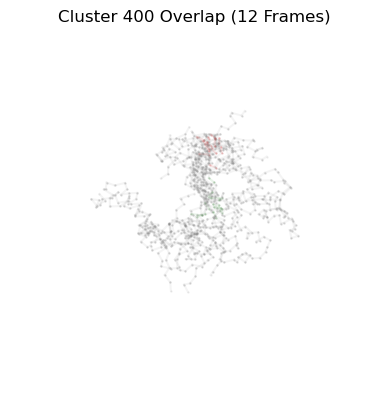

Aligning frames: 100%|███████████████████████████| 9/9 [00:00<00:00, 117.21it/s]


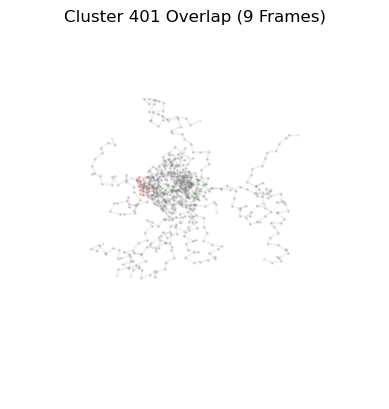

Aligning frames: 100%|█████████████████████████| 11/11 [00:00<00:00, 151.04it/s]


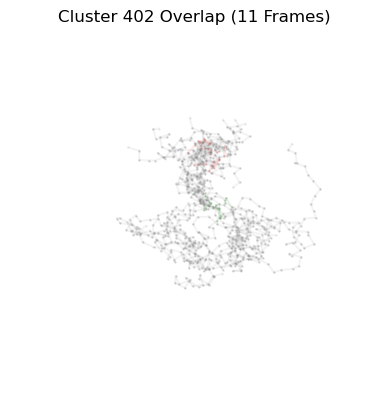

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 164.40it/s]


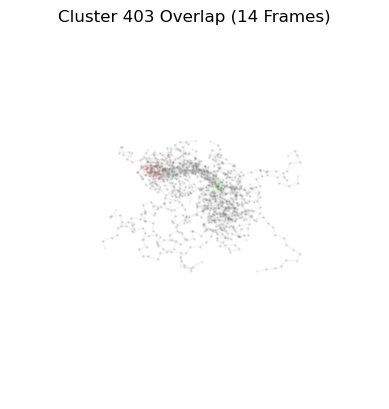

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 156.93it/s]


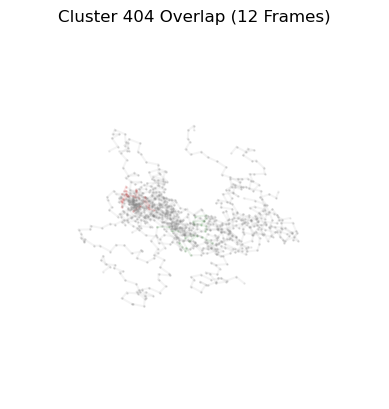

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 163.32it/s]


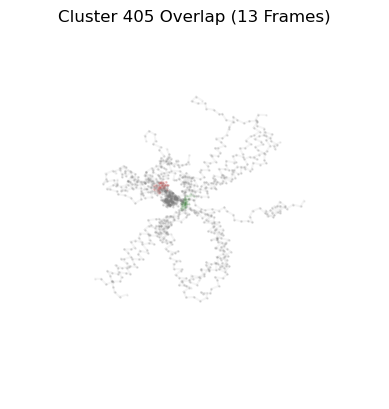

Aligning frames: 100%|███████████████████████████| 6/6 [00:00<00:00, 188.23it/s]


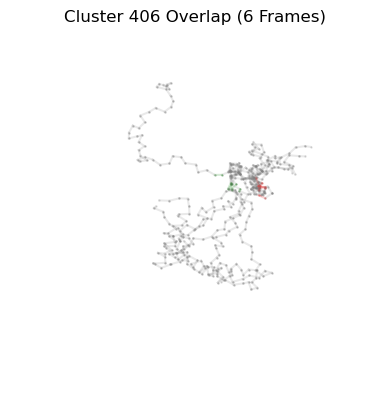

Aligning frames: 100%|█████████████████████████| 12/12 [00:00<00:00, 160.69it/s]


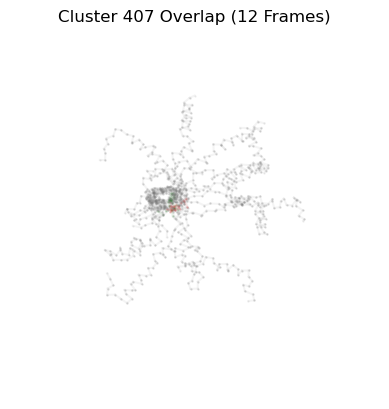

Aligning frames: 100%|█████████████████████████| 23/23 [00:00<00:00, 170.25it/s]


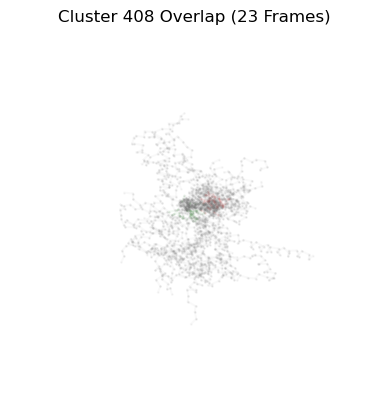

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 155.48it/s]


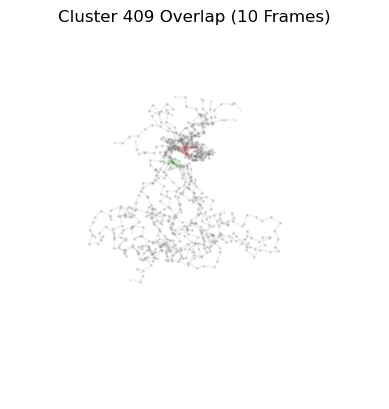

Aligning frames: 100%|█████████████████████████| 10/10 [00:00<00:00, 153.89it/s]


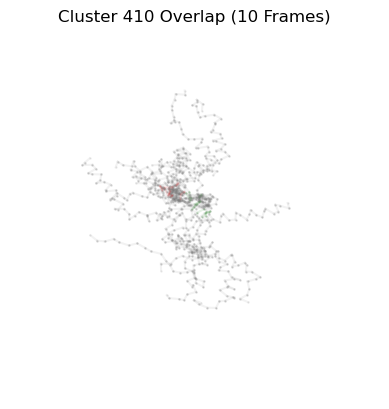

Aligning frames: 100%|█████████████████████████| 59/59 [00:00<00:00, 191.94it/s]


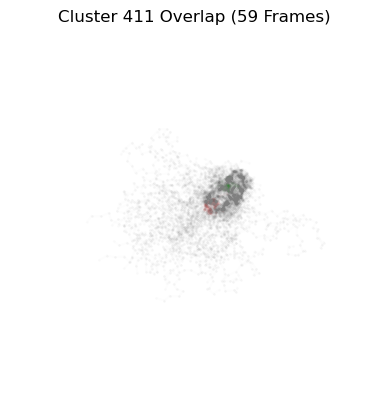

Aligning frames: 100%|█████████████████████████| 44/44 [00:00<00:00, 176.02it/s]


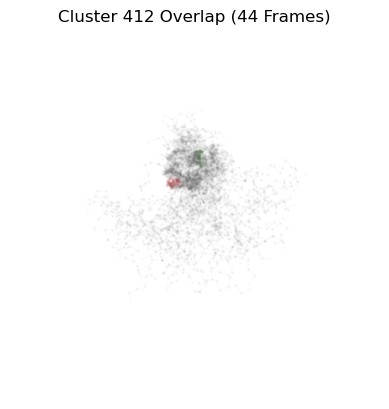

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 185.77it/s]


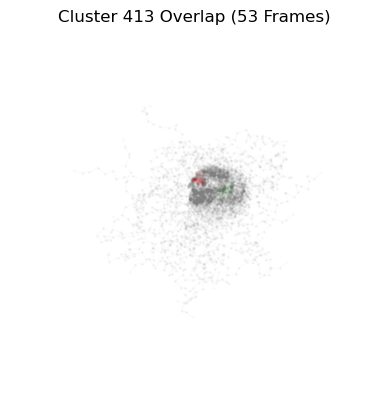

Aligning frames: 100%|█████████████████████████| 14/14 [00:00<00:00, 166.78it/s]


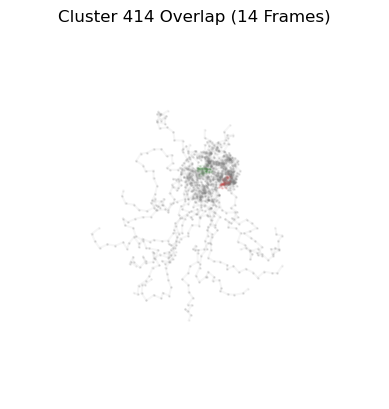

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 112.95it/s]


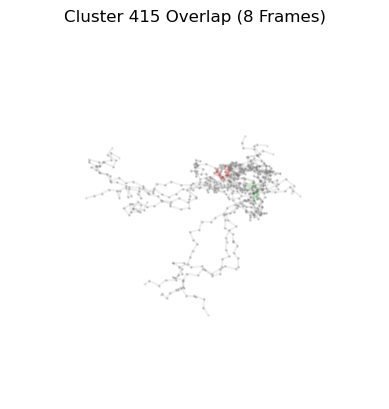

Aligning frames: 100%|█████████████████████████| 21/21 [00:00<00:00, 171.63it/s]


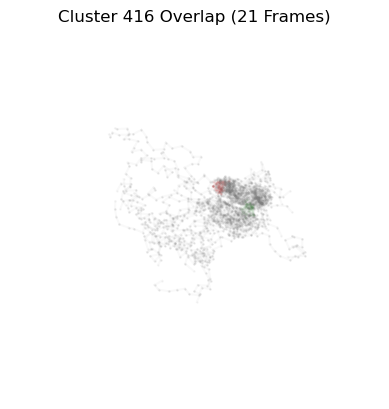

Aligning frames: 100%|█████████████████████████| 29/29 [00:00<00:00, 160.02it/s]


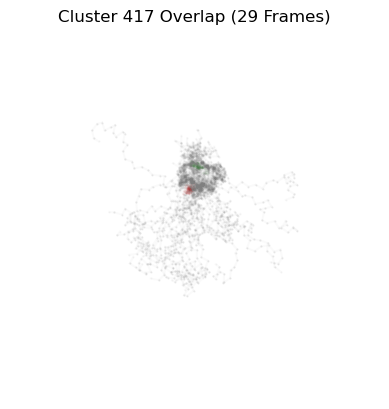

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 161.25it/s]


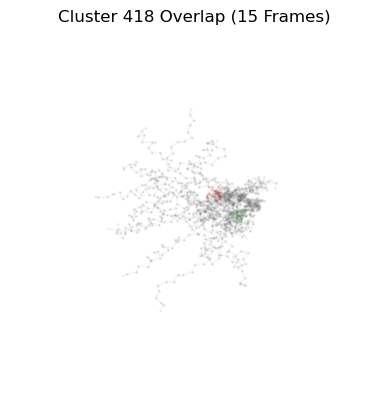

Aligning frames: 100%|██████████████████████████| 17/17 [00:00<00:00, 38.95it/s]


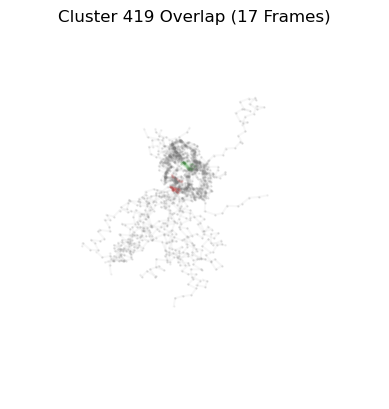

Aligning frames: 100%|█████████████████████████| 64/64 [00:00<00:00, 182.66it/s]


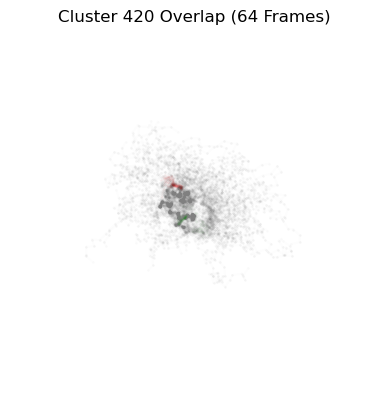

Aligning frames: 100%|█████████████████████████| 73/73 [00:00<00:00, 186.89it/s]


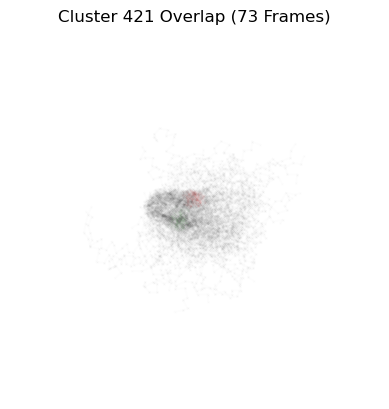

Aligning frames: 100%|███████████████████████| 100/100 [00:00<00:00, 193.99it/s]


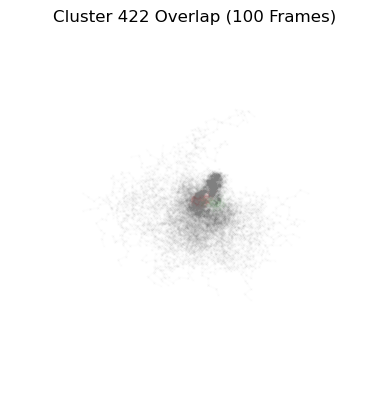

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 179.42it/s]


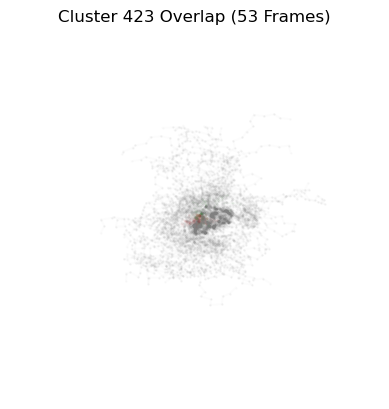

Aligning frames: 100%|█████████████████████████| 72/72 [00:00<00:00, 185.86it/s]


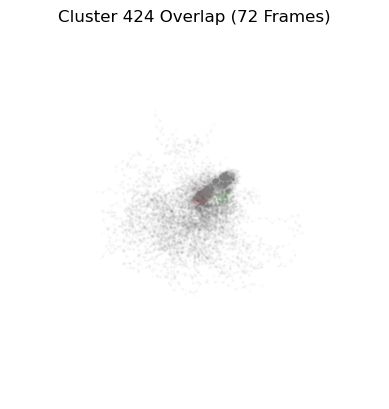

Aligning frames: 100%|█████████████████████████| 93/93 [00:00<00:00, 189.52it/s]


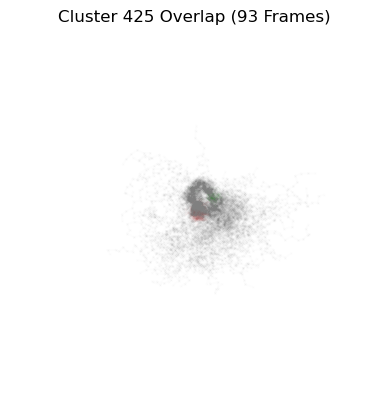

Aligning frames: 100%|█████████████████████████| 13/13 [00:00<00:00, 121.64it/s]


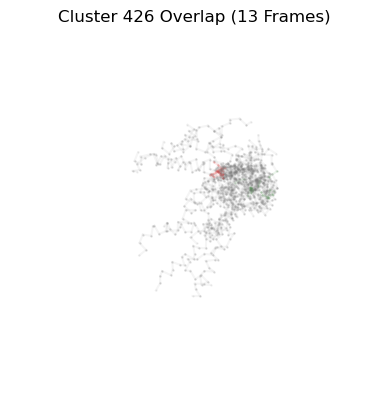

Aligning frames: 100%|█████████████████████████| 46/46 [00:00<00:00, 187.24it/s]


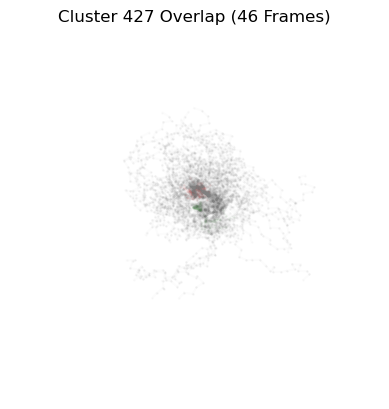

Aligning frames: 100%|█████████████████████████| 31/31 [00:00<00:00, 192.18it/s]


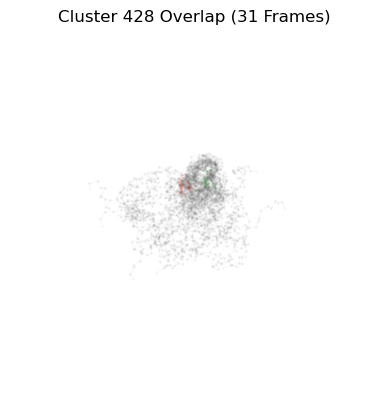

Aligning frames: 100%|█████████████████████████| 52/52 [00:00<00:00, 193.38it/s]


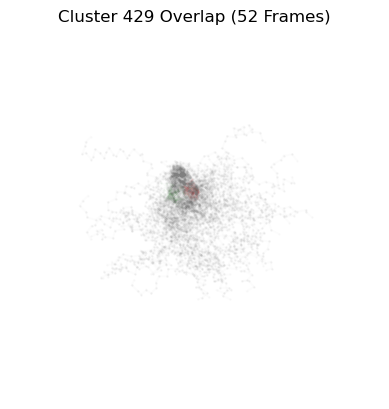

Aligning frames: 100%|█████████████████████████| 40/40 [00:00<00:00, 145.12it/s]


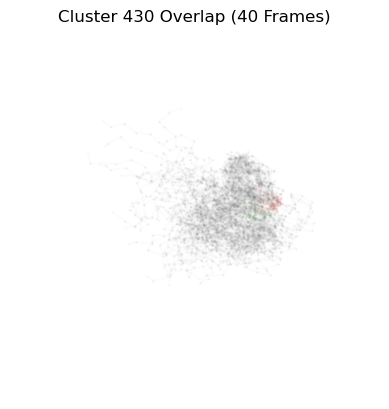

Aligning frames: 100%|█████████████████████████| 16/16 [00:00<00:00, 143.02it/s]


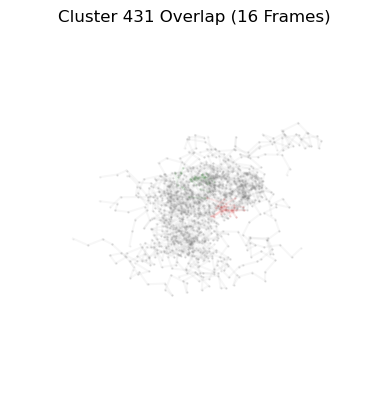

Aligning frames: 100%|██████████████████████████| 50/50 [00:00<00:00, 75.97it/s]


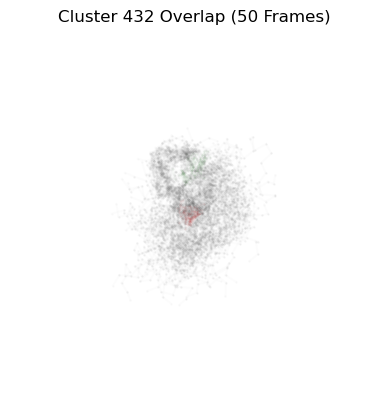

Aligning frames: 100%|██████████████████████████| 52/52 [00:00<00:00, 84.11it/s]


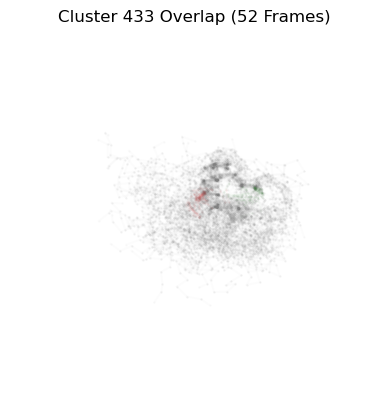

Aligning frames: 100%|██████████████████████████| 53/53 [00:00<00:00, 82.61it/s]


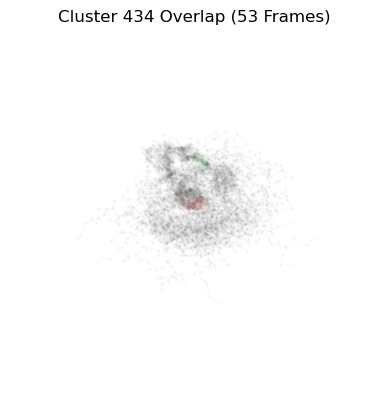

Aligning frames: 100%|██████████████████████████| 95/95 [00:01<00:00, 78.22it/s]


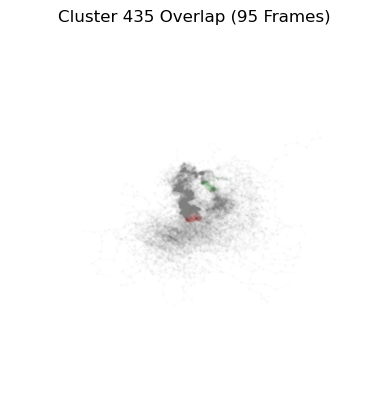

Aligning frames: 100%|█████████████████████████| 80/80 [00:00<00:00, 121.73it/s]


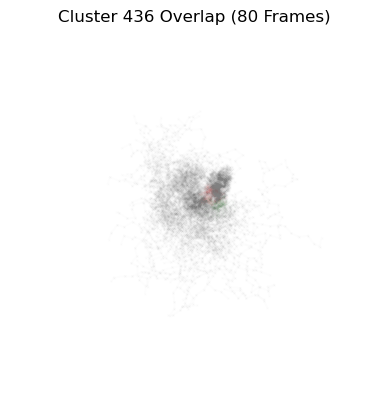

Aligning frames: 100%|██████████████████████████| 70/70 [00:00<00:00, 70.72it/s]


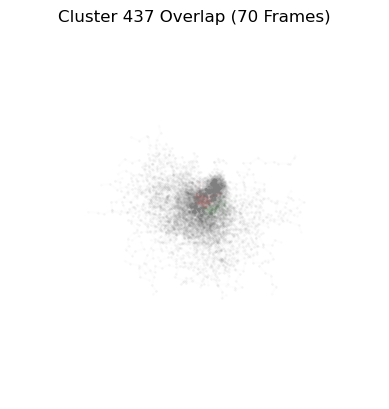

Aligning frames: 100%|█████████████████████████| 28/28 [00:00<00:00, 146.38it/s]


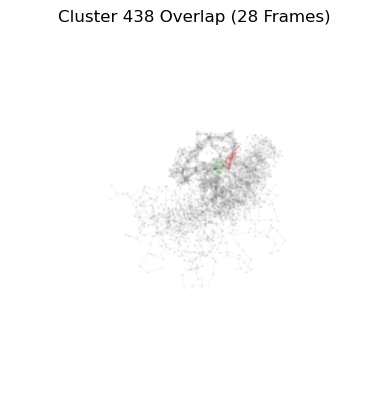

Aligning frames: 100%|█████████████████████████| 78/78 [00:00<00:00, 187.37it/s]


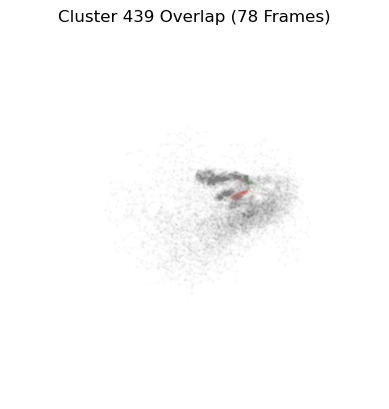

Aligning frames: 100%|█████████████████████████| 65/65 [00:00<00:00, 180.67it/s]


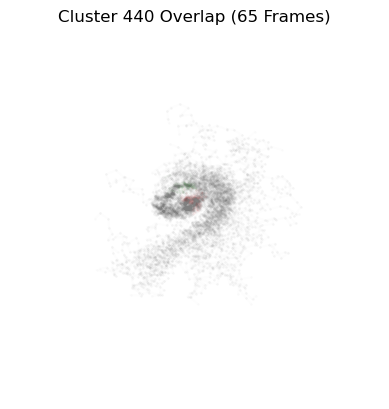

Aligning frames: 100%|█████████████████████████| 52/52 [00:00<00:00, 173.87it/s]


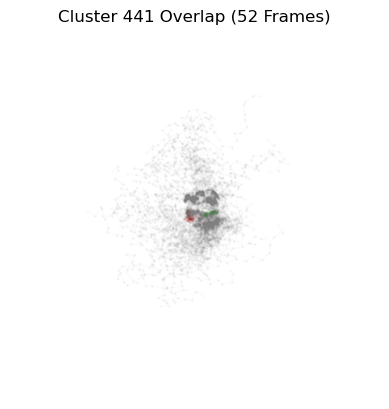

Aligning frames: 100%|█████████████████████████| 78/78 [00:00<00:00, 177.10it/s]


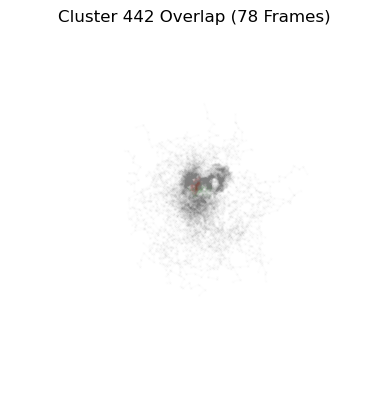

Aligning frames: 100%|█████████████████████████| 62/62 [00:00<00:00, 184.01it/s]


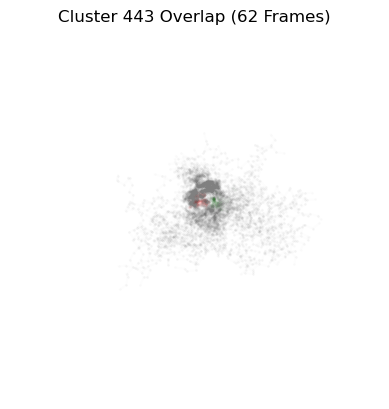

Aligning frames: 100%|██████████████████████████| 42/42 [00:00<00:00, 62.94it/s]


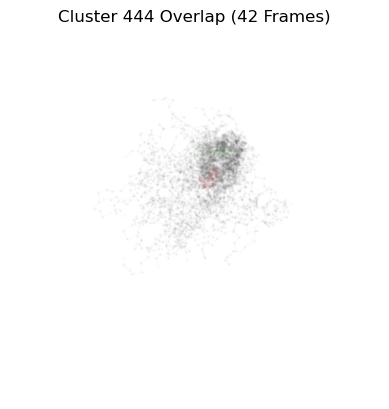

Aligning frames: 100%|█████████████████████████| 29/29 [00:00<00:00, 161.21it/s]


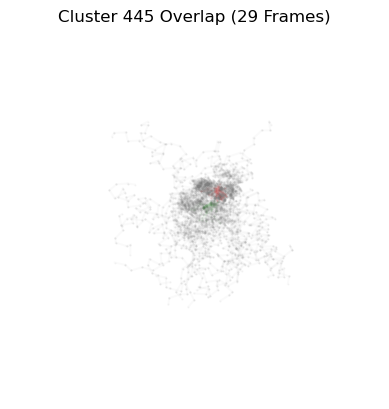

Aligning frames: 100%|█████████████████████████| 73/73 [00:00<00:00, 119.13it/s]


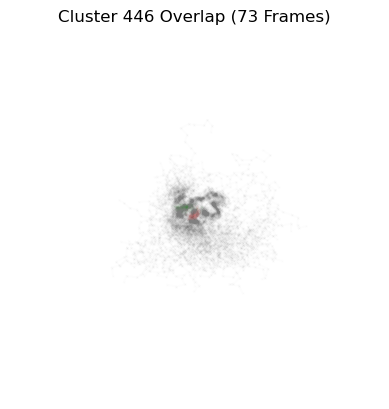

Aligning frames: 100%|████████████████████████████| 8/8 [00:00<00:00, 84.63it/s]


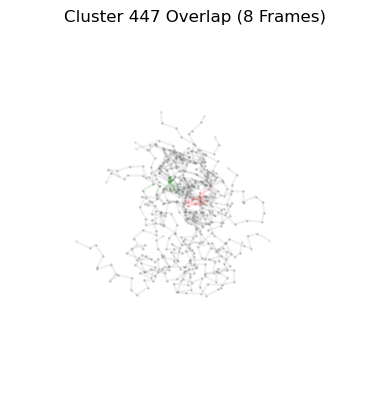

Aligning frames: 100%|███████████████████████████| 8/8 [00:00<00:00, 145.13it/s]


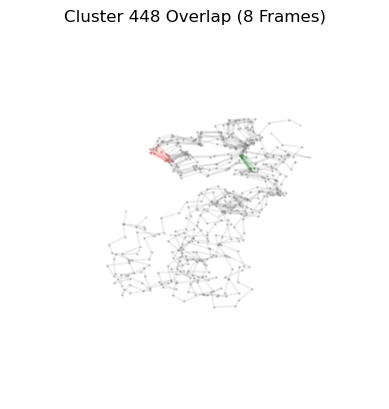

Aligning frames: 100%|█████████████████████████| 37/37 [00:00<00:00, 176.80it/s]


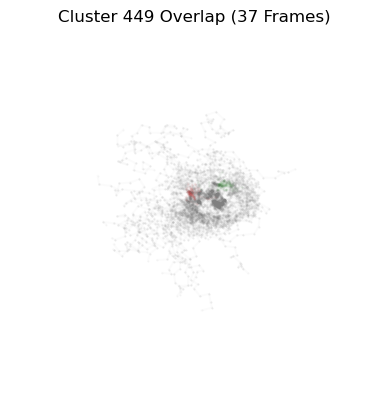

Aligning frames: 100%|█████████████████████████| 58/58 [00:00<00:00, 177.90it/s]


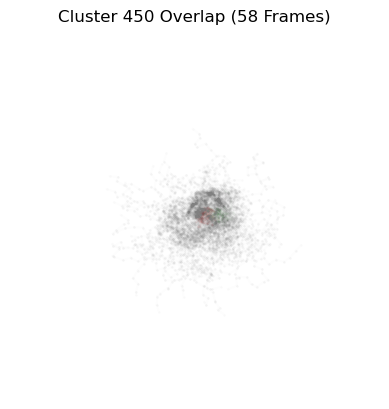

Aligning frames: 100%|█████████████████████████| 61/61 [00:00<00:00, 175.71it/s]


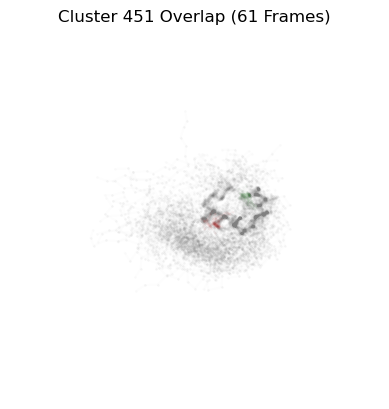

Aligning frames: 100%|█████████████████████████| 27/27 [00:00<00:00, 160.68it/s]


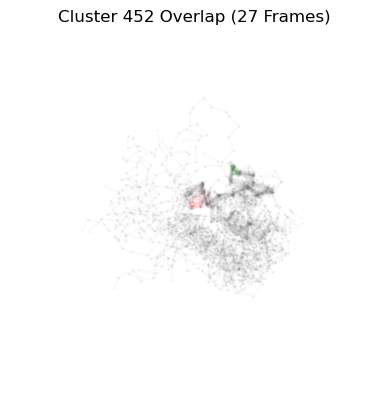

Aligning frames: 100%|█████████████████████████| 88/88 [00:00<00:00, 185.99it/s]


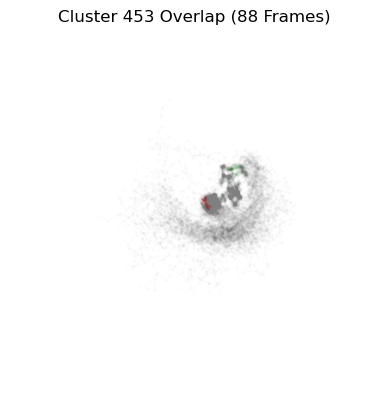

Aligning frames: 100%|█████████████████████████| 25/25 [00:00<00:00, 162.45it/s]


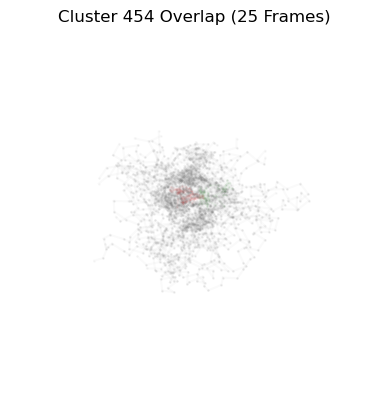

Aligning frames: 100%|█████████████████████████| 60/60 [00:00<00:00, 183.26it/s]


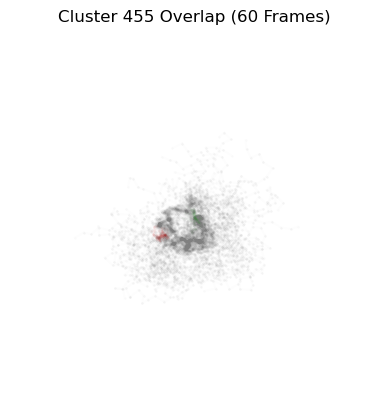

Aligning frames: 100%|█████████████████████████| 41/41 [00:00<00:00, 155.59it/s]


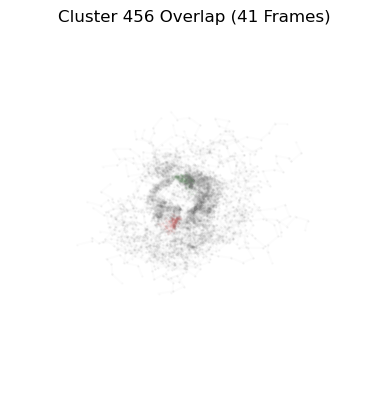

Aligning frames: 100%|█████████████████████████| 38/38 [00:00<00:00, 186.80it/s]


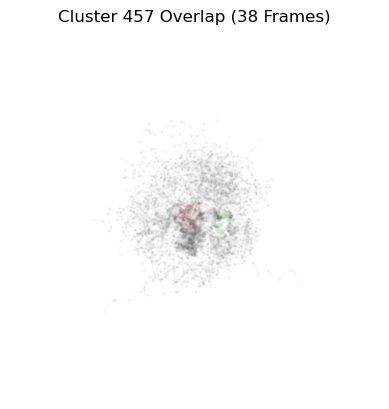

Aligning frames: 100%|█████████████████████████| 22/22 [00:00<00:00, 161.01it/s]


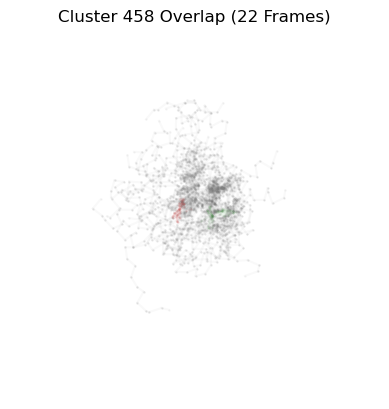

Aligning frames: 100%|██████████████████████████| 44/44 [00:00<00:00, 99.05it/s]


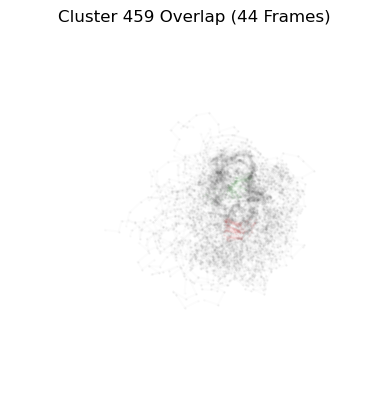

Aligning frames: 100%|█████████████████████████| 36/36 [00:00<00:00, 183.42it/s]


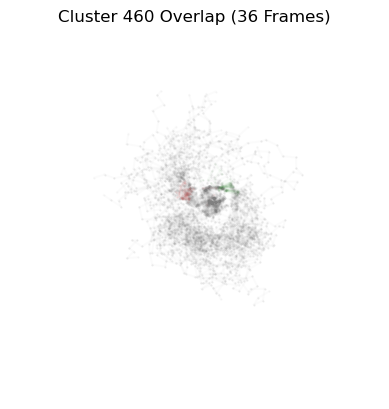

Aligning frames: 100%|█████████████████████████| 40/40 [00:00<00:00, 179.70it/s]


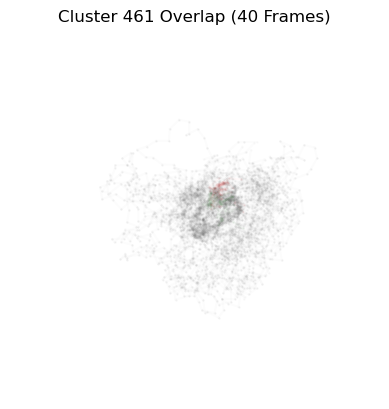

Aligning frames: 100%|█████████████████████████| 22/22 [00:00<00:00, 165.77it/s]


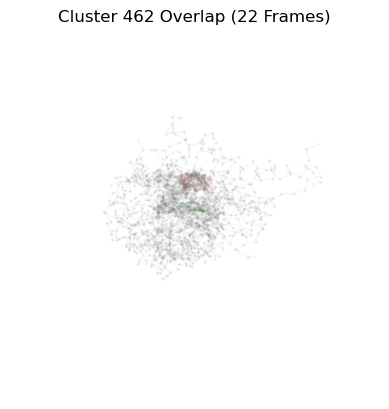

Aligning frames: 100%|███████████████████████| 171/171 [00:01<00:00, 156.55it/s]


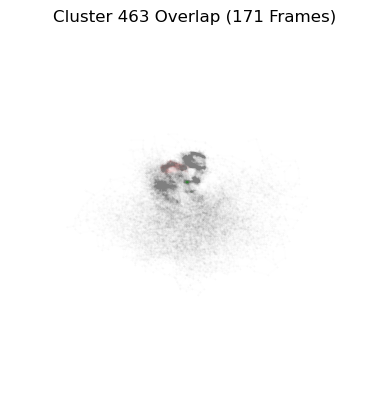

Aligning frames: 100%|██████████████████████████| 50/50 [00:01<00:00, 38.38it/s]


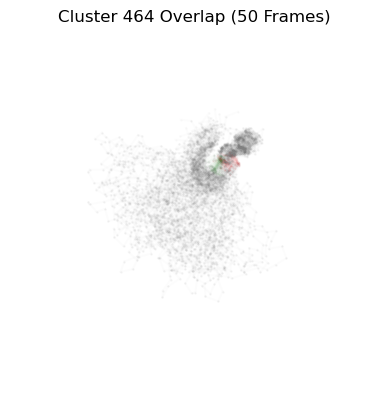

Aligning frames: 100%|██████████████████████████| 49/49 [00:00<00:00, 76.29it/s]


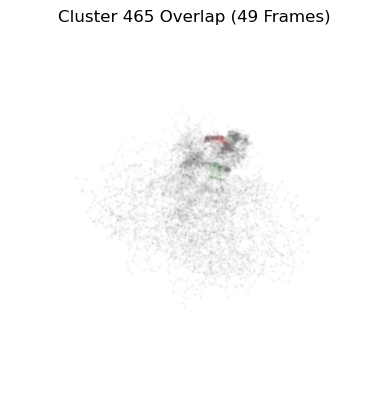

Aligning frames: 100%|█████████████████████████| 42/42 [00:00<00:00, 171.84it/s]


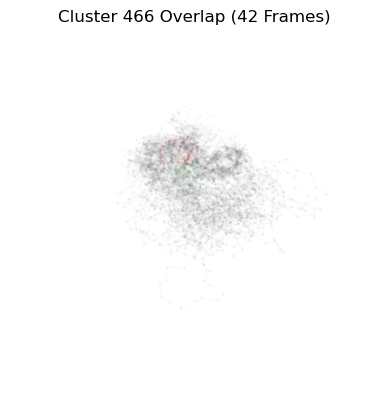

Aligning frames: 100%|███████████████████████| 131/131 [00:00<00:00, 193.64it/s]


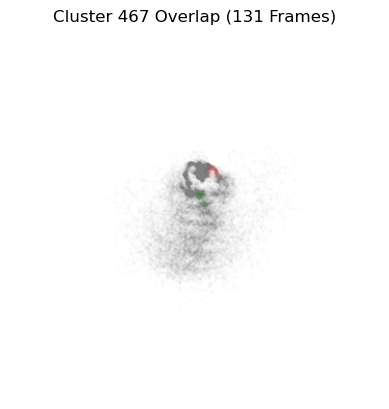

Aligning frames: 100%|██████████████████████████| 41/41 [00:01<00:00, 40.76it/s]


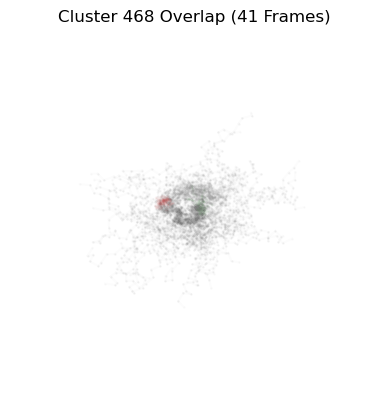

Aligning frames: 100%|█████████████████████████| 42/42 [00:00<00:00, 149.83it/s]


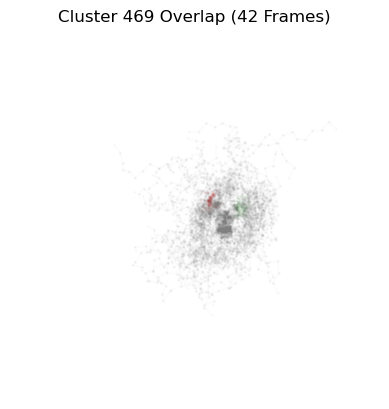

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 146.40it/s]


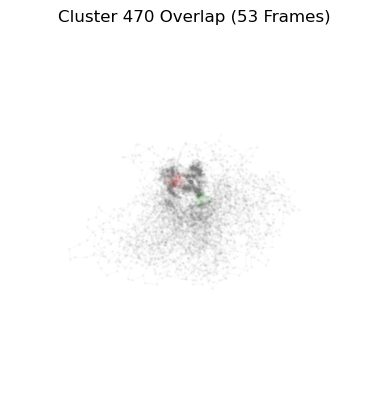

Aligning frames: 100%|█████████████████████████| 68/68 [00:00<00:00, 108.54it/s]


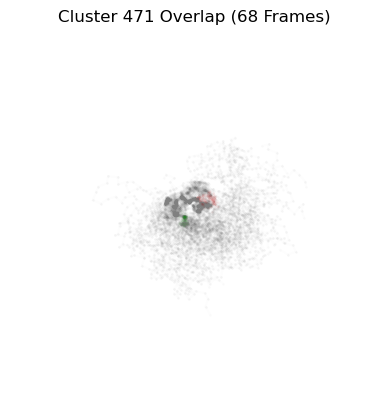

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 177.41it/s]


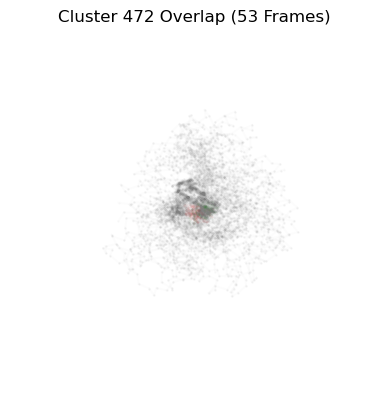

Aligning frames: 100%|█████████████████████████| 50/50 [00:00<00:00, 181.81it/s]


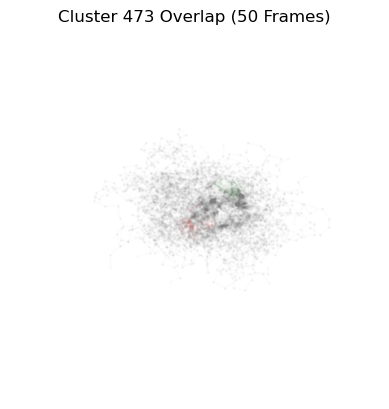

Aligning frames: 100%|█████████████████████████| 35/35 [00:00<00:00, 168.47it/s]


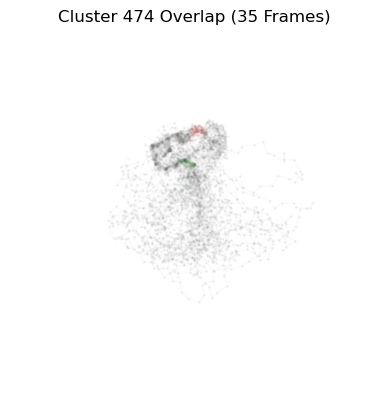

Aligning frames: 100%|█████████████████████████| 96/96 [00:00<00:00, 192.01it/s]


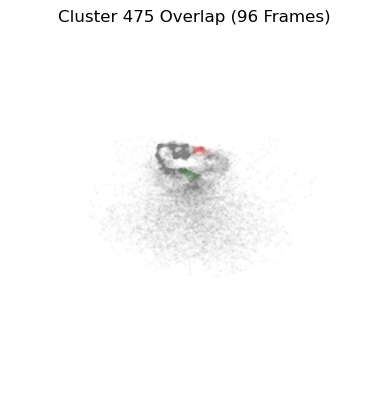

Aligning frames: 100%|█████████████████████████| 85/85 [00:00<00:00, 187.52it/s]


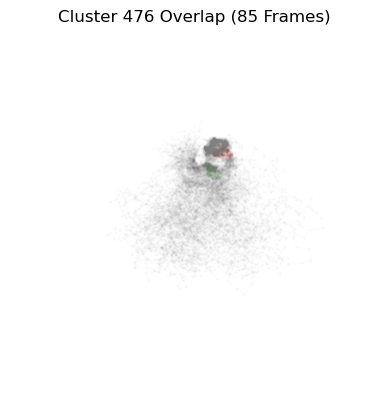

Aligning frames: 100%|█████████████████████████| 62/62 [00:00<00:00, 179.22it/s]


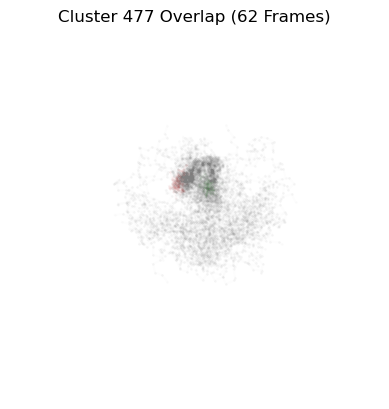

Aligning frames: 100%|███████████████████████| 118/118 [00:01<00:00, 112.36it/s]


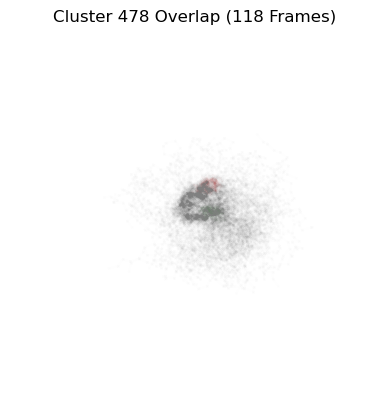

Aligning frames: 100%|██████████████████████████| 55/55 [00:01<00:00, 49.61it/s]


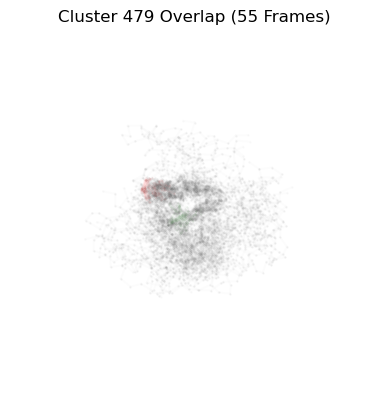

Aligning frames: 100%|██████████████████████████| 69/69 [00:00<00:00, 90.28it/s]


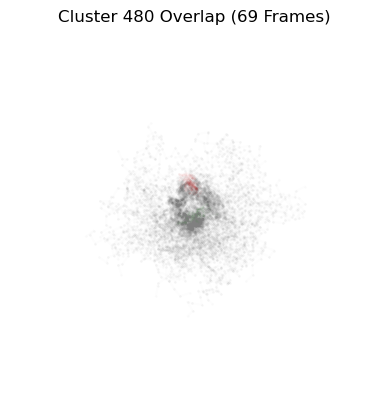

Aligning frames: 100%|█████████████████████████| 86/86 [00:00<00:00, 189.94it/s]


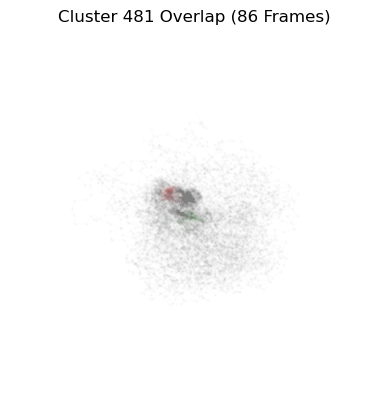

Aligning frames: 100%|███████████████████████| 115/115 [00:00<00:00, 186.77it/s]


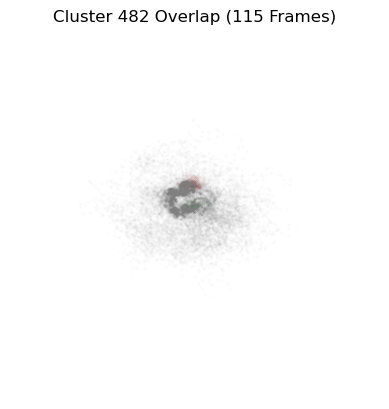

Aligning frames: 100%|██████████████████████████| 46/46 [00:00<00:00, 48.42it/s]


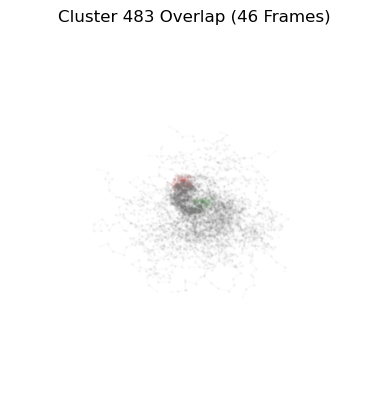

Aligning frames: 100%|█████████████████████████| 74/74 [00:00<00:00, 167.28it/s]


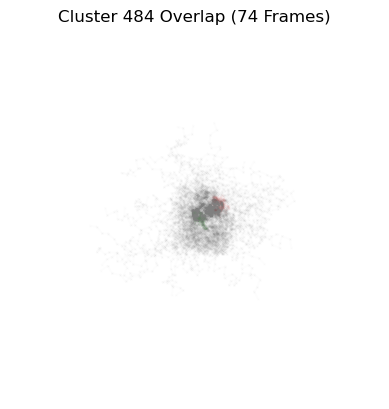

Aligning frames: 100%|██████████████████████████| 52/52 [00:00<00:00, 68.33it/s]


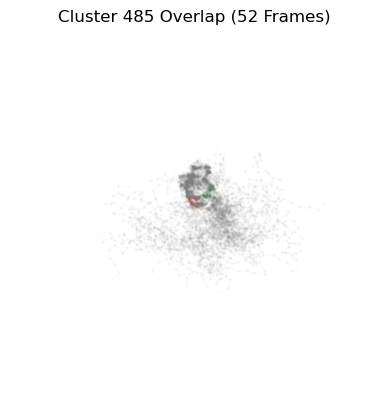

Aligning frames: 100%|█████████████████████████| 68/68 [00:00<00:00, 183.35it/s]


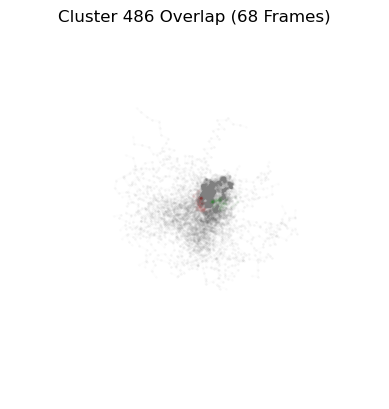

Aligning frames: 100%|█████████████████████████| 51/51 [00:00<00:00, 199.13it/s]


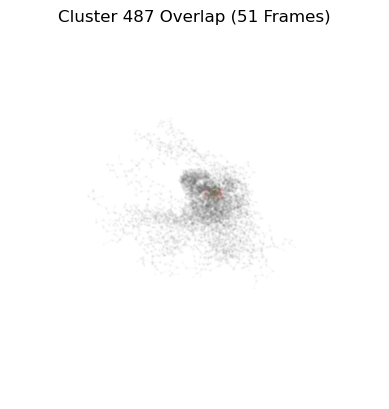

Aligning frames: 100%|█████████████████████████| 57/57 [00:00<00:00, 184.21it/s]


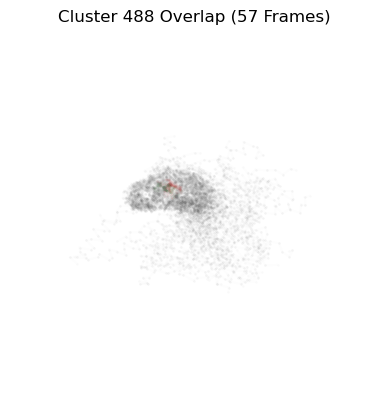

Aligning frames: 100%|█████████████████████████| 76/76 [00:00<00:00, 193.02it/s]


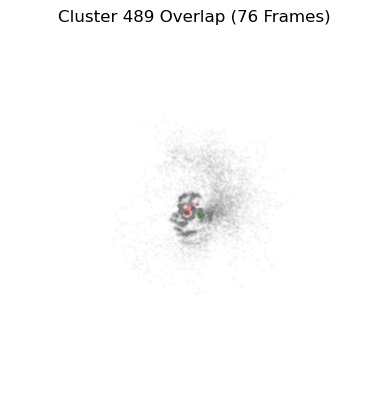

Aligning frames: 100%|█████████████████████████| 91/91 [00:00<00:00, 185.73it/s]


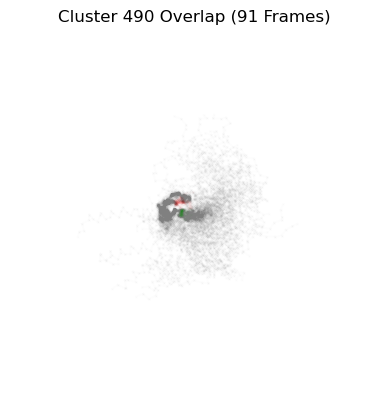

Aligning frames: 100%|█████████████████████████| 85/85 [00:00<00:00, 182.78it/s]


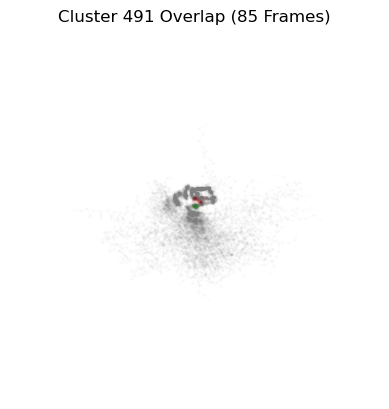

Aligning frames: 100%|█████████████████████████| 49/49 [00:00<00:00, 182.72it/s]


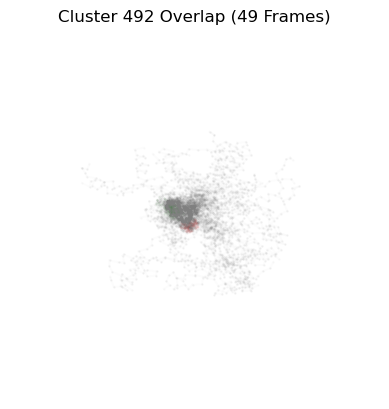

Aligning frames: 100%|███████████████████████| 111/111 [00:00<00:00, 121.86it/s]


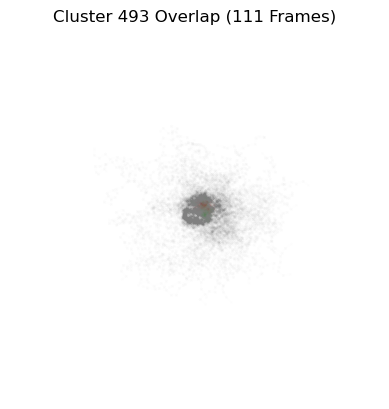

Aligning frames: 100%|████████████████████████| 105/105 [00:01<00:00, 85.66it/s]


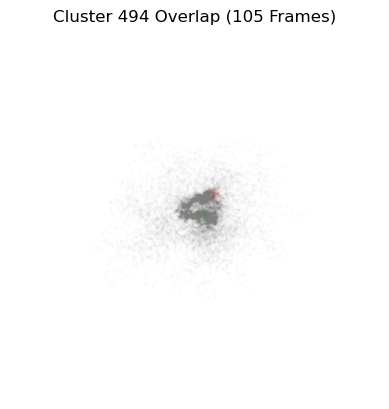

Aligning frames: 100%|█████████████████████████| 84/84 [00:00<00:00, 180.65it/s]


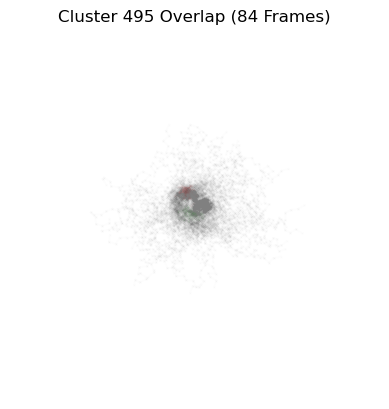

Aligning frames: 100%|█████████████████████████| 88/88 [00:00<00:00, 176.19it/s]


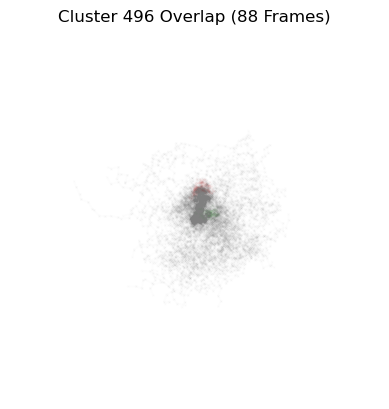

Aligning frames: 100%|█████████████████████████| 15/15 [00:00<00:00, 150.34it/s]


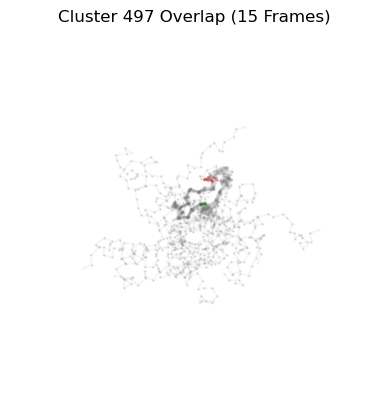

Aligning frames: 100%|█████████████████████████| 85/85 [00:00<00:00, 166.06it/s]


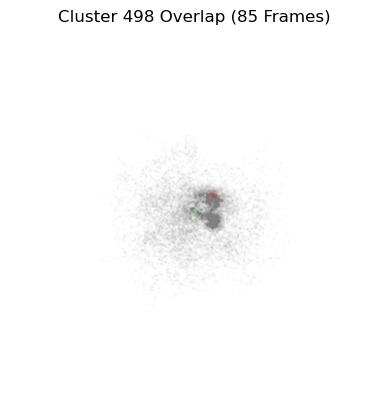

Aligning frames: 100%|█████████████████████████| 59/59 [00:00<00:00, 179.08it/s]


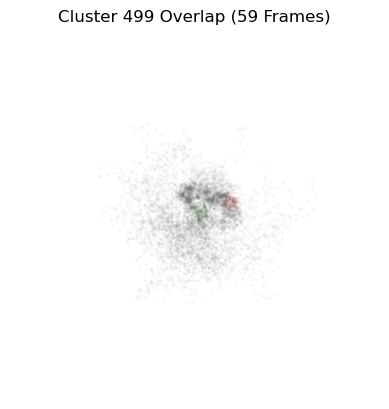

Aligning frames: 100%|█████████████████████████| 53/53 [00:00<00:00, 172.01it/s]


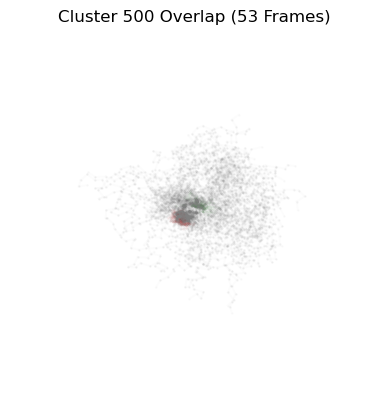

In [18]:
# Define the function to extract frames from both universes
def extract_frames(indices, universe1, universe2, switch_index=40000):
    frames = []
    for idx in tqdm(indices, desc="Extracting frames"):
        if idx < switch_index:
            universe1.trajectory[idx]
            frames.append(universe1.select_atoms("name CA").positions.copy())
        else:
            universe2.trajectory[idx - switch_index]
            frames.append(universe2.select_atoms("name CA").positions.copy())
    return frames

# Create a temporary Universe for alignment
def create_temp_universe(positions, universe):
    temp_universe = mda.Merge(universe.select_atoms("name CA"))
    temp_universe.atoms.positions = positions
    return temp_universe

# Align frames using AlignTraj
def align_frames(reference_universe, frames, select_for_alignment):
    aligned_frames = []
    for frame_positions in tqdm(frames, desc="Aligning frames"):
        temp_universe = create_temp_universe(frame_positions, reference_universe)
        aligner = align.AlignTraj(temp_universe, reference_universe, select=select_for_alignment, in_memory=True)
        aligner.run()
        aligned_frames.append(temp_universe.atoms.positions.copy())
    return aligned_frames

# Selection string for residues 15-30 to ensure alignment of corresponding residues
select_residues_15_30 = "resid 15-30 and name CA"

# Function to plot aligned frames for a given cluster
def plot_aligned_frames(cluster_id, indices):
    # Extract frames for the cluster
    frames = extract_frames(indices, u1, u2)
    
    # Create reference universe for alignment
    reference_universe = create_temp_universe(frames[0], u1)
    
    # Align frames using the specific residues 15-30
    aligned_frames = align_frames(reference_universe, frames, select_residues_15_30)
    
    # Set the opacity value with a minimum threshold
    opacity = max(1 / len(aligned_frames), 0.002)
    
    # Plot the aligned frames from different angles
    angles = [(30, 30)]
    
    for angle in angles:
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        
        # Plot cluster frames with lines connecting the alpha carbons
        for positions in aligned_frames:
            for i in range(len(positions) - 1):
                if i == 14:
                    color = 'red'  # alpha carbon 15
                elif i == 29:
                    color = 'green'  # alpha carbon 30
                else:
                    color = 'grey'
                ax.plot(positions[i:i+2, 0], positions[i:i+2, 1], positions[i:i+2, 2], 
                        'o-', color=color, markersize=1, markeredgewidth=0.8, alpha=opacity)
        
        ax.view_init(elev=angle[0], azim=angle[1])
        ax.set_axis_off()  # Remove axes
        ax.grid(False)     # Remove grid lines
        plt.title(f'Cluster {cluster_id} Overlap ({len(aligned_frames)} Frames)')
        plt.show()

# Group the DataFrame by 'cluster' and get the indices for each cluster
cluster_indices = latent.groupby('cluster').apply(lambda df: df.index.tolist()).to_dict()

# Plot aligned frames for each cluster
for cluster_id, indices in cluster_indices.items():
    plot_aligned_frames(cluster_id, indices)

In [ ]:
# Define the function to extract frames from both universes
def extract_frames(indices, universe1, universe2, switch_index=40000):
    frames = []
    for idx in tqdm(indices, desc="Extracting frames"):
        if idx < switch_index:
            universe1.trajectory[idx]
            frames.append(universe1.select_atoms("name CA").positions.copy())
        else:
            universe2.trajectory[idx - switch_index]
            frames.append(universe2.select_atoms("name CA").positions.copy())
    return frames

# Create a temporary Universe for alignment
def create_temp_universe(positions, universe):
    temp_universe = mda.Merge(universe.select_atoms("name CA"))
    temp_universe.atoms.positions = positions
    return temp_universe

# Align frames using AlignTraj
def align_frames(reference_universe, frames, select_for_alignment):
    aligned_frames = []
    for frame_positions in tqdm(frames, desc="Aligning frames"):
        temp_universe = create_temp_universe(frame_positions, reference_universe)
        aligner = align.AlignTraj(temp_universe, reference_universe, select=select_for_alignment, in_memory=True)
        aligner.run()
        aligned_frames.append(temp_universe.atoms.positions.copy())
    return aligned_frames

# Selection string for residues 15-30 to ensure alignment of corresponding residues
select_residues_15_30 = "resid 15-30 and name CA"

# Function to plot aligned frames for a given cluster
def plot_aligned_frames(cluster_id, indices):
    # Extract frames for the cluster
    frames = extract_frames(indices, u1, u2)
    
    # Create reference universe for alignment
    reference_universe = create_temp_universe(frames[0], u1)
    
    # Align frames using the specific residues 15-30
    aligned_frames = align_frames(reference_universe, frames, select_residues_15_30)
    
    # Set the opacity value with a minimum threshold
    opacity = max(1 / len(aligned_frames), 0.002)
    
    # Plot the aligned frames from different angles
    angles = [(30, 30)]
    
    for angle in angles:
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        
        # Plot cluster frames with lines connecting the alpha carbons
        for positions in aligned_frames:
            for i in range(len(positions) - 1):
                if i == 14:
                    color = 'blue'  # alpha carbon 15
                elif i == 29:
                    color = 'green'  # alpha carbon 30
                else:
                    color = 'red'
                ax.plot(positions[i:i+2, 0], positions[i:i+2, 1], positions[i:i+2, 2], 
                        'o-', color=color, markersize=1, markeredgewidth=0.8, alpha=opacity)
        
        ax.view_init(elev=angle[0], azim=angle[1])
        ax.set_axis_off()  # Remove axes
        ax.grid(False)     # Remove grid lines
        plt.title(f'Cluster {cluster_id} Overlap ({len(aligned_frames)} Frames)')
        plt.show()

# Group the DataFrame by 'cluster' and get the indices for each cluster
cluster_indices = latent.groupby('cluster').apply(lambda df: df.index.tolist()).to_dict()

# Plot aligned frames for each cluster
for cluster_id, indices in cluster_indices.items():
    plot_aligned_frames(cluster_id, indices)

# Further Analysis
- Cluster Lifespan
- Transition Preference

In [ ]:
# Step 1: Sort the dataframe by index
latent_sorted = latent.sort_index()

# Step 2: Initialize variables
cluster_durations = []
current_cluster = None
current_duration = 0

# Step 3: Iterate through the sorted dataframe to count consecutive frames in each cluster
for idx, row in latent_sorted.iterrows():
    cluster = row['cluster']
    if cluster == current_cluster:
        current_duration += 1
    else:
        if current_cluster is not None:
            cluster_durations.append((current_cluster, current_duration))
        current_cluster = cluster
        current_duration = 1

# Append the last cluster duration
if current_cluster is not None:
    cluster_durations.append((current_cluster, current_duration))

# Convert the list of durations to a dataframe for easier analysis
durations_df = pd.DataFrame(cluster_durations, columns=['Cluster', 'Duration'])

# Display the dataframe
print(durations_df)